<a href="https://colab.research.google.com/github/kamdzie2/CreditRisk_Prediction/blob/main/Credit_risk.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files

In [ ]:
!pip install -U scikit-fuzzy

In [ ]:
import skfuzzy as fuzz
from skfuzzy import control as ctrl

In [ ]:
uploaded = files.upload()

Saving danekoncowe.csv to danekoncowe.csv


In [ ]:
file_name = list(uploaded.keys())[0]
data = pd.read_csv(file_name, sep=';')
filtered_data = data[data['Saving accounts'] != "unknown"]

# Mapowanie wartości w kolumnie 'Saving accounts' na wartości liczbowe
def map_savings_category(category):
    if category == 'little':
        return 30  # Przypisanie wartości odpowiadającej 'low'
    elif category == 'moderate':
        return 50  # Przypisanie wartości odpowiadającej 'moderate'
    elif category in ['quite rich', 'rich']:
        return 90  # Przypisanie wartości odpowiadającej 'high'
    else:
        return np.nan  # Brak wartości

filtered_data['Saving accounts'] = filtered_data['Saving accounts'].apply(map_savings_category)

# Usunięcie wierszy z brakującymi wartościami (NaN) i wartością 0 w przefiltrowanych kolumnach
filtered_data = filtered_data.dropna()
filtered_data = filtered_data[(filtered_data != 0).all(axis=1)]

print(filtered_data.head())
print(filtered_data.info())

   Age  Saving accounts  Credit amount  Duration
1   22             30.0           5951        48
2   49             30.0           2096        12
3   45             30.0           7882        42
4   53             30.0           4870        24
6   53             90.0           2835        24
<class 'pandas.core.frame.DataFrame'>
Index: 79 entries, 1 to 98
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Age              79 non-null     int64  
 1   Saving accounts  79 non-null     float64
 2   Credit amount    79 non-null     int64  
 3   Duration         79 non-null     int64  
dtypes: float64(1), int64(3)
memory usage: 3.1 KB
None


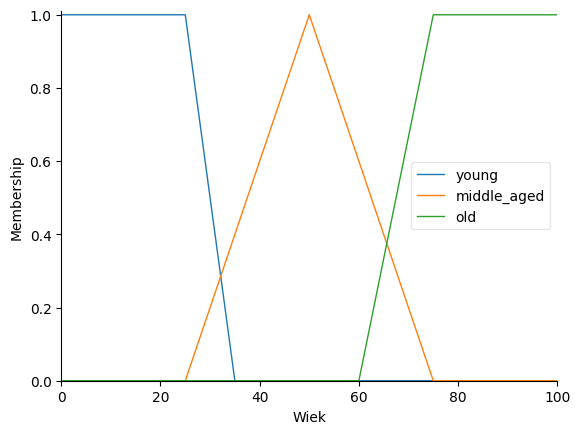

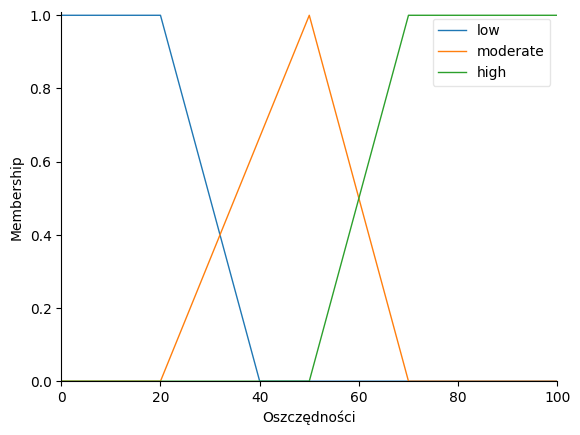

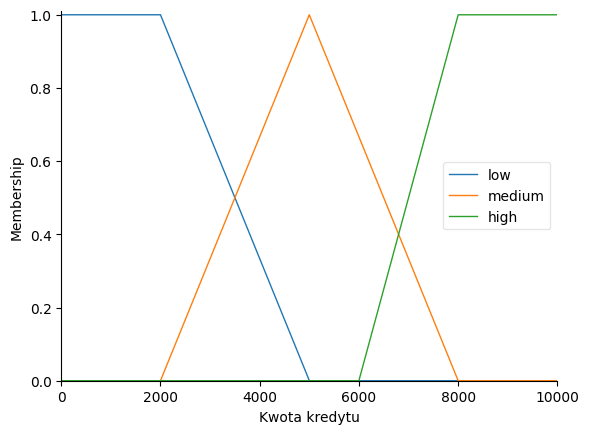

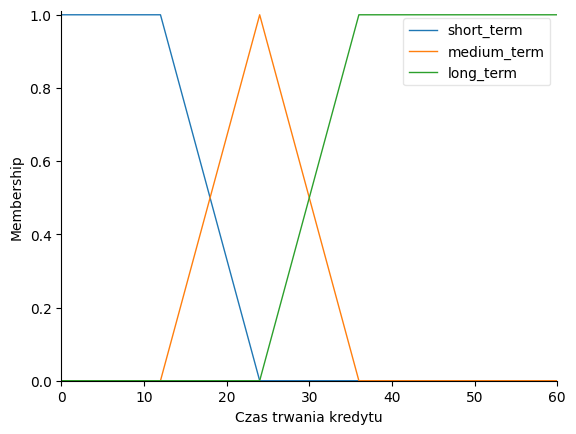

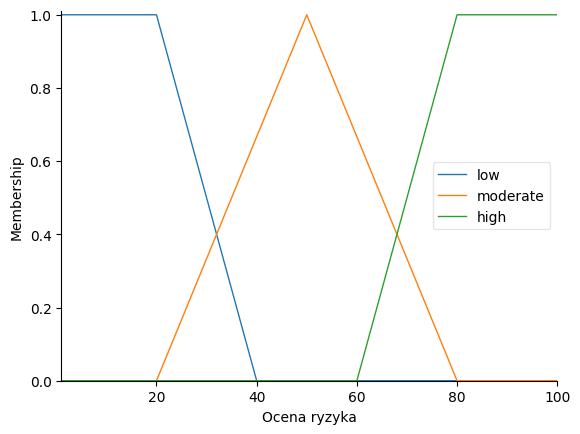

In [ ]:
#Wiek
age = ctrl.Antecedent(np.arange(0, 101, 1), 'Wiek')
age['young'] = fuzz.trapmf(age.universe, [0, 0, 25, 35])
age['middle_aged'] = fuzz.trimf(age.universe, [25, 50, 75])
age['old'] = fuzz.trapmf(age.universe, [60, 75, 100, 100])

# Oszczędności
savings = ctrl.Antecedent(np.arange(0, 101, 1), 'Oszczędności')
savings['low'] = fuzz.trapmf(savings.universe, [0, 0, 20, 40])
savings['moderate'] = fuzz.trimf(savings.universe, [20, 50, 70])
savings['high'] = fuzz.trapmf(savings.universe, [50, 70, 100, 100])  # Łączenie 'quite rich' i 'rich'


# Kwota kredytu (Credit Amount)
credit_amount = ctrl.Antecedent(np.arange(0, 10001, 1), 'Kwota kredytu')
credit_amount['low'] = fuzz.trapmf(credit_amount.universe, [0, 0, 2000, 5000])
credit_amount['medium'] = fuzz.trimf(credit_amount.universe, [2000, 5000, 8000])
credit_amount['high'] = fuzz.trapmf(credit_amount.universe, [6000, 8000, 10000, 10000])

# Czas trwania kredytu (Duration)
duration = ctrl.Antecedent(np.arange(0, 61, 1), 'Czas trwania kredytu')
duration['short_term'] = fuzz.trapmf(duration.universe, [0, 0, 12, 24])
duration['medium_term'] = fuzz.trimf(duration.universe, [12, 24, 36])
duration['long_term'] = fuzz.trapmf(duration.universe, [24, 36, 60, 60])

# Ocena ryzyka kredytowego (Risk Assessment)
risk = ctrl.Consequent(np.arange(1, 101, 1), 'Ocena ryzyka', defuzzify_method='centroid')
risk['low'] = fuzz.trapmf(risk.universe, [1, 1, 20, 40])
risk['moderate'] = fuzz.trimf(risk.universe, [20, 50, 80])
risk['high'] = fuzz.trapmf(risk.universe, [60, 80, 100, 100])

age.view()
savings.view()
credit_amount.view()
duration.view()
risk.view()

In [ ]:
import pandas as pd

def generate_all_fuzzy_tables(fuzzy_variables):
    tables = {}

    for variable_name, fuzzy_sets in fuzzy_variables.items():
        data = []
        for set_name, (func_type, params) in fuzzy_sets.items():
            row = {
                "Nazwa zbioru": set_name,
                "Typ funkcji": func_type,
                "Parametry przecięcia": f"a={params[0]}, b={params[1]}, c={params[2]}, d={params[3]}",
            }
            data.append(row)
        tables[variable_name] = pd.DataFrame(data)

    return tables

# Definicja zmiennych lingwistycznych i ich zbiorów
fuzzy_variables = {
    "Wiek": {
        "young": ("trapmf", (0, 0, 25, 35)),
        "middle_aged": ("trimf", (25, 50, 75, None)),
        "old": ("trapmf", (60, 75, 100, 100))
    },
    "Oszczędności": {
        "low": ("trapmf", (0, 0, 20, 40)),
        "moderate": ("trimf", (20, 50, 70, None)),
        "high": ("trapmf", (50, 70, 100, 100))
    },
    "Kwota kredytu": {
        "low": ("trapmf", (0, 0, 2000, 5000)),
        "medium": ("trimf", (2000, 5000, 8000, None)),
        "high": ("trapmf", (6000, 8000, 10000, 10000))
    },
    "Czas trwania kredytu": {
        "short_term": ("trapmf", (0, 0, 12, 24)),
        "medium_term": ("trimf", (12, 24, 36, None)),
        "long_term": ("trapmf", (24, 36, 60, 60))
    },
    "Ocena ryzyka": {
        "low": ("trapmf", (1, 1, 20, 40)),
        "moderate": ("trimf", (20, 50, 80, None)),
        "high": ("trapmf", (60, 80, 100, 100))
    }
}

fuzzy_tables = generate_all_fuzzy_tables(fuzzy_variables)

for variable, table in fuzzy_tables.items():
    print(f"\nTabela dla zmiennej: {variable}")
    print(table)



Tabela dla zmiennej: Wiek
  Nazwa zbioru Typ funkcji      Parametry przecięcia
0        young      trapmf      a=0, b=0, c=25, d=35
1  middle_aged       trimf  a=25, b=50, c=75, d=None
2          old      trapmf  a=60, b=75, c=100, d=100

Tabela dla zmiennej: Oszczędności
  Nazwa zbioru Typ funkcji      Parametry przecięcia
0          low      trapmf      a=0, b=0, c=20, d=40
1     moderate       trimf  a=20, b=50, c=70, d=None
2         high      trapmf  a=50, b=70, c=100, d=100

Tabela dla zmiennej: Kwota kredytu
  Nazwa zbioru Typ funkcji              Parametry przecięcia
0          low      trapmf          a=0, b=0, c=2000, d=5000
1       medium       trimf    a=2000, b=5000, c=8000, d=None
2         high      trapmf  a=6000, b=8000, c=10000, d=10000

Tabela dla zmiennej: Czas trwania kredytu
  Nazwa zbioru Typ funkcji      Parametry przecięcia
0   short_term      trapmf      a=0, b=0, c=12, d=24
1  medium_term       trimf  a=12, b=24, c=36, d=None
2    long_term      trapmf    a=

In [ ]:
# Definiowanie poziomów zmiennych lingwistycznych
age_levels = ['young', 'middle_aged', 'old']
savings_levels = ['low', 'moderate', 'high']
credit_amount_levels = ['low', 'medium', 'high']
duration_levels = ['short_term', 'medium_term', 'long_term']

rules = []

for age_level in age_levels:
    for savings_level in savings_levels:
        for credit_amount_level in credit_amount_levels:
            for duration_level in duration_levels:
                if age_level == 'young' and savings_level == 'low' and credit_amount_level == 'high':
                    risk_level = 'high'
                elif credit_amount_level == 'low' and duration_level == 'short_term':
                    risk_level = 'low'
                else:
                    risk_level = 'moderate'

                rule = ctrl.Rule(
                    age[age_level] & savings[savings_level] & credit_amount[credit_amount_level] & duration[duration_level],
                    risk[risk_level]
                )
                rules.append(rule)

print(f"Liczba wygenerowanych reguł: {len(rules)}")

for i, rule in enumerate(rules[:81], start=1):
    print(f"Reguła {i}: {rule}")


Liczba wygenerowanych reguł: 81
Reguła 1: IF ((Wiek[young] AND Oszczędności[low]) AND Kwota kredytu[low]) AND Czas trwania kredytu[short_term] THEN Ocena ryzyka[low]
	AND aggregation function : fmin
	OR aggregation function  : fmax
Reguła 2: IF ((Wiek[young] AND Oszczędności[low]) AND Kwota kredytu[low]) AND Czas trwania kredytu[medium_term] THEN Ocena ryzyka[moderate]
	AND aggregation function : fmin
	OR aggregation function  : fmax
Reguła 3: IF ((Wiek[young] AND Oszczędności[low]) AND Kwota kredytu[low]) AND Czas trwania kredytu[long_term] THEN Ocena ryzyka[moderate]
	AND aggregation function : fmin
	OR aggregation function  : fmax
Reguła 4: IF ((Wiek[young] AND Oszczędności[low]) AND Kwota kredytu[medium]) AND Czas trwania kredytu[short_term] THEN Ocena ryzyka[moderate]
	AND aggregation function : fmin
	OR aggregation function  : fmax
Reguła 5: IF ((Wiek[young] AND Oszczędności[low]) AND Kwota kredytu[medium]) AND Czas trwania kredytu[medium_term] THEN Ocena ryzyka[moderate]
	AND ag

In [ ]:
credit_risk_ctrl = ctrl.ControlSystem(rules)
credit_risk_simulation = ctrl.ControlSystemSimulation(credit_risk_ctrl)

In [ ]:
credit_risk_simulation.input['Wiek'] = 30
credit_risk_simulation.input['Oszczędności'] = 50
credit_risk_simulation.input['Kwota kredytu'] = 4000
credit_risk_simulation.input['Czas trwania kredytu'] = 24

credit_risk_simulation.compute()

Wartości wejściowe:
Wiek: 22.0
Oszczędności: 30.0
Kwota kredytu: 5951.0
Czas trwania kredytu: 48.0
Wiersz 2:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (22.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (5951.0): low=0.00, medium=0.68, high=0.00
  Czas trwania kredytu (48.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

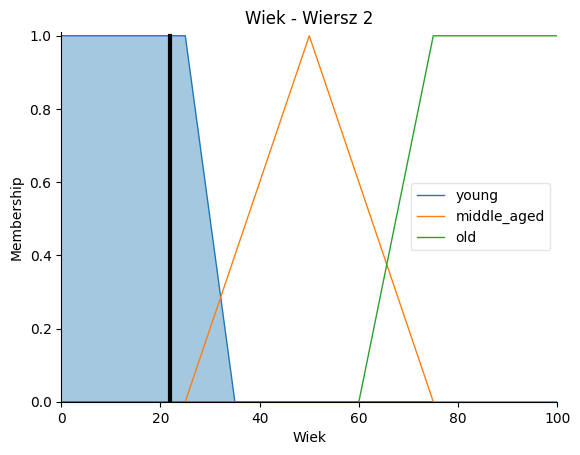

<Figure size 1000x600 with 0 Axes>

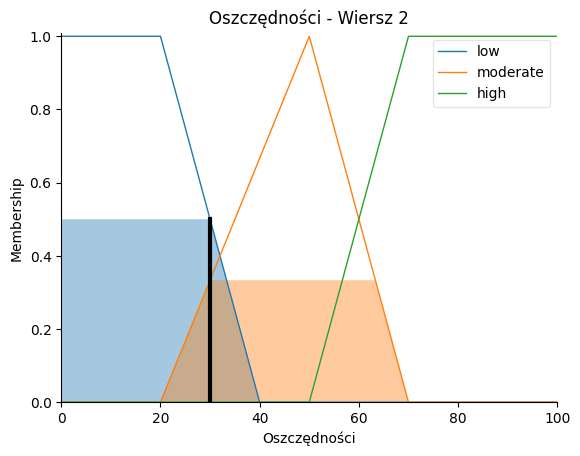

<Figure size 1000x600 with 0 Axes>

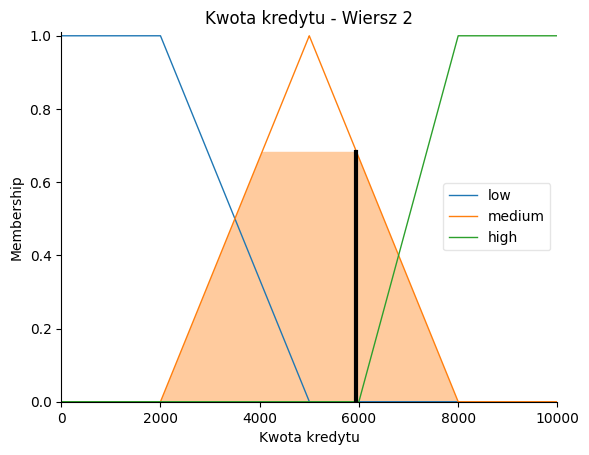

<Figure size 1000x600 with 0 Axes>

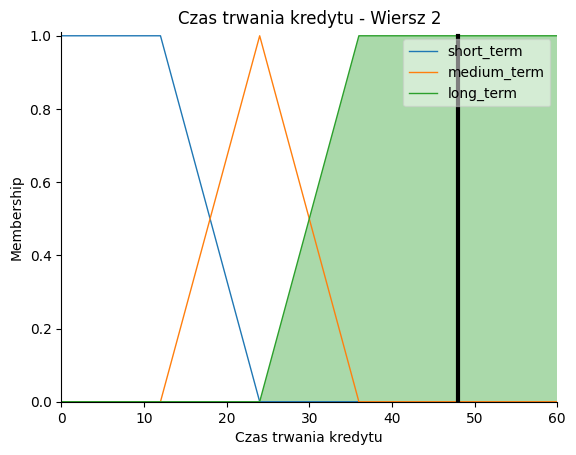

<Figure size 1000x600 with 0 Axes>

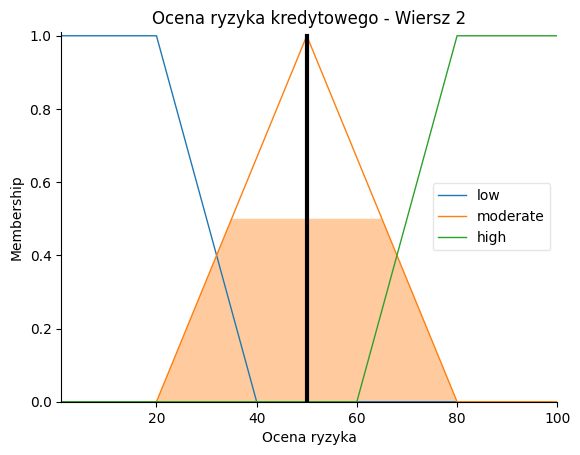

Wartości wejściowe:
Wiek: 49.0
Oszczędności: 30.0
Kwota kredytu: 2096.0
Czas trwania kredytu: 12.0
Wiersz 3:
Ocena ryzyka kredytowego = 21.02 [%]
  Przynależność (Membership):
  Wiek (49.0): young=0.00, middle_aged=0.96, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (2096.0): low=0.97, medium=0.03, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

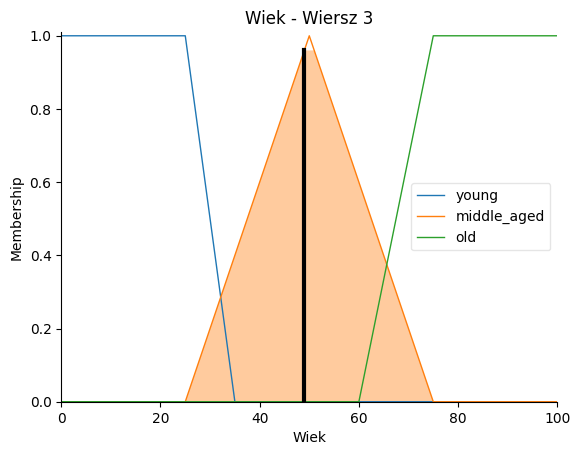

<Figure size 1000x600 with 0 Axes>

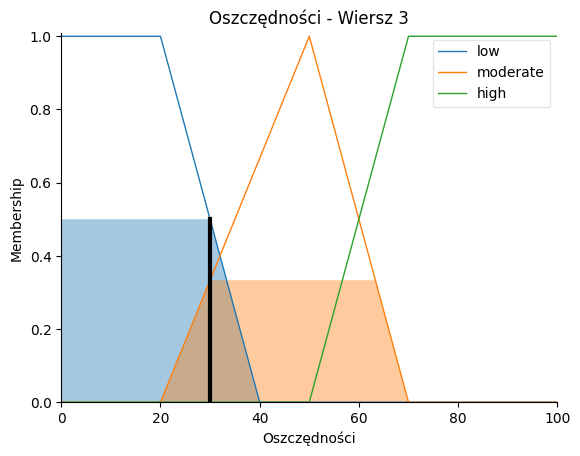

<Figure size 1000x600 with 0 Axes>

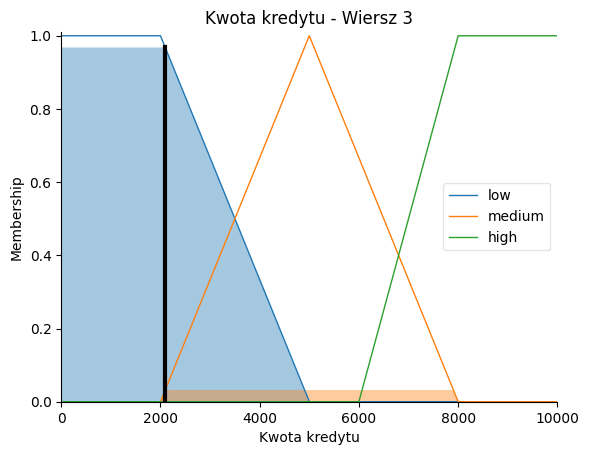

<Figure size 1000x600 with 0 Axes>

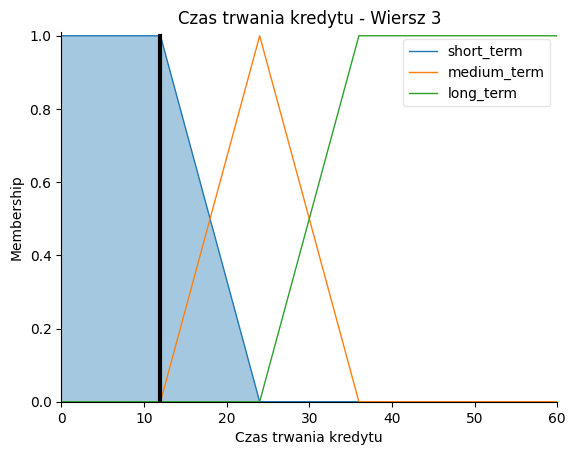

<Figure size 1000x600 with 0 Axes>

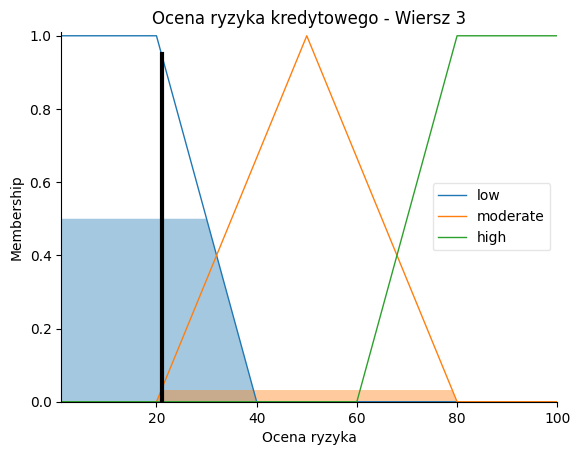

Wartości wejściowe:
Wiek: 45.0
Oszczędności: 30.0
Kwota kredytu: 7882.0
Czas trwania kredytu: 42.0
Wiersz 4:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (45.0): young=0.00, middle_aged=0.80, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (7882.0): low=0.00, medium=0.04, high=0.94
  Czas trwania kredytu (42.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

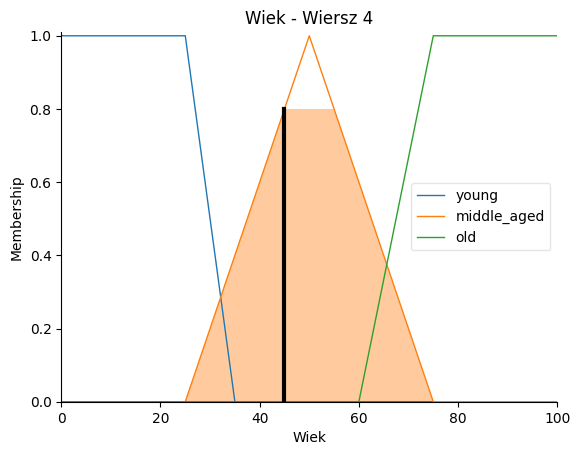

<Figure size 1000x600 with 0 Axes>

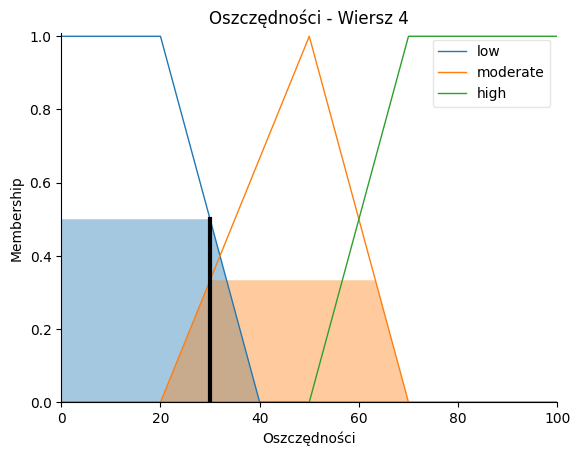

<Figure size 1000x600 with 0 Axes>

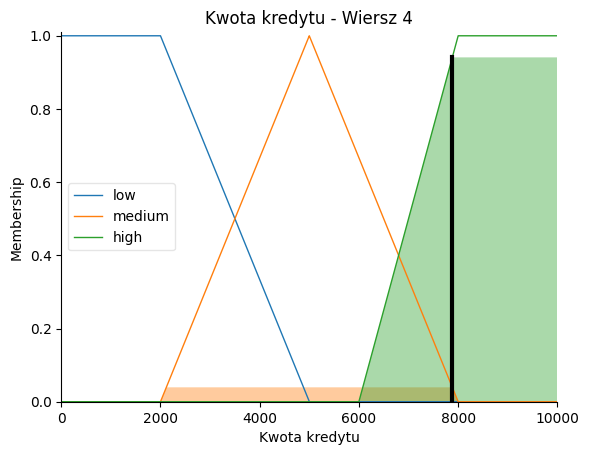

<Figure size 1000x600 with 0 Axes>

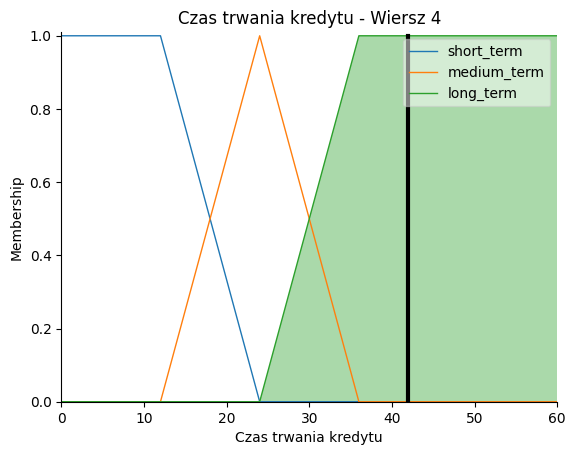

<Figure size 1000x600 with 0 Axes>

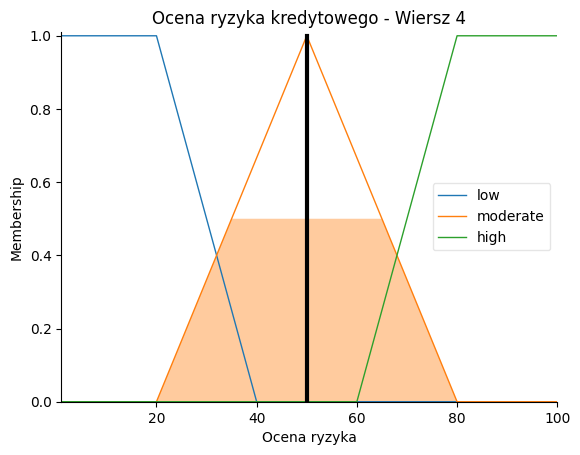

Wartości wejściowe:
Wiek: 53.0
Oszczędności: 30.0
Kwota kredytu: 4870.0
Czas trwania kredytu: 24.0
Wiersz 5:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (53.0): young=0.00, middle_aged=0.88, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (4870.0): low=0.04, medium=0.96, high=0.00
  Czas trwania kredytu (24.0): short=0.00, medium=1.00, long=0.00



<Figure size 1000x600 with 0 Axes>

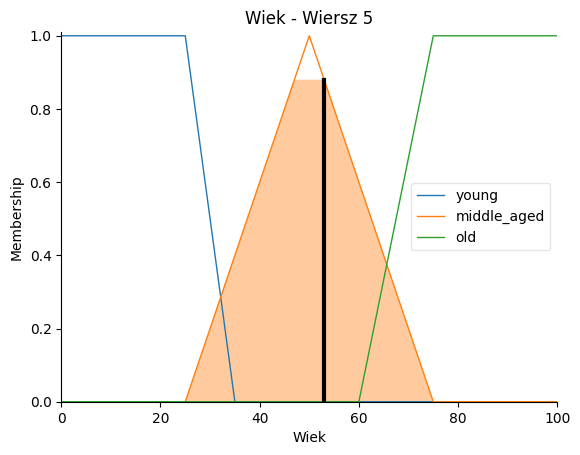

<Figure size 1000x600 with 0 Axes>

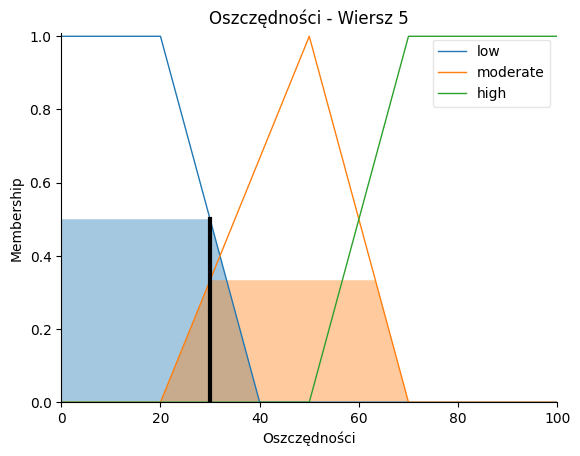

<Figure size 1000x600 with 0 Axes>

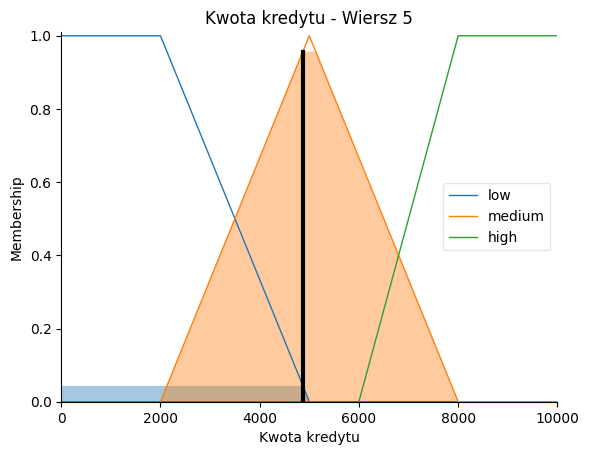

<Figure size 1000x600 with 0 Axes>

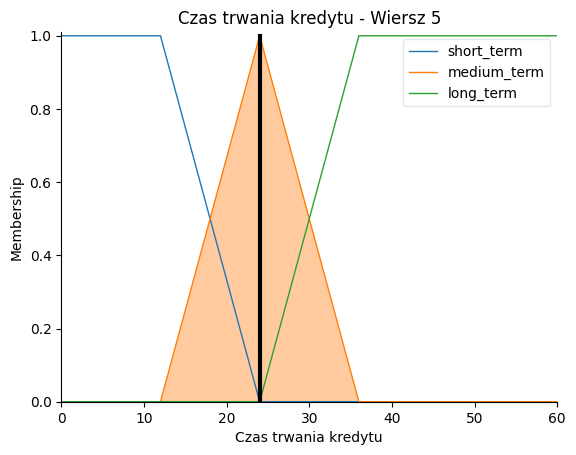

<Figure size 1000x600 with 0 Axes>

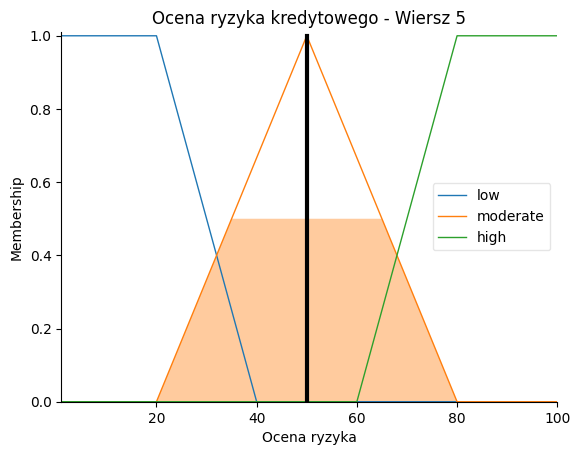

Wartości wejściowe:
Wiek: 53.0
Oszczędności: 90.0
Kwota kredytu: 2835.0
Czas trwania kredytu: 24.0
Wiersz 7:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (53.0): young=0.00, middle_aged=0.88, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (2835.0): low=0.72, medium=0.28, high=0.00
  Czas trwania kredytu (24.0): short=0.00, medium=1.00, long=0.00



<Figure size 1000x600 with 0 Axes>

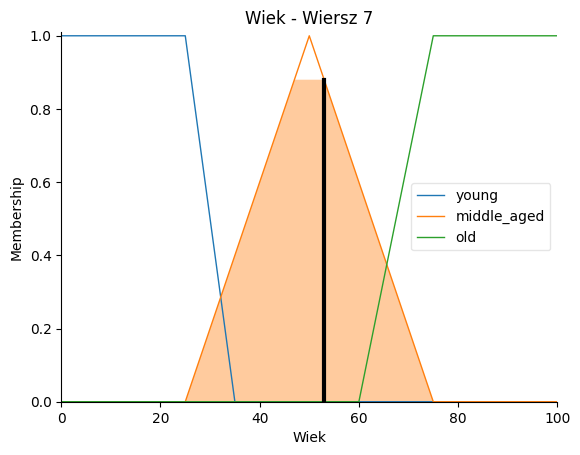

<Figure size 1000x600 with 0 Axes>

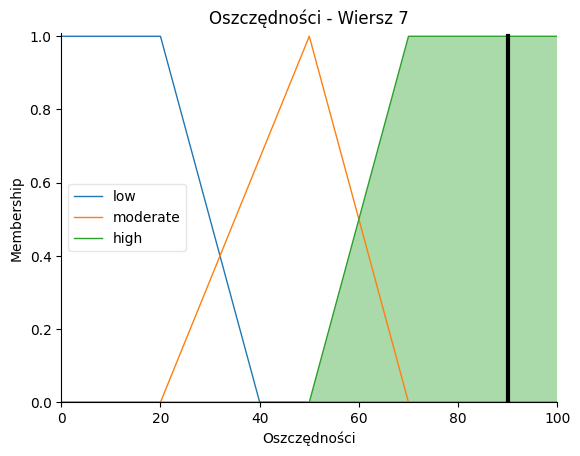

<Figure size 1000x600 with 0 Axes>

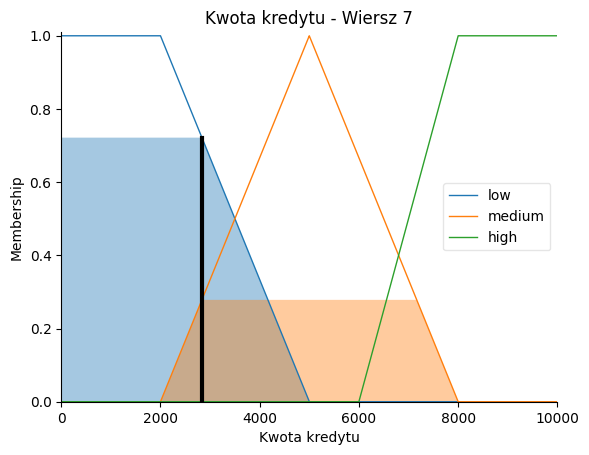

<Figure size 1000x600 with 0 Axes>

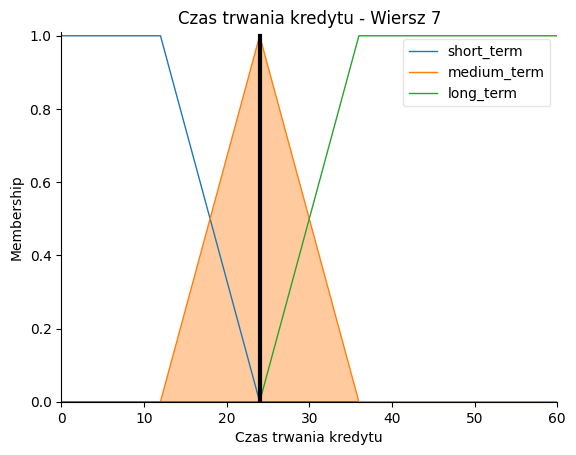

<Figure size 1000x600 with 0 Axes>

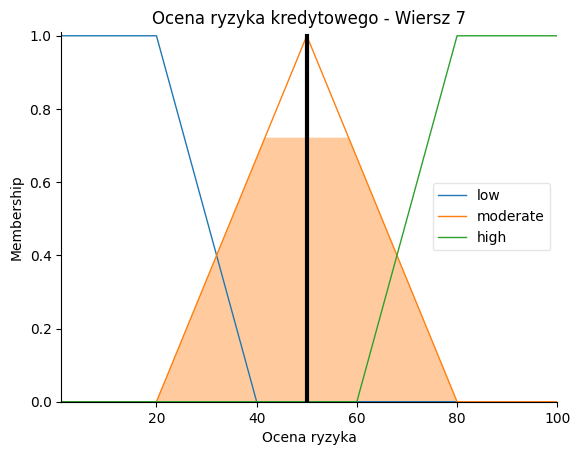

Wartości wejściowe:
Wiek: 35.0
Oszczędności: 30.0
Kwota kredytu: 6948.0
Czas trwania kredytu: 36.0
Wiersz 8:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (35.0): young=0.00, middle_aged=0.40, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (6948.0): low=0.00, medium=0.35, high=0.47
  Czas trwania kredytu (36.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

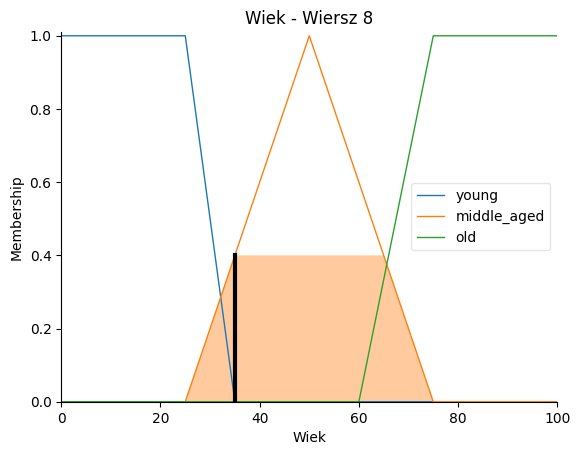

<Figure size 1000x600 with 0 Axes>

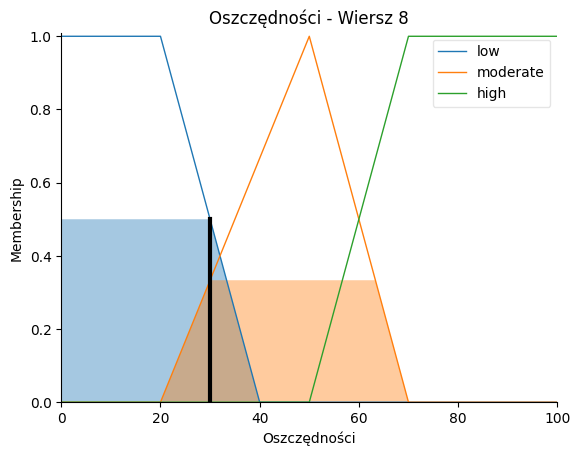

<Figure size 1000x600 with 0 Axes>

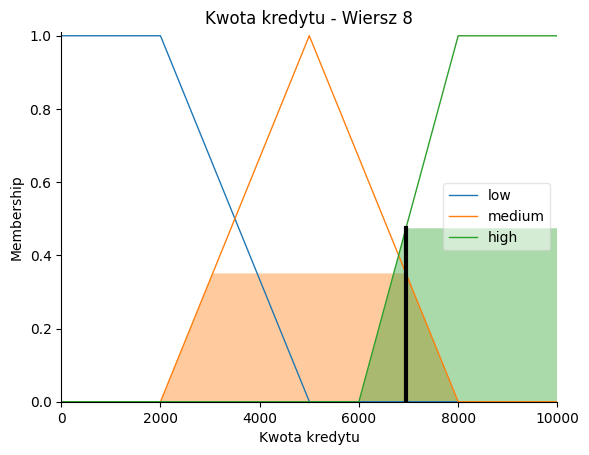

<Figure size 1000x600 with 0 Axes>

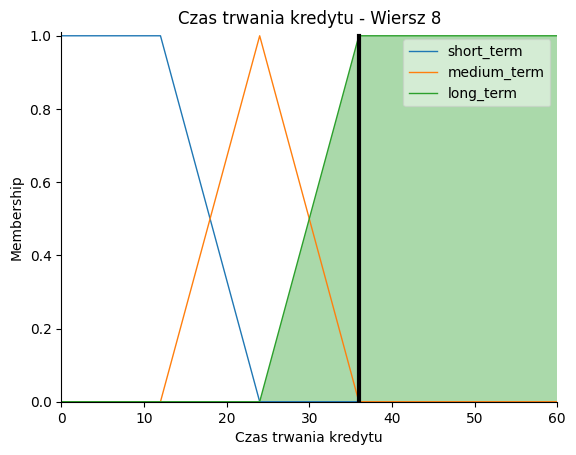

<Figure size 1000x600 with 0 Axes>

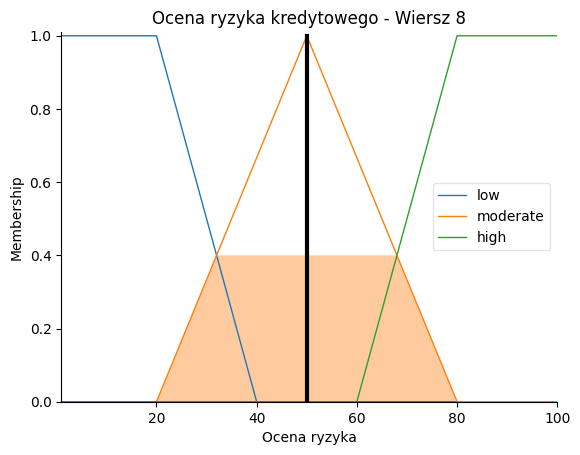

Wartości wejściowe:
Wiek: 61.0
Oszczędności: 90.0
Kwota kredytu: 3059.0
Czas trwania kredytu: 12.0
Wiersz 9:
Ocena ryzyka kredytowego = 33.70 [%]
  Przynależność (Membership):
  Wiek (61.0): young=0.00, middle_aged=0.56, old=0.07
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (3059.0): low=0.65, medium=0.35, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

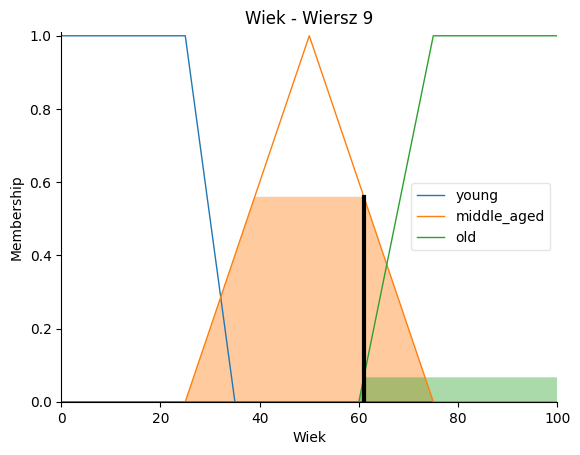

<Figure size 1000x600 with 0 Axes>

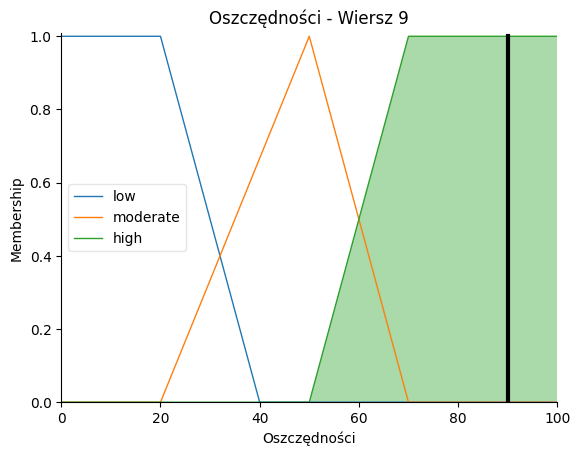

<Figure size 1000x600 with 0 Axes>

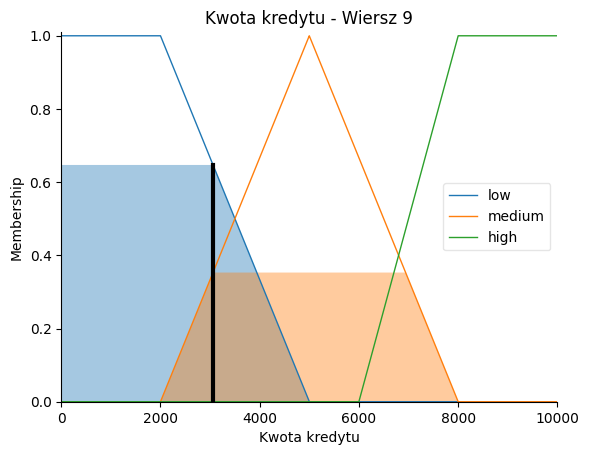

<Figure size 1000x600 with 0 Axes>

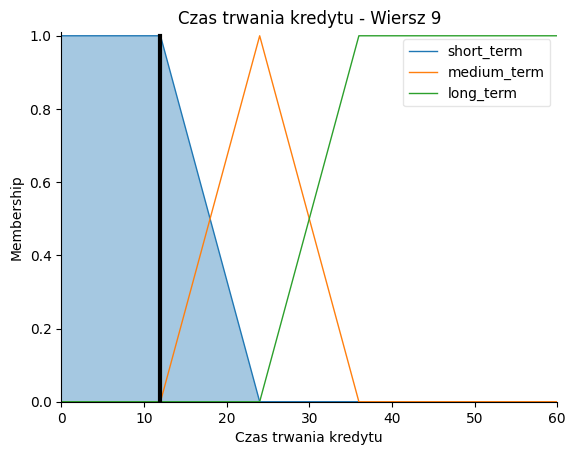

<Figure size 1000x600 with 0 Axes>

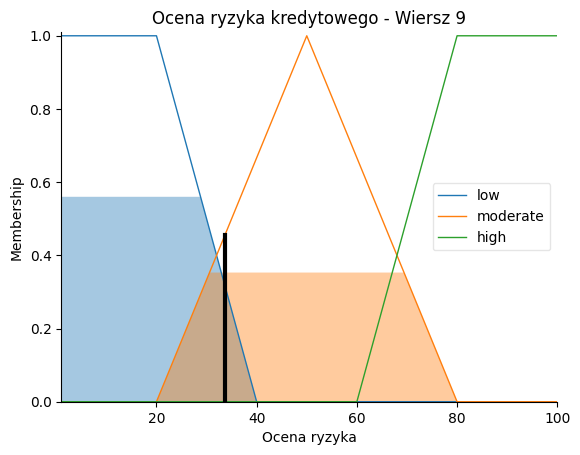

Wartości wejściowe:
Wiek: 28.0
Oszczędności: 30.0
Kwota kredytu: 5234.0
Czas trwania kredytu: 30.0
Wiersz 10:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (28.0): young=0.70, middle_aged=0.12, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (5234.0): low=0.00, medium=0.92, high=0.00
  Czas trwania kredytu (30.0): short=0.00, medium=0.50, long=0.50



<Figure size 1000x600 with 0 Axes>

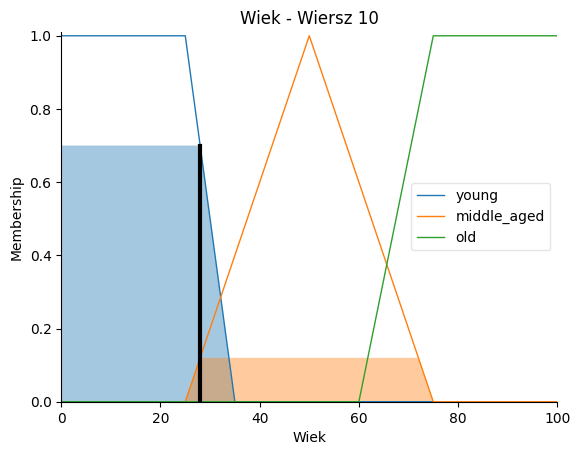

<Figure size 1000x600 with 0 Axes>

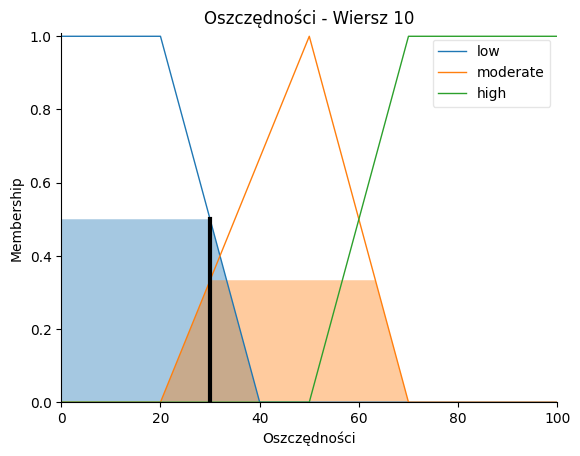

<Figure size 1000x600 with 0 Axes>

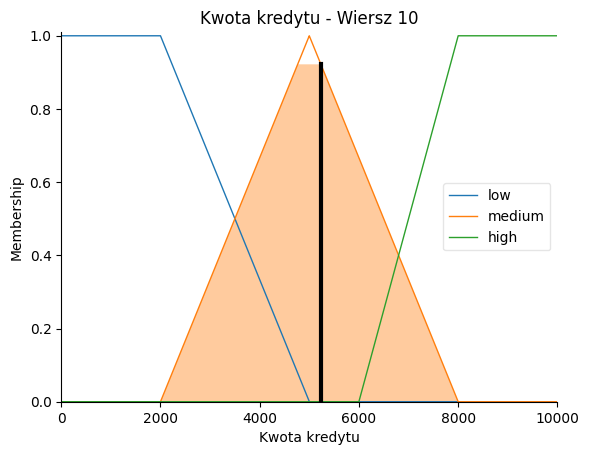

<Figure size 1000x600 with 0 Axes>

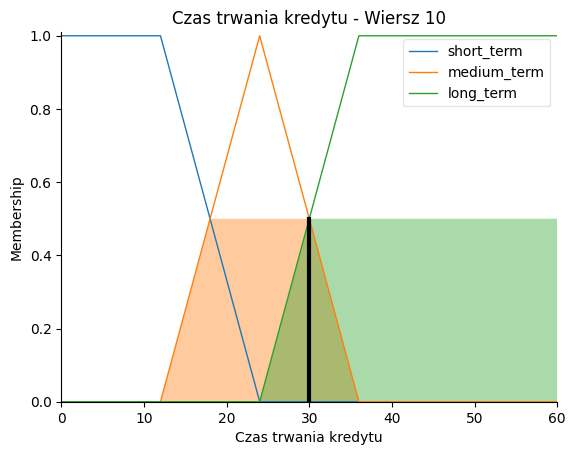

<Figure size 1000x600 with 0 Axes>

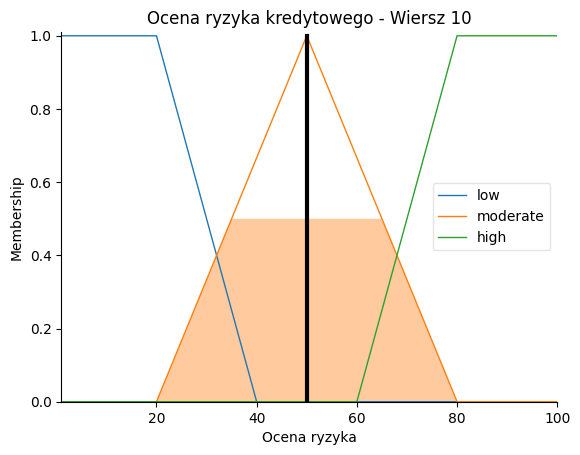

Wartości wejściowe:
Wiek: 25.0
Oszczędności: 30.0
Kwota kredytu: 1295.0
Czas trwania kredytu: 12.0
Wiersz 11:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (25.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1295.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

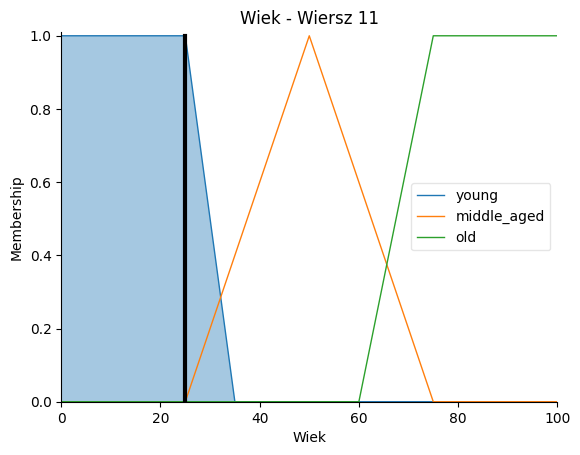

<Figure size 1000x600 with 0 Axes>

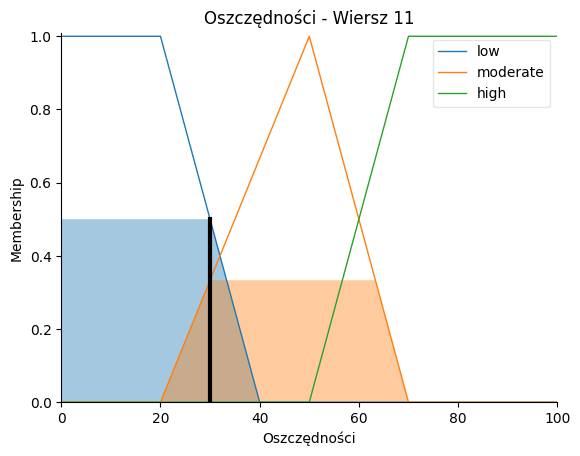

<Figure size 1000x600 with 0 Axes>

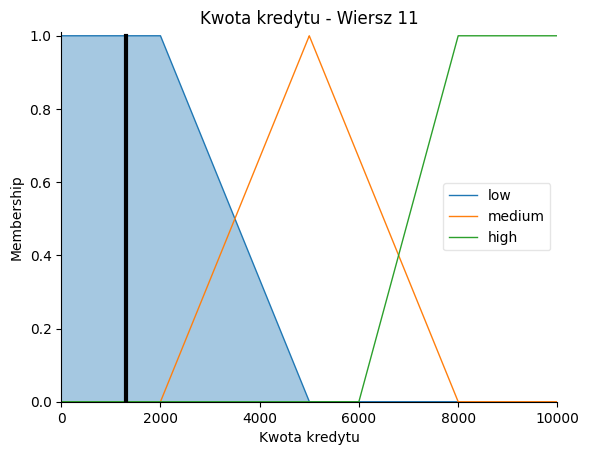

<Figure size 1000x600 with 0 Axes>

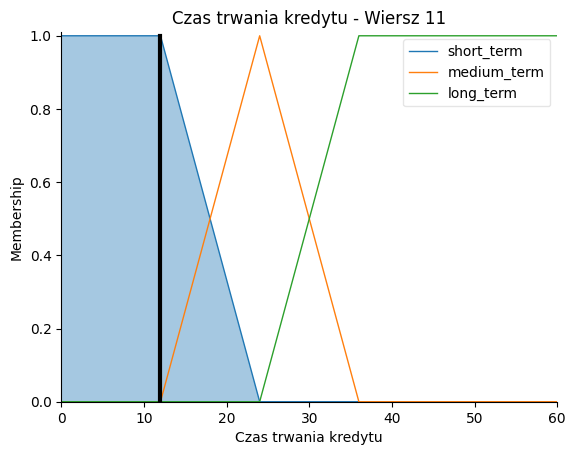

<Figure size 1000x600 with 0 Axes>

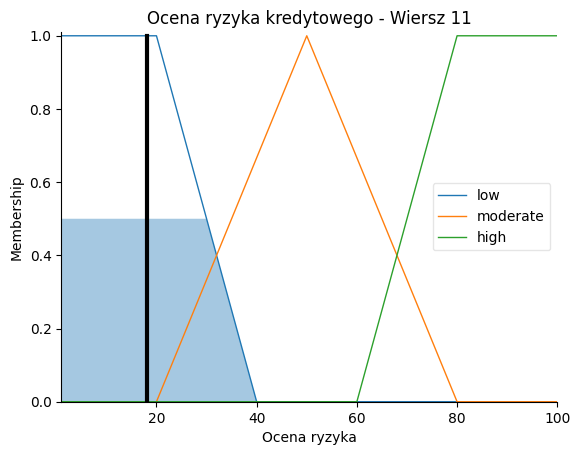

Wartości wejściowe:
Wiek: 24.0
Oszczędności: 30.0
Kwota kredytu: 4308.0
Czas trwania kredytu: 48.0
Wiersz 12:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (24.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (4308.0): low=0.23, medium=0.77, high=0.00
  Czas trwania kredytu (48.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

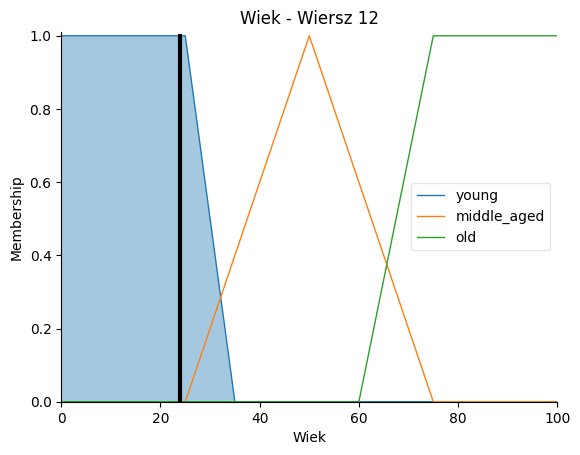

<Figure size 1000x600 with 0 Axes>

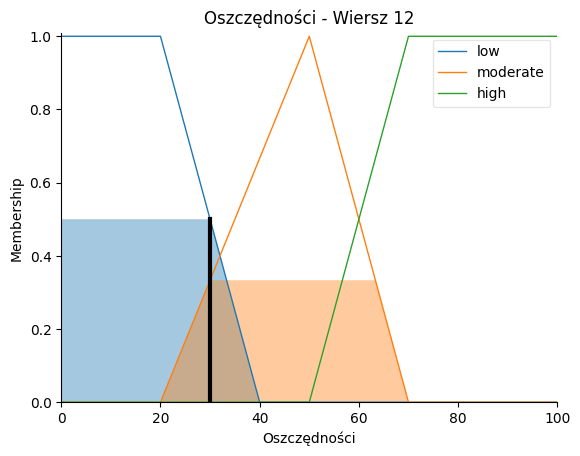

<Figure size 1000x600 with 0 Axes>

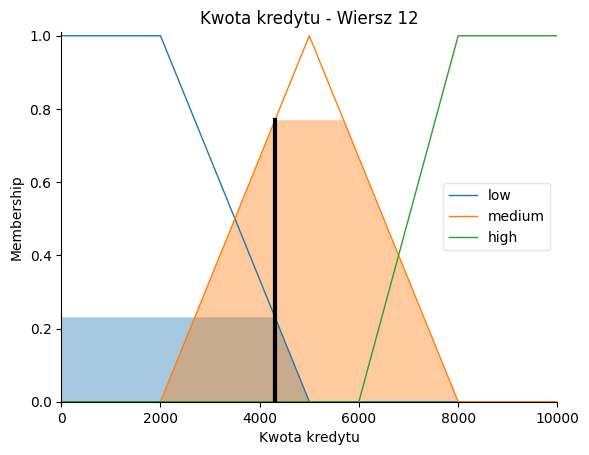

<Figure size 1000x600 with 0 Axes>

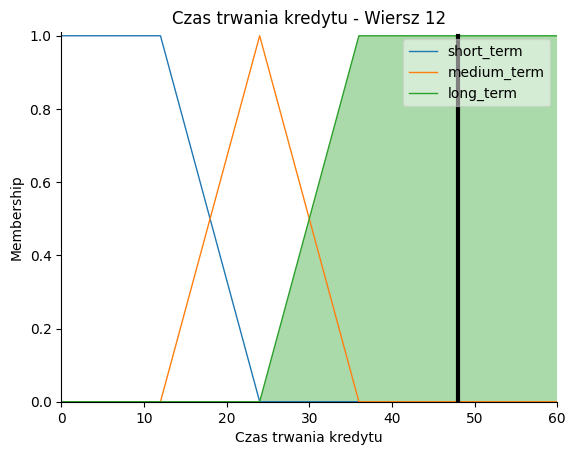

<Figure size 1000x600 with 0 Axes>

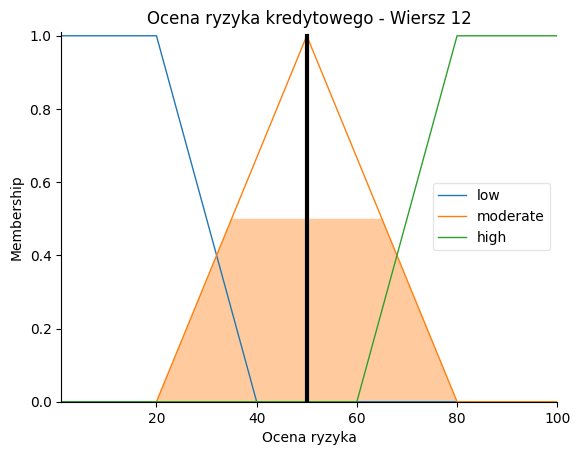

Wartości wejściowe:
Wiek: 22.0
Oszczędności: 30.0
Kwota kredytu: 1567.0
Czas trwania kredytu: 12.0
Wiersz 13:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (22.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1567.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

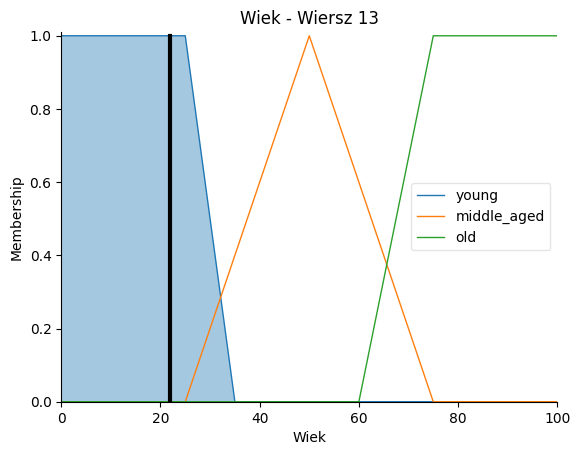

<Figure size 1000x600 with 0 Axes>

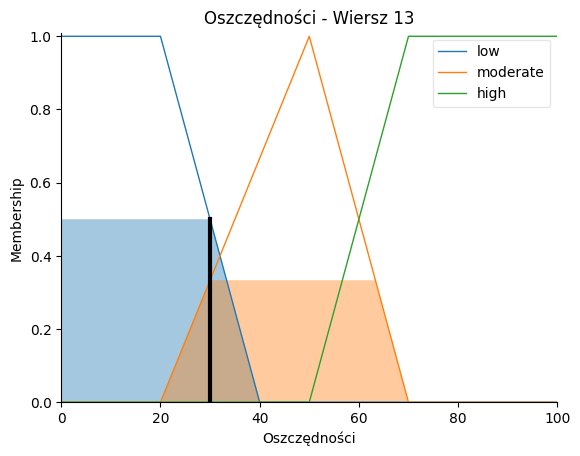

<Figure size 1000x600 with 0 Axes>

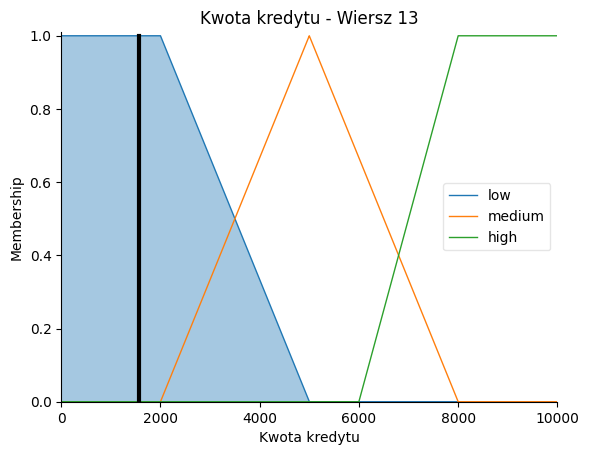

<Figure size 1000x600 with 0 Axes>

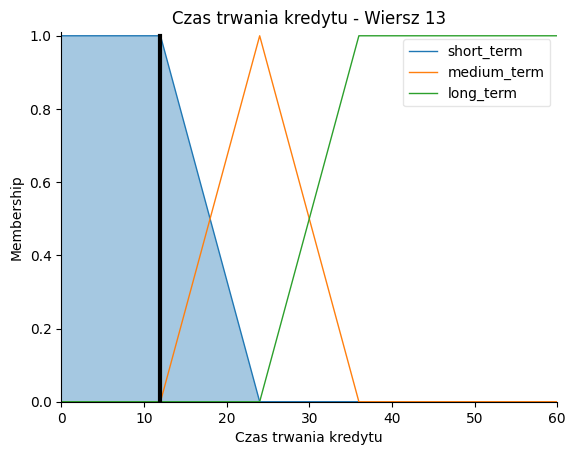

<Figure size 1000x600 with 0 Axes>

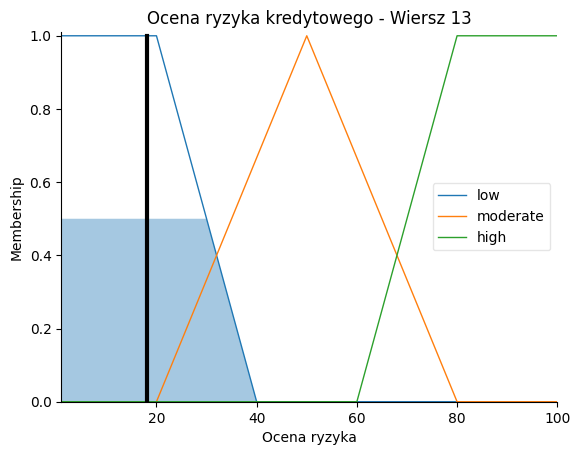

Wartości wejściowe:
Wiek: 60.0
Oszczędności: 30.0
Kwota kredytu: 1199.0
Czas trwania kredytu: 24.0
Wiersz 14:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (60.0): young=0.00, middle_aged=0.60, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1199.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (24.0): short=0.00, medium=1.00, long=0.00



<Figure size 1000x600 with 0 Axes>

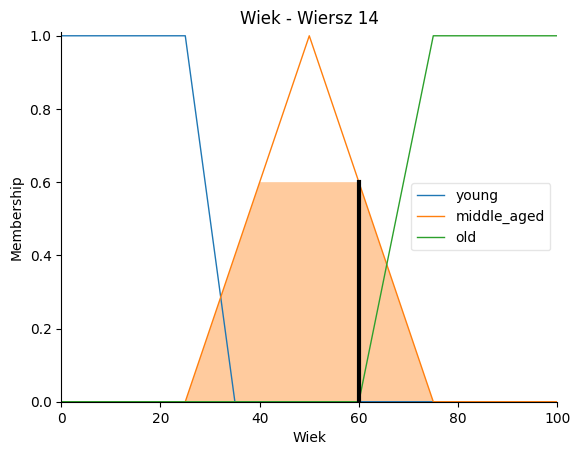

<Figure size 1000x600 with 0 Axes>

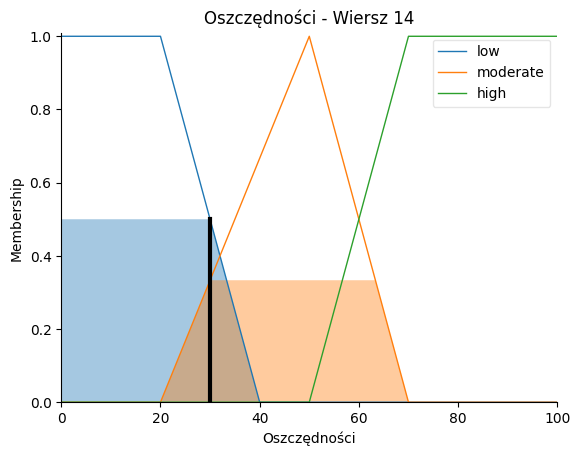

<Figure size 1000x600 with 0 Axes>

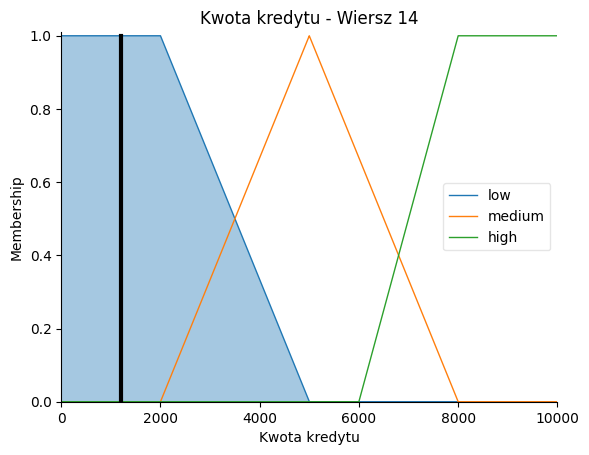

<Figure size 1000x600 with 0 Axes>

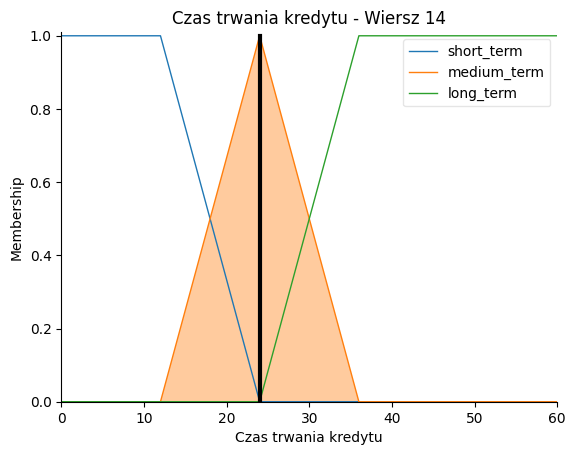

<Figure size 1000x600 with 0 Axes>

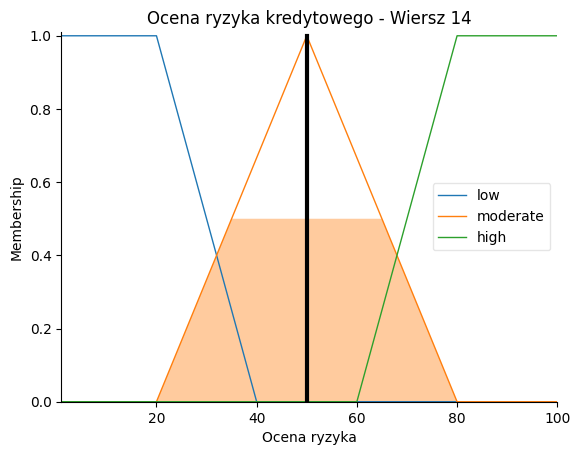

Wartości wejściowe:
Wiek: 28.0
Oszczędności: 30.0
Kwota kredytu: 1403.0
Czas trwania kredytu: 15.0
Wiersz 15:
Ocena ryzyka kredytowego = 32.20 [%]
  Przynależność (Membership):
  Wiek (28.0): young=0.70, middle_aged=0.12, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1403.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (15.0): short=0.75, medium=0.25, long=0.00



<Figure size 1000x600 with 0 Axes>

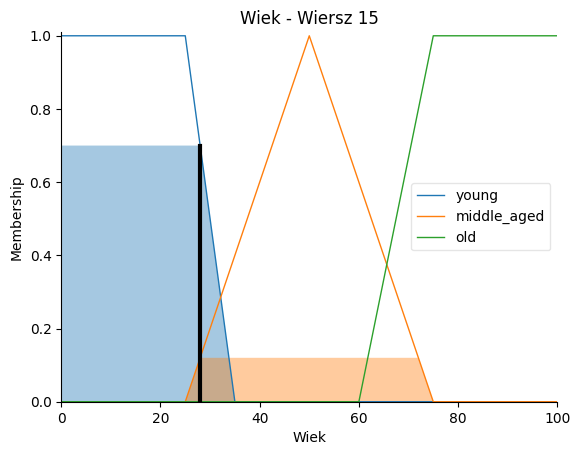

<Figure size 1000x600 with 0 Axes>

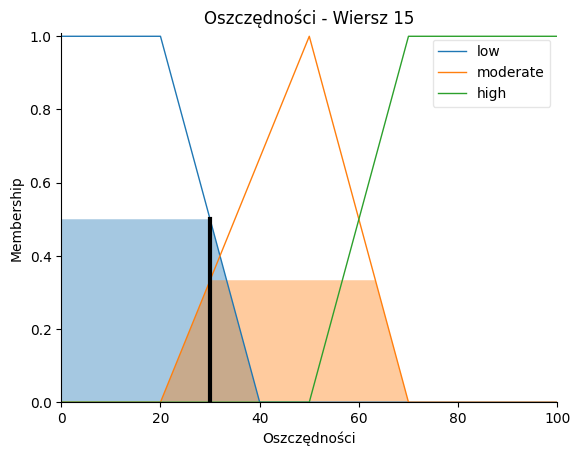

<Figure size 1000x600 with 0 Axes>

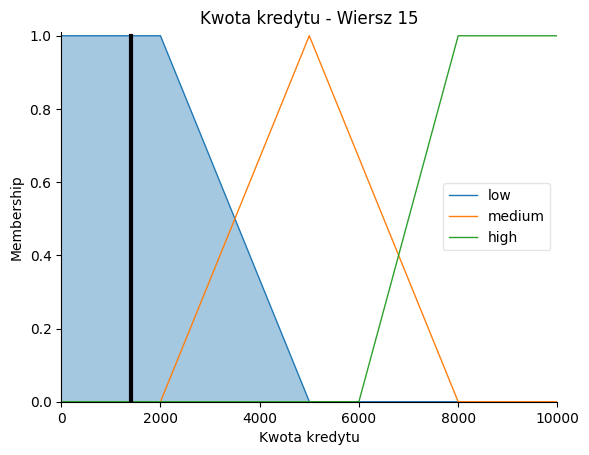

<Figure size 1000x600 with 0 Axes>

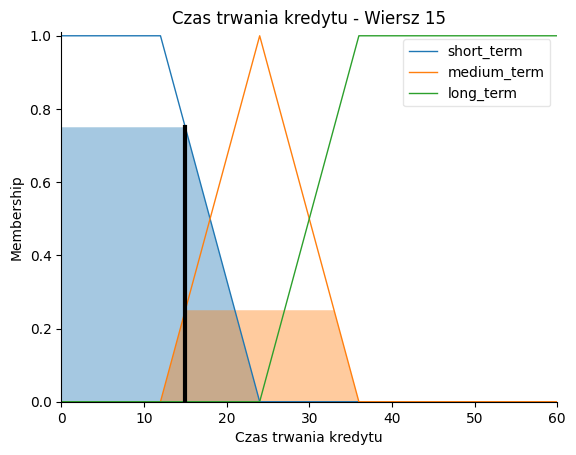

<Figure size 1000x600 with 0 Axes>

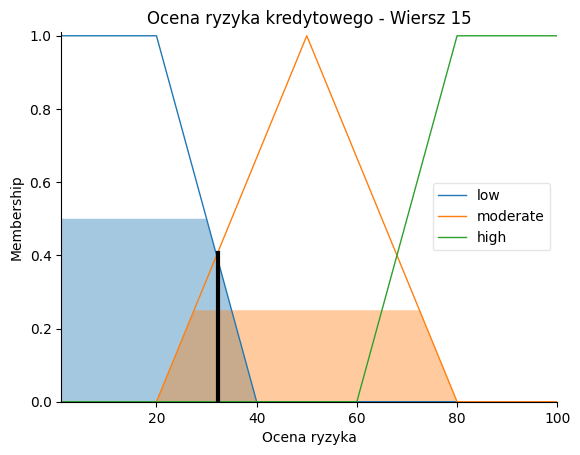

Wartości wejściowe:
Wiek: 32.0
Oszczędności: 50.0
Kwota kredytu: 1282.0
Czas trwania kredytu: 24.0
Wiersz 16:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (32.0): young=0.30, middle_aged=0.28, old=0.00
  Oszczędności (50.0): low=0.00, moderate=1.00, high=0.00
  Kwota kredytu (1282.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (24.0): short=0.00, medium=1.00, long=0.00



<Figure size 1000x600 with 0 Axes>

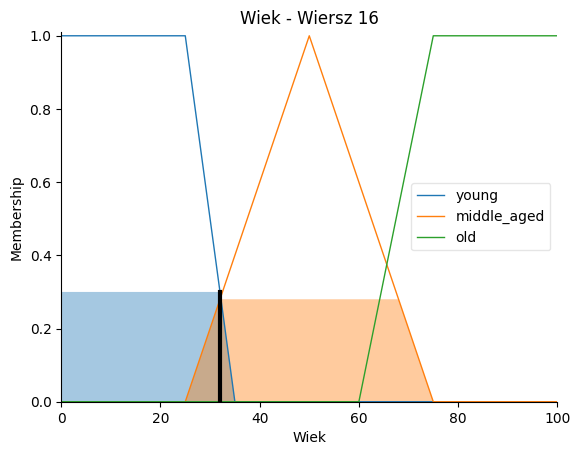

<Figure size 1000x600 with 0 Axes>

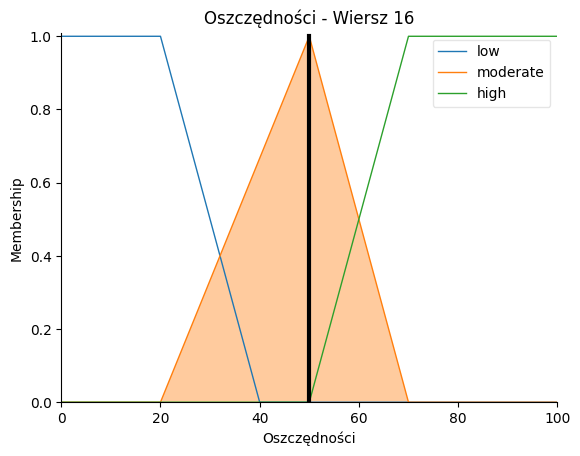

<Figure size 1000x600 with 0 Axes>

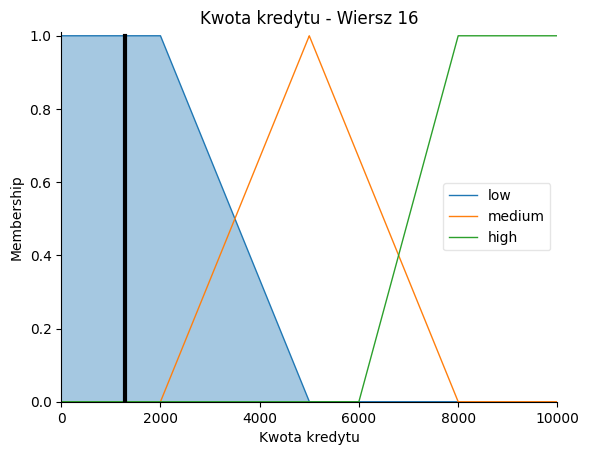

<Figure size 1000x600 with 0 Axes>

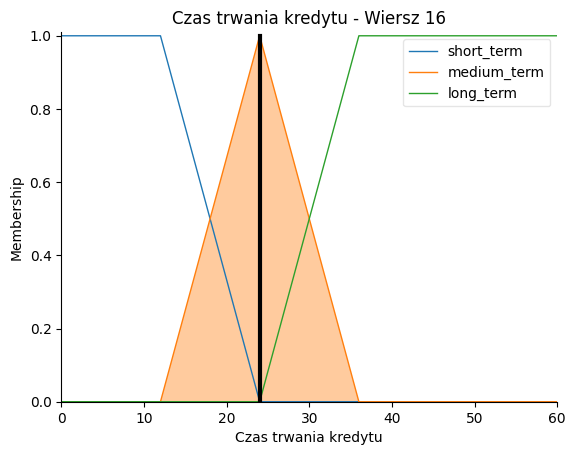

<Figure size 1000x600 with 0 Axes>

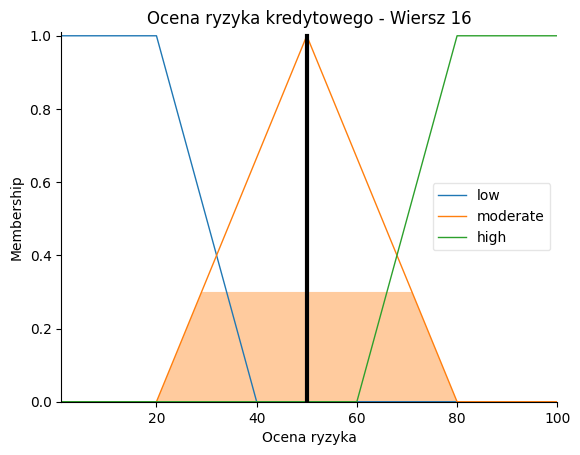

Wartości wejściowe:
Wiek: 44.0
Oszczędności: 30.0
Kwota kredytu: 12579.0
Czas trwania kredytu: 24.0
Wiersz 19:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (44.0): young=0.00, middle_aged=0.76, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (12579.0): low=0.00, medium=0.00, high=0.00
  Czas trwania kredytu (24.0): short=0.00, medium=1.00, long=0.00



<Figure size 1000x600 with 0 Axes>

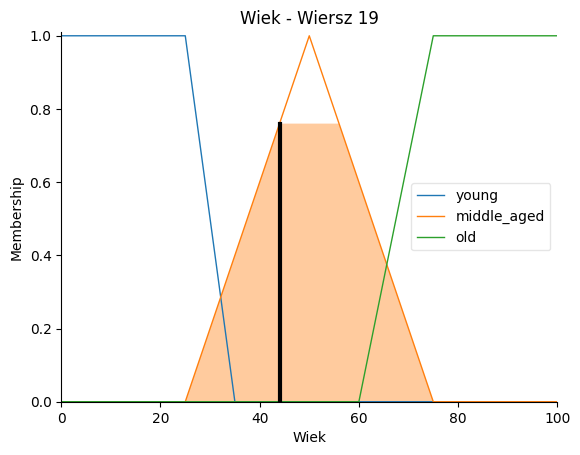

<Figure size 1000x600 with 0 Axes>

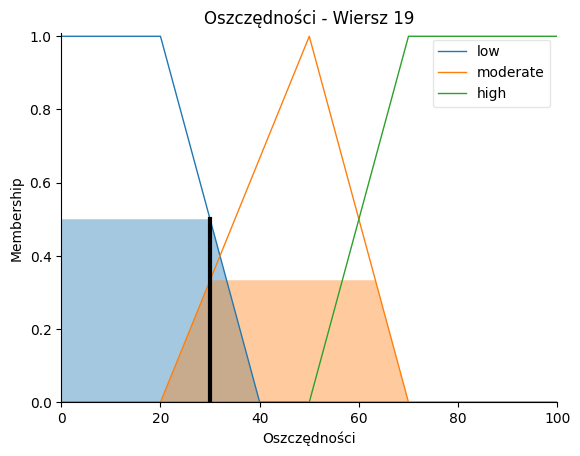

<Figure size 1000x600 with 0 Axes>

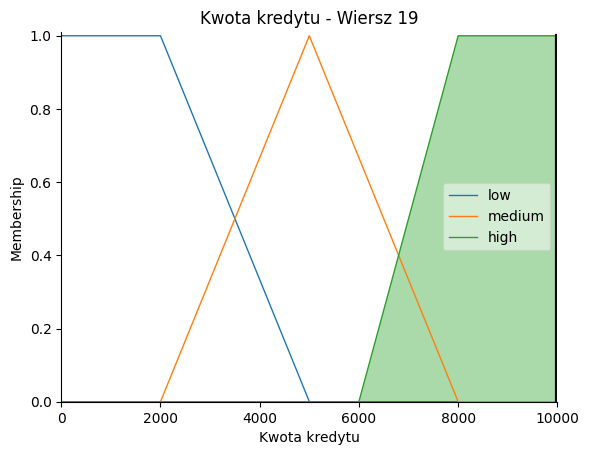

<Figure size 1000x600 with 0 Axes>

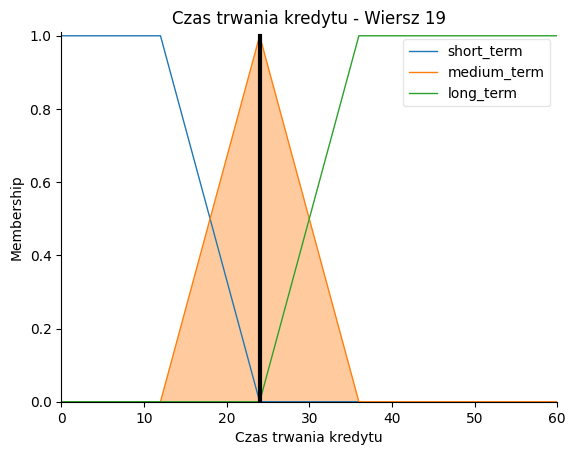

<Figure size 1000x600 with 0 Axes>

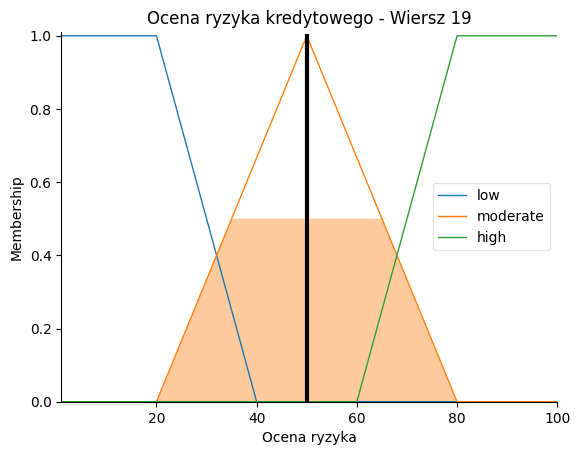

Wartości wejściowe:
Wiek: 31.0
Oszczędności: 90.0
Kwota kredytu: 3430.0
Czas trwania kredytu: 24.0
Wiersz 20:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (31.0): young=0.40, middle_aged=0.24, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (3430.0): low=0.52, medium=0.48, high=0.00
  Czas trwania kredytu (24.0): short=0.00, medium=1.00, long=0.00



<Figure size 1000x600 with 0 Axes>

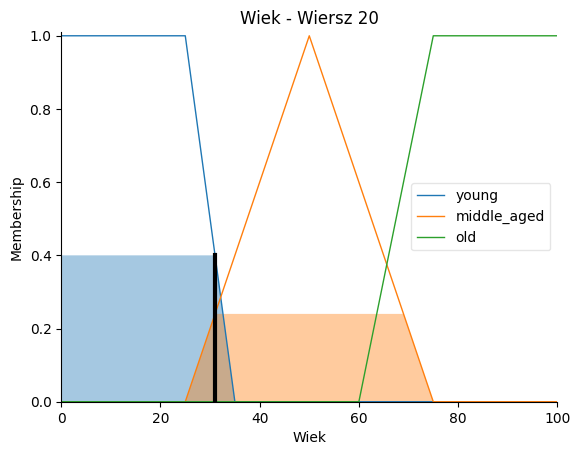

<Figure size 1000x600 with 0 Axes>

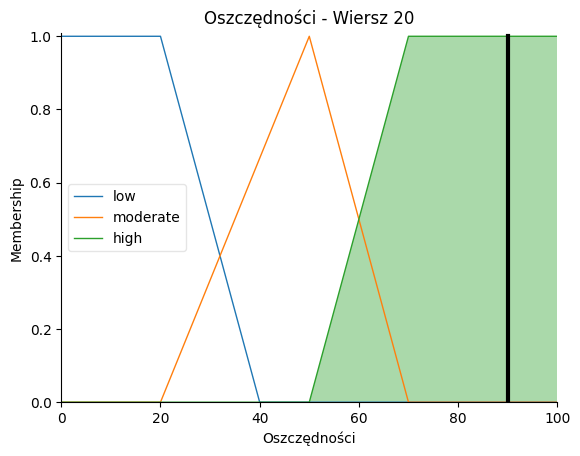

<Figure size 1000x600 with 0 Axes>

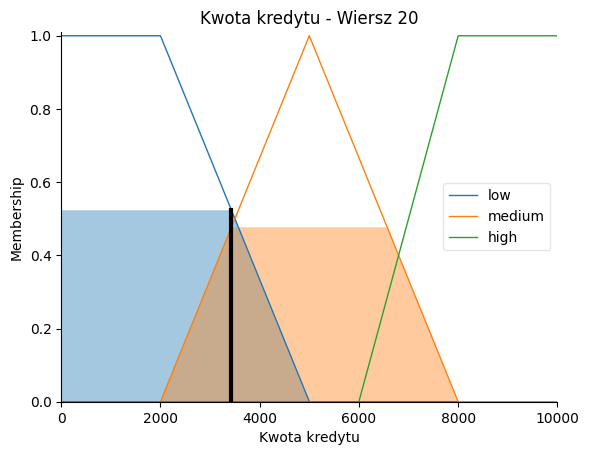

<Figure size 1000x600 with 0 Axes>

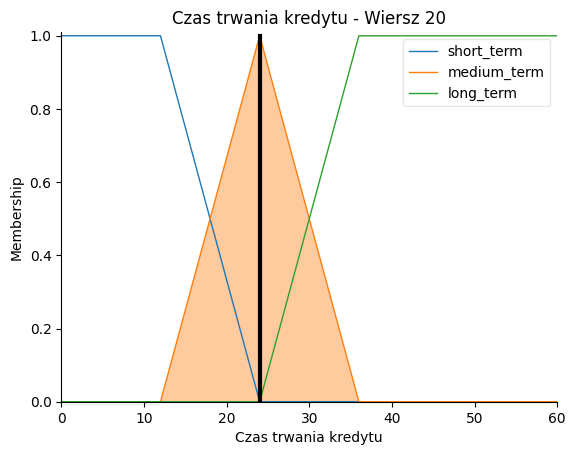

<Figure size 1000x600 with 0 Axes>

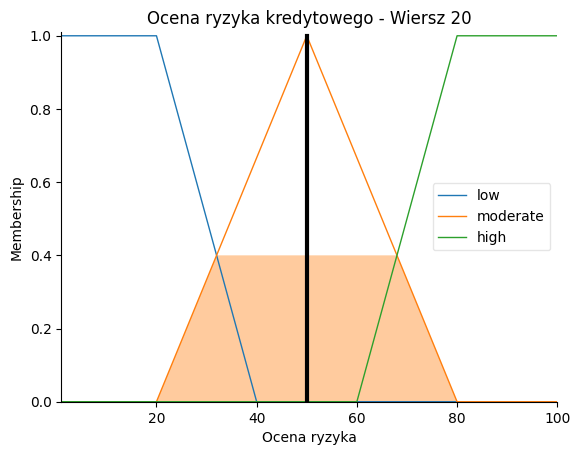

Wartości wejściowe:
Wiek: 48.0
Oszczędności: 30.0
Kwota kredytu: 2134.0
Czas trwania kredytu: 9.0
Wiersz 21:
Ocena ryzyka kredytowego = 22.03 [%]
  Przynależność (Membership):
  Wiek (48.0): young=0.00, middle_aged=0.92, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (2134.0): low=0.96, medium=0.04, high=0.00
  Czas trwania kredytu (9.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

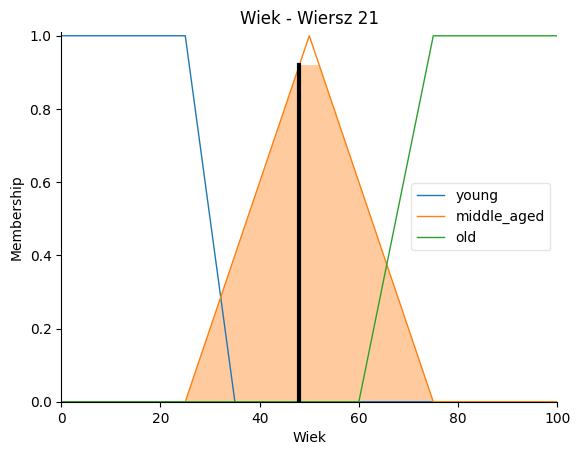

<Figure size 1000x600 with 0 Axes>

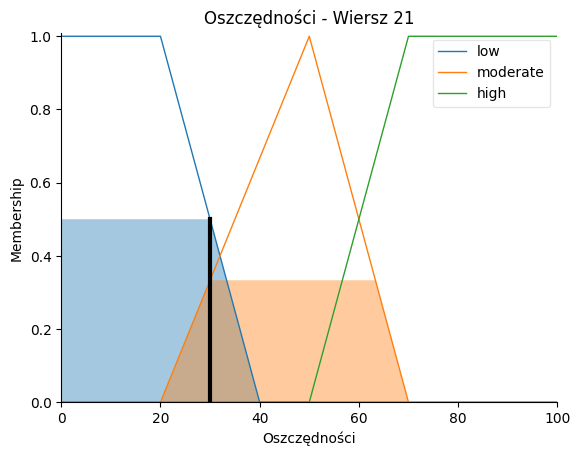

<Figure size 1000x600 with 0 Axes>

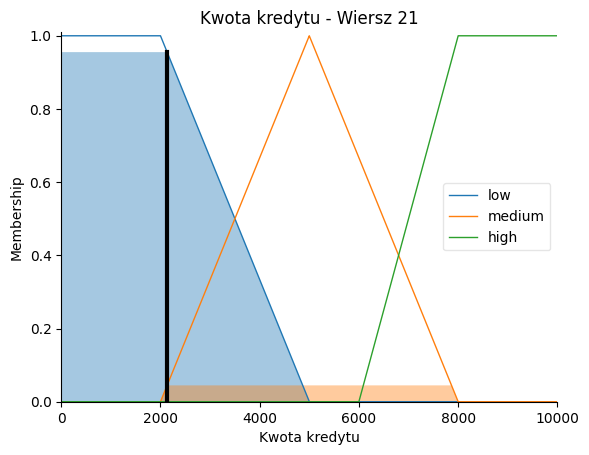

<Figure size 1000x600 with 0 Axes>

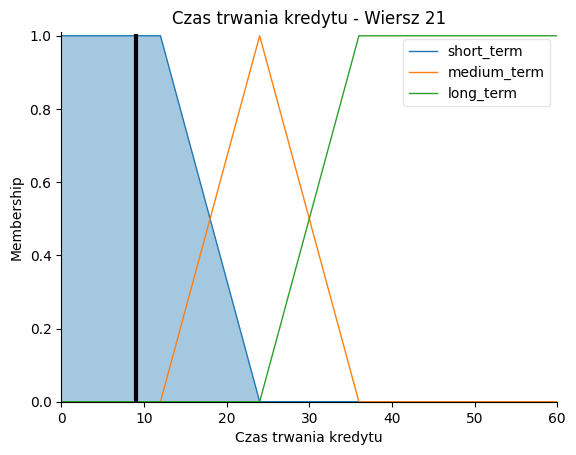

<Figure size 1000x600 with 0 Axes>

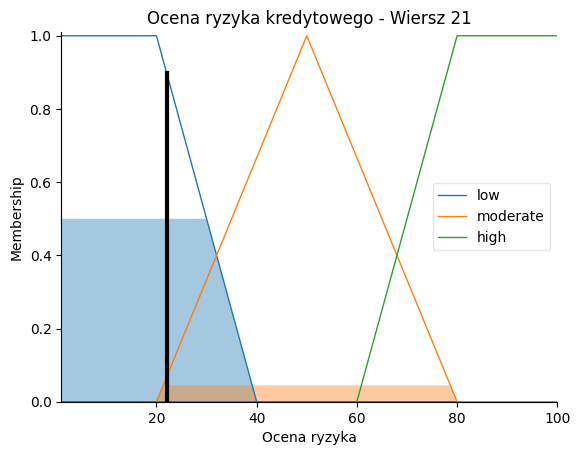

Wartości wejściowe:
Wiek: 44.0
Oszczędności: 90.0
Kwota kredytu: 2647.0
Czas trwania kredytu: 6.0
Wiersz 22:
Ocena ryzyka kredytowego = 27.50 [%]
  Przynależność (Membership):
  Wiek (44.0): young=0.00, middle_aged=0.76, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (2647.0): low=0.78, medium=0.22, high=0.00
  Czas trwania kredytu (6.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

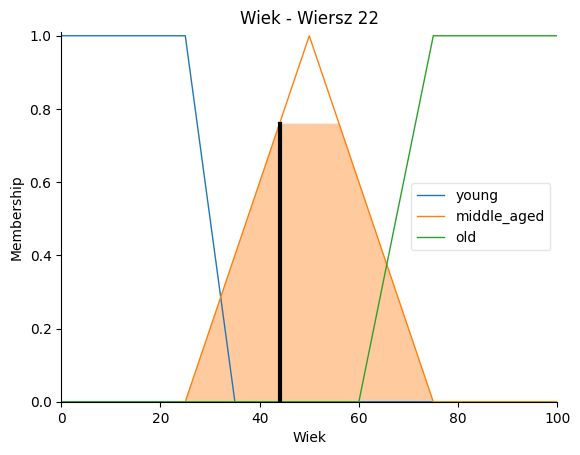

<Figure size 1000x600 with 0 Axes>

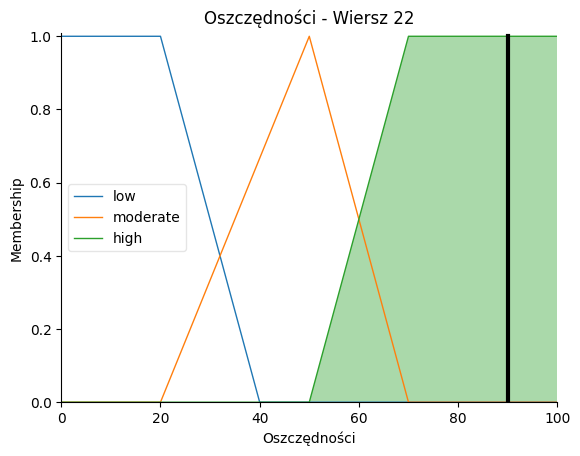

<Figure size 1000x600 with 0 Axes>

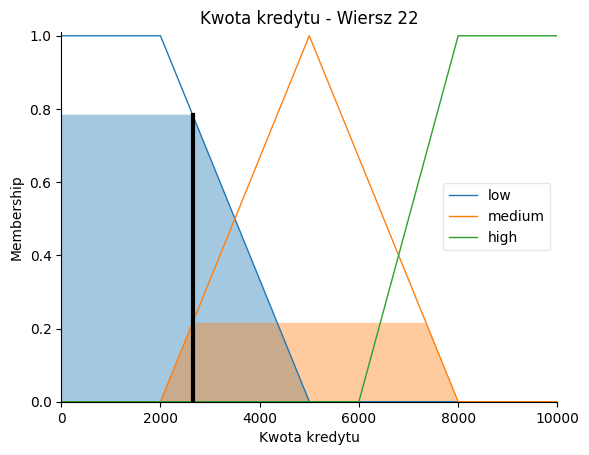

<Figure size 1000x600 with 0 Axes>

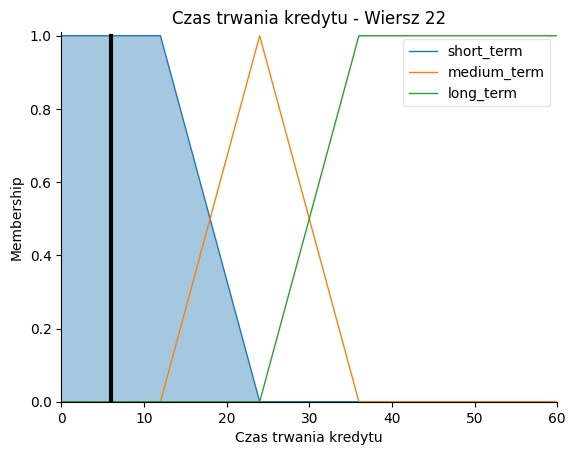

<Figure size 1000x600 with 0 Axes>

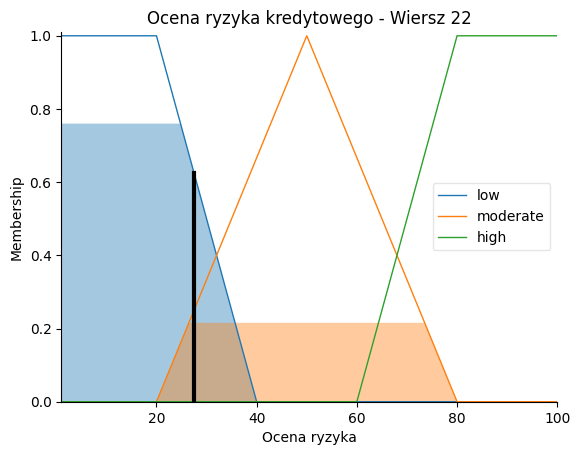

Wartości wejściowe:
Wiek: 48.0
Oszczędności: 30.0
Kwota kredytu: 2241.0
Czas trwania kredytu: 10.0
Wiersz 23:
Ocena ryzyka kredytowego = 24.57 [%]
  Przynależność (Membership):
  Wiek (48.0): young=0.00, middle_aged=0.92, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (2241.0): low=0.92, medium=0.08, high=0.00
  Czas trwania kredytu (10.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

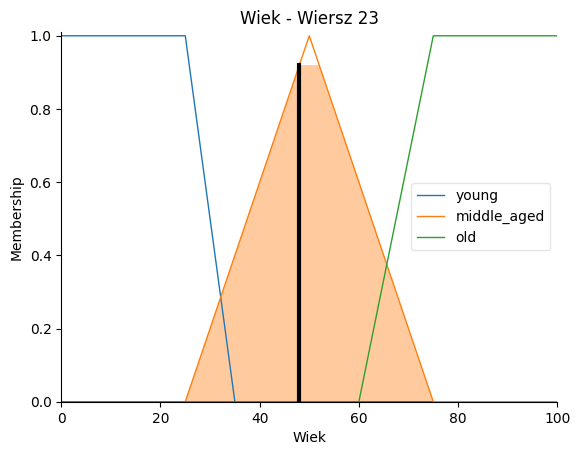

<Figure size 1000x600 with 0 Axes>

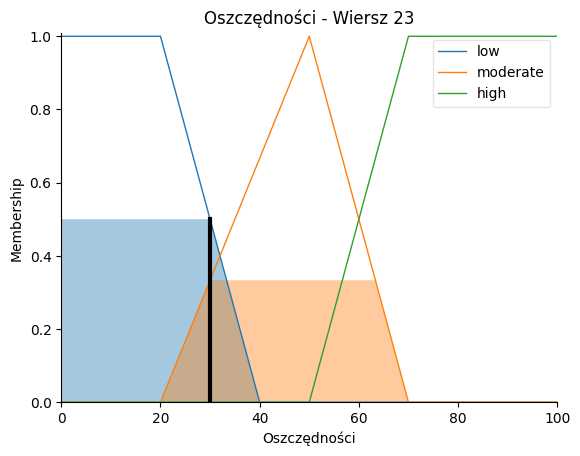

<Figure size 1000x600 with 0 Axes>

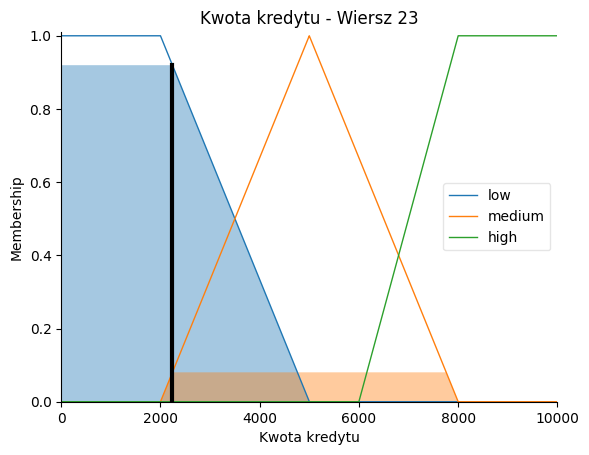

<Figure size 1000x600 with 0 Axes>

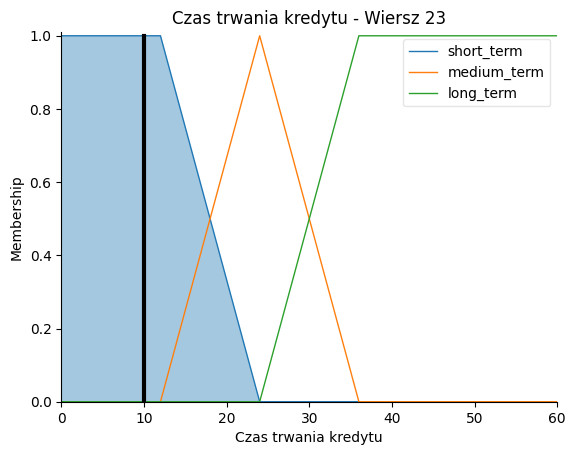

<Figure size 1000x600 with 0 Axes>

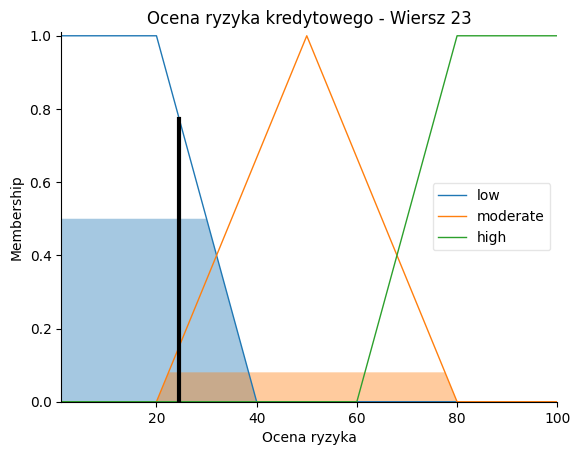

Wartości wejściowe:
Wiek: 44.0
Oszczędności: 50.0
Kwota kredytu: 1804.0
Czas trwania kredytu: 12.0
Wiersz 24:
Ocena ryzyka kredytowego = 17.01 [%]
  Przynależność (Membership):
  Wiek (44.0): young=0.00, middle_aged=0.76, old=0.00
  Oszczędności (50.0): low=0.00, moderate=1.00, high=0.00
  Kwota kredytu (1804.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

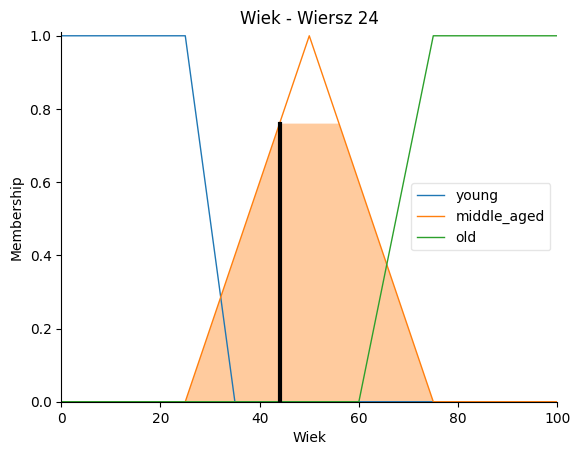

<Figure size 1000x600 with 0 Axes>

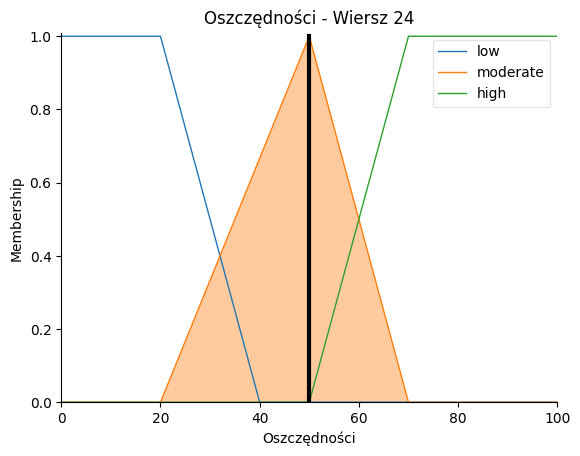

<Figure size 1000x600 with 0 Axes>

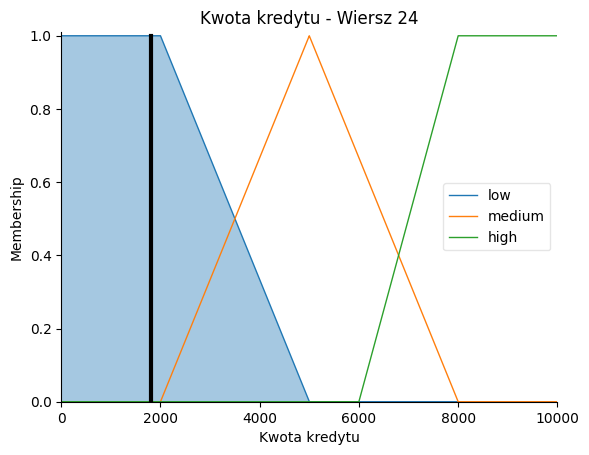

<Figure size 1000x600 with 0 Axes>

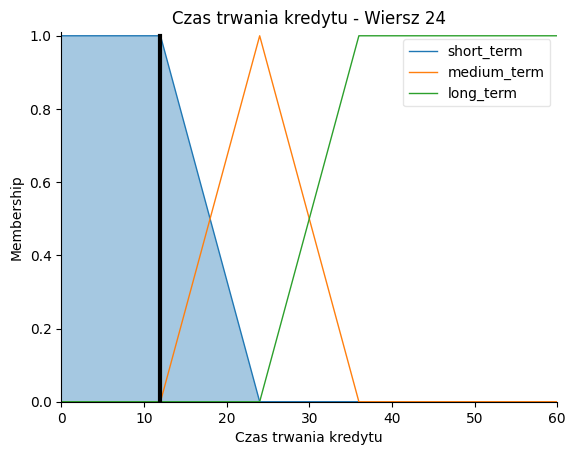

<Figure size 1000x600 with 0 Axes>

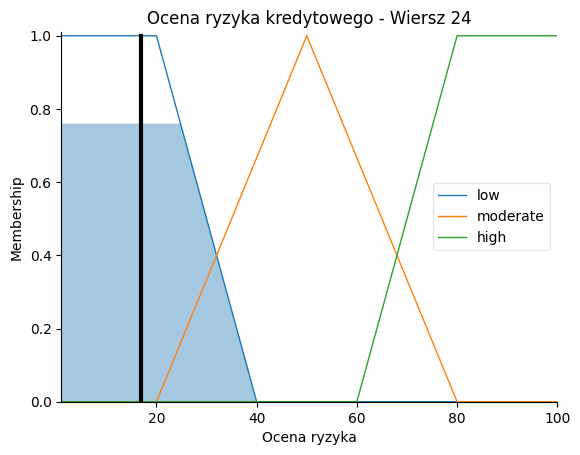

Wartości wejściowe:
Wiek: 36.0
Oszczędności: 30.0
Kwota kredytu: 1374.0
Czas trwania kredytu: 6.0
Wiersz 26:
Ocena ryzyka kredytowego = 18.39 [%]
  Przynależność (Membership):
  Wiek (36.0): young=0.00, middle_aged=0.44, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1374.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (6.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

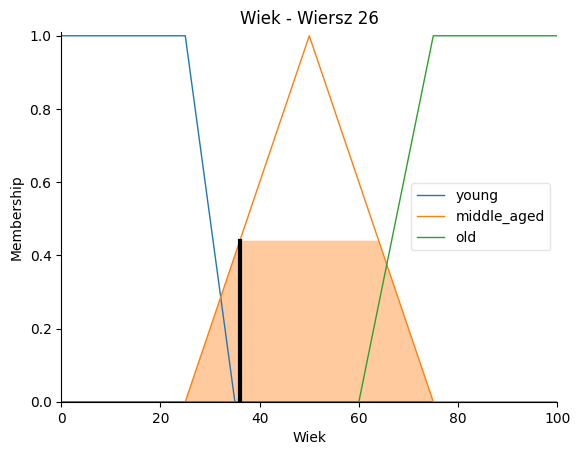

<Figure size 1000x600 with 0 Axes>

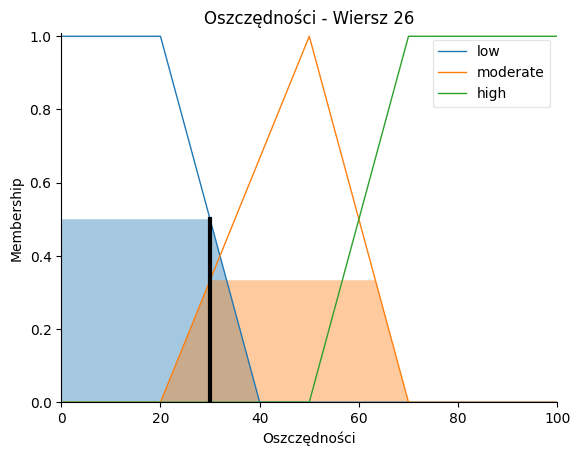

<Figure size 1000x600 with 0 Axes>

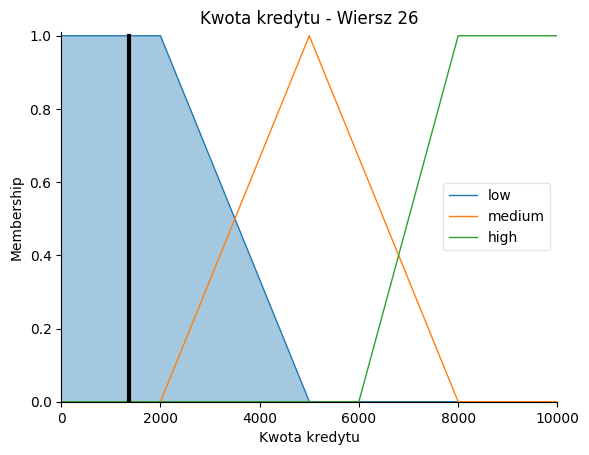

<Figure size 1000x600 with 0 Axes>

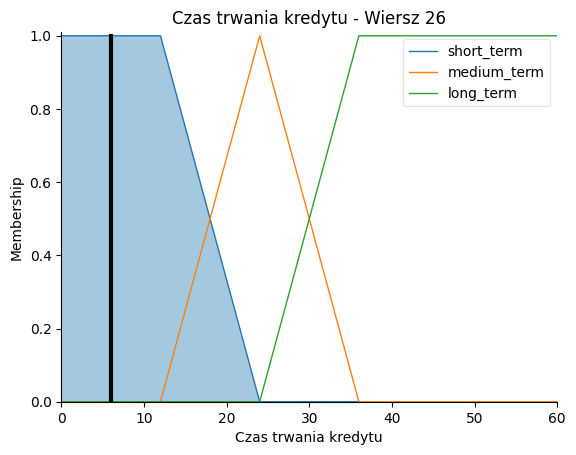

<Figure size 1000x600 with 0 Axes>

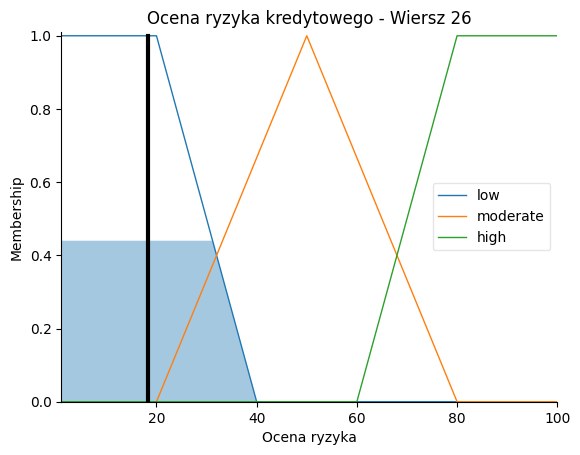

Wartości wejściowe:
Wiek: 39.0
Oszczędności: 30.0
Kwota kredytu: 426.0
Czas trwania kredytu: 6.0
Wiersz 27:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (39.0): young=0.00, middle_aged=0.56, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (426.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (6.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

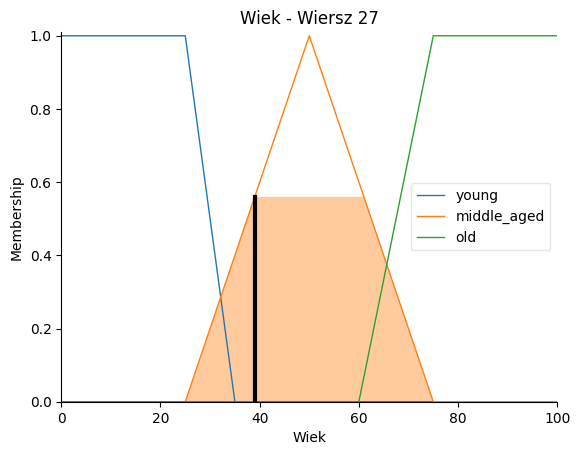

<Figure size 1000x600 with 0 Axes>

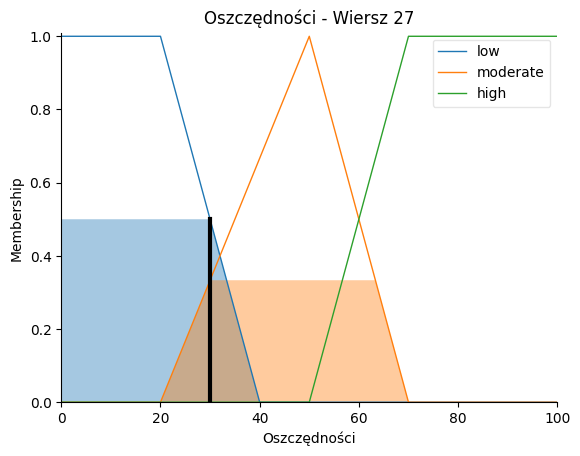

<Figure size 1000x600 with 0 Axes>

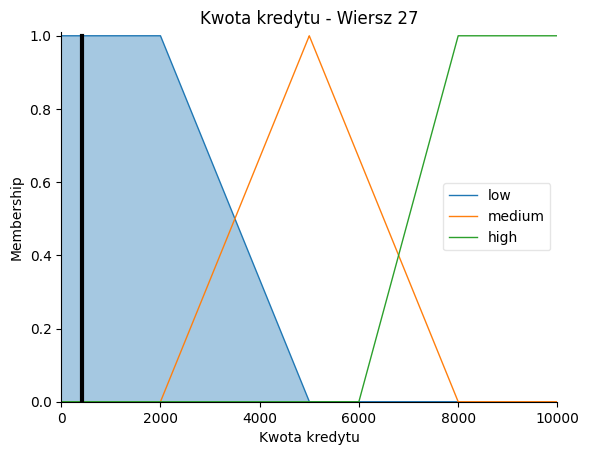

<Figure size 1000x600 with 0 Axes>

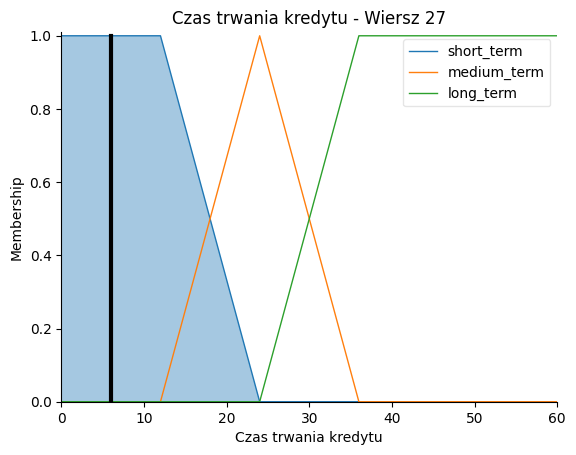

<Figure size 1000x600 with 0 Axes>

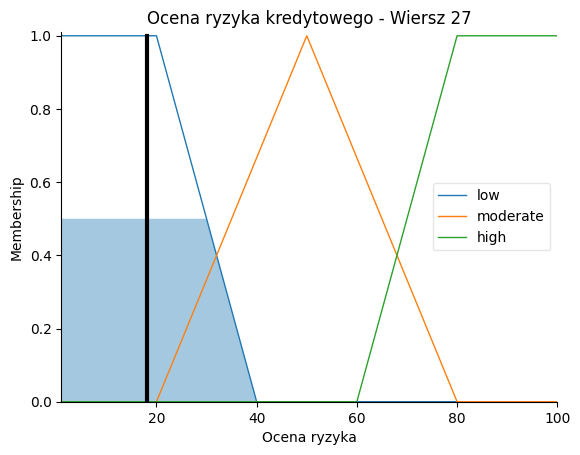

Wartości wejściowe:
Wiek: 42.0
Oszczędności: 90.0
Kwota kredytu: 409.0
Czas trwania kredytu: 12.0
Wiersz 28:
Ocena ryzyka kredytowego = 17.34 [%]
  Przynależność (Membership):
  Wiek (42.0): young=0.00, middle_aged=0.68, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (409.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

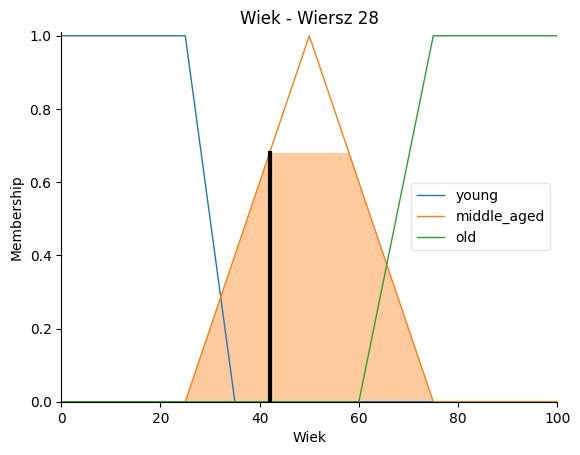

<Figure size 1000x600 with 0 Axes>

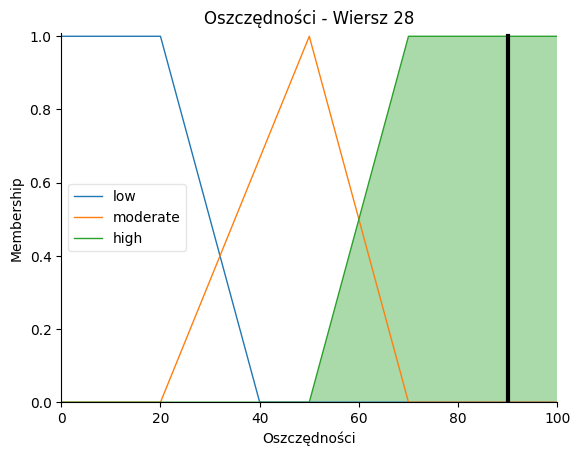

<Figure size 1000x600 with 0 Axes>

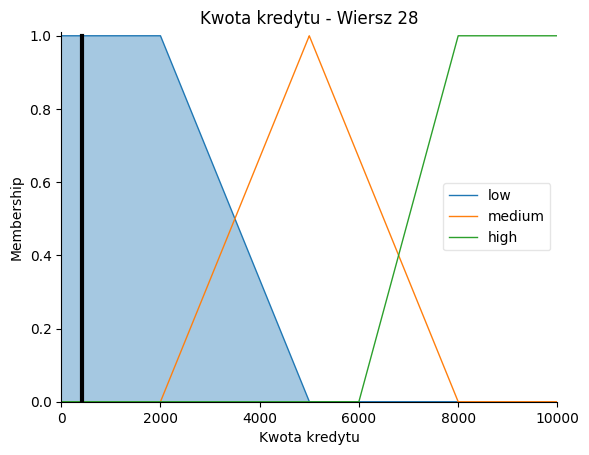

<Figure size 1000x600 with 0 Axes>

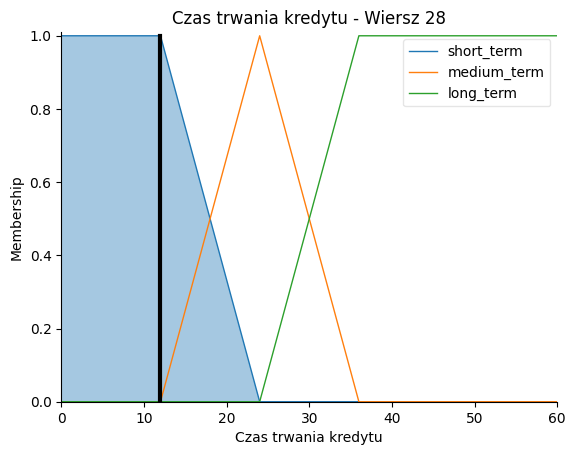

<Figure size 1000x600 with 0 Axes>

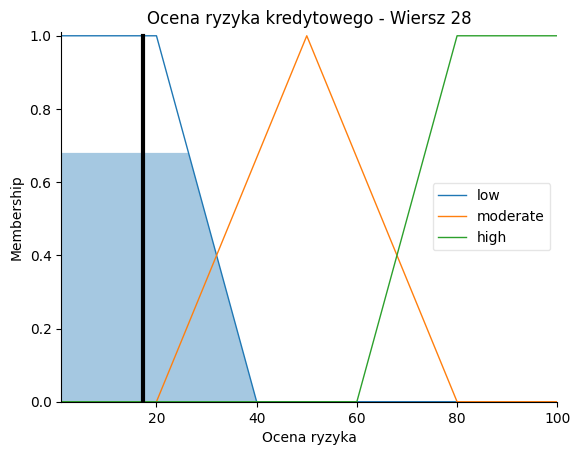

Wartości wejściowe:
Wiek: 34.0
Oszczędności: 30.0
Kwota kredytu: 2415.0
Czas trwania kredytu: 7.0
Wiersz 29:
Ocena ryzyka kredytowego = 30.58 [%]
  Przynależność (Membership):
  Wiek (34.0): young=0.10, middle_aged=0.36, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (2415.0): low=0.86, medium=0.14, high=0.00
  Czas trwania kredytu (7.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

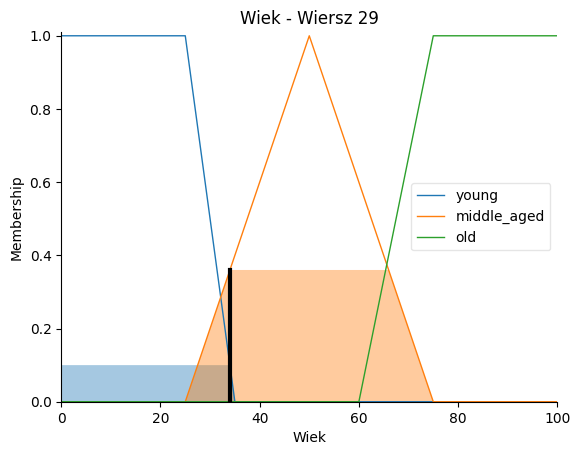

<Figure size 1000x600 with 0 Axes>

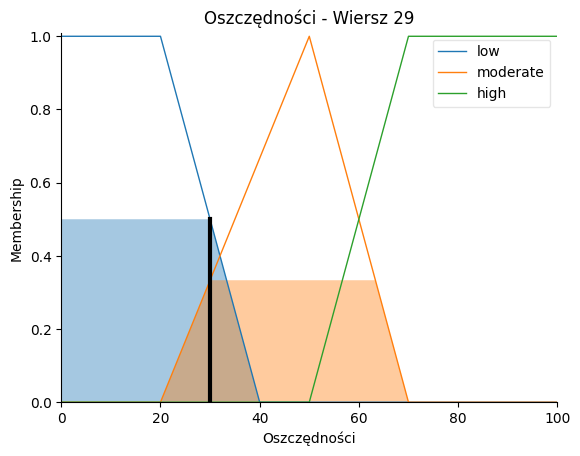

<Figure size 1000x600 with 0 Axes>

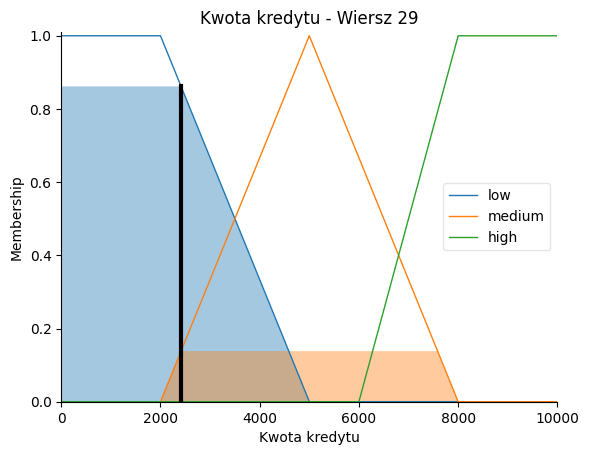

<Figure size 1000x600 with 0 Axes>

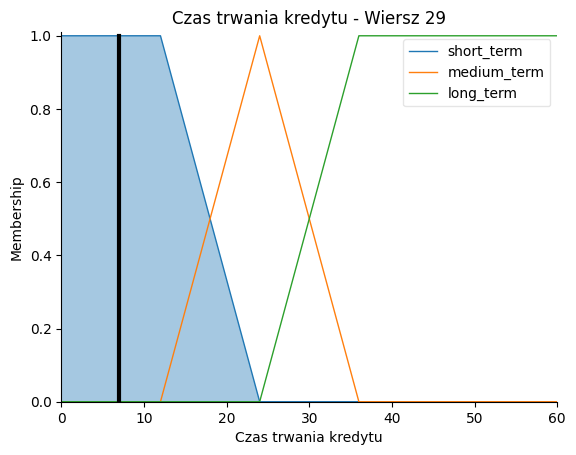

<Figure size 1000x600 with 0 Axes>

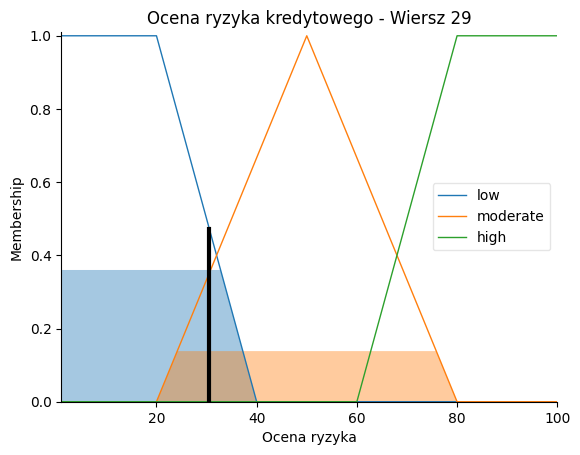

Wartości wejściowe:
Wiek: 63.0
Oszczędności: 30.0
Kwota kredytu: 6836.0
Czas trwania kredytu: 60.0
Wiersz 30:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (63.0): young=0.00, middle_aged=0.48, old=0.20
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (6836.0): low=0.00, medium=0.39, high=0.42
  Czas trwania kredytu (60.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

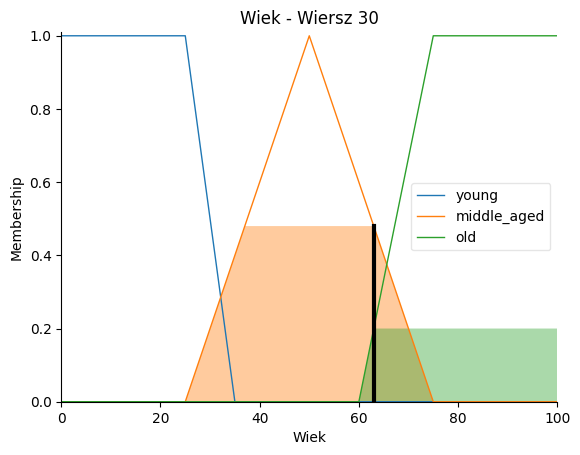

<Figure size 1000x600 with 0 Axes>

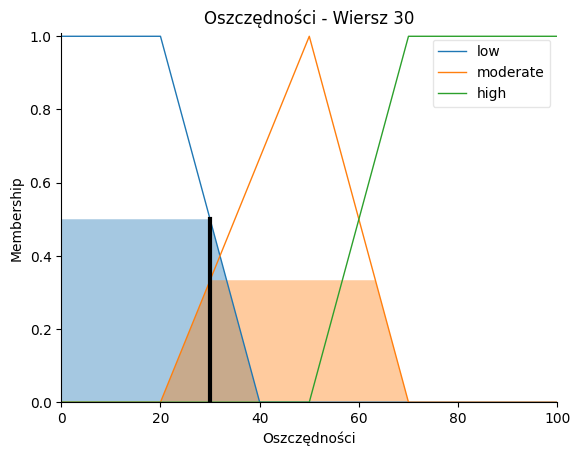

<Figure size 1000x600 with 0 Axes>

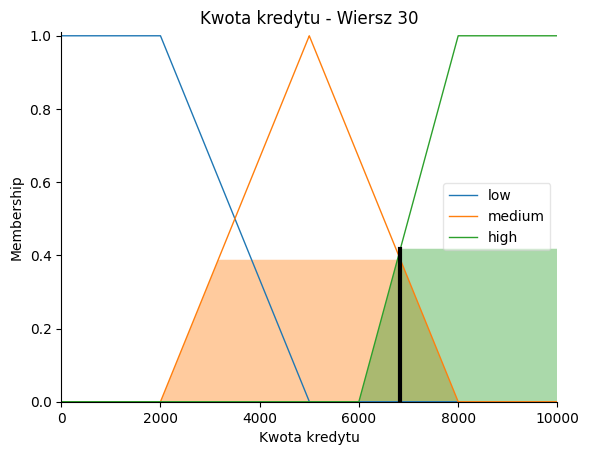

<Figure size 1000x600 with 0 Axes>

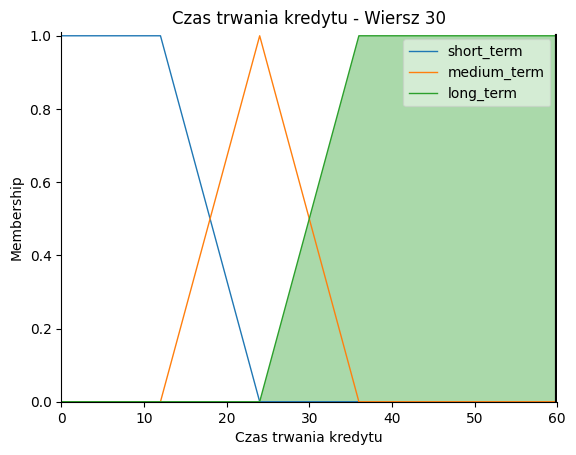

<Figure size 1000x600 with 0 Axes>

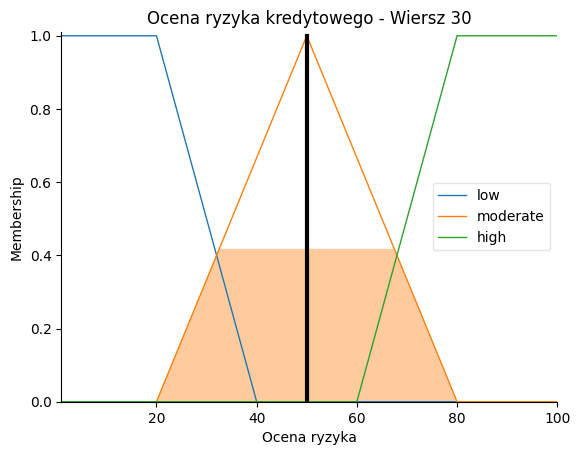

Wartości wejściowe:
Wiek: 36.0
Oszczędności: 90.0
Kwota kredytu: 1913.0
Czas trwania kredytu: 18.0
Wiersz 31:
Ocena ryzyka kredytowego = 37.31 [%]
  Przynależność (Membership):
  Wiek (36.0): young=0.00, middle_aged=0.44, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (1913.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (18.0): short=0.50, medium=0.50, long=0.00



<Figure size 1000x600 with 0 Axes>

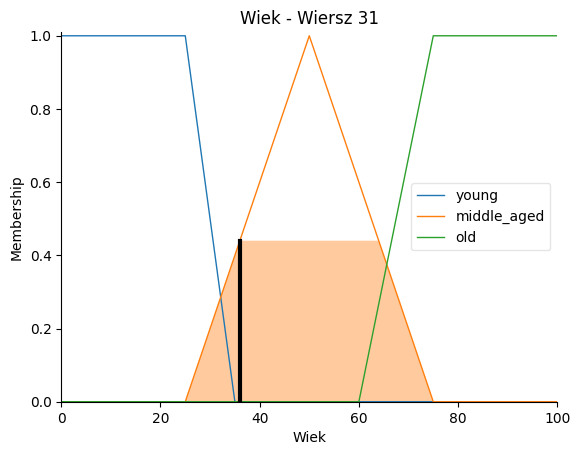

<Figure size 1000x600 with 0 Axes>

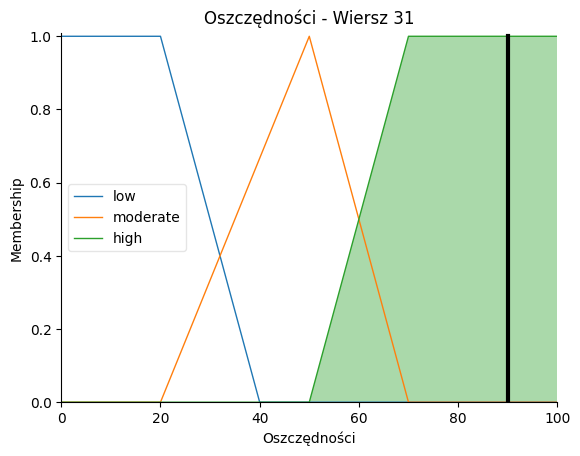

<Figure size 1000x600 with 0 Axes>

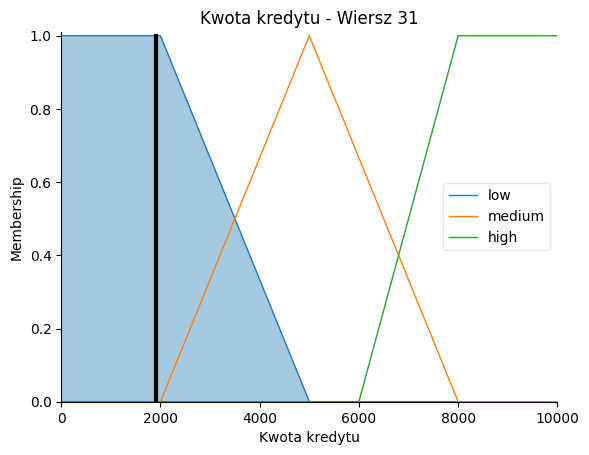

<Figure size 1000x600 with 0 Axes>

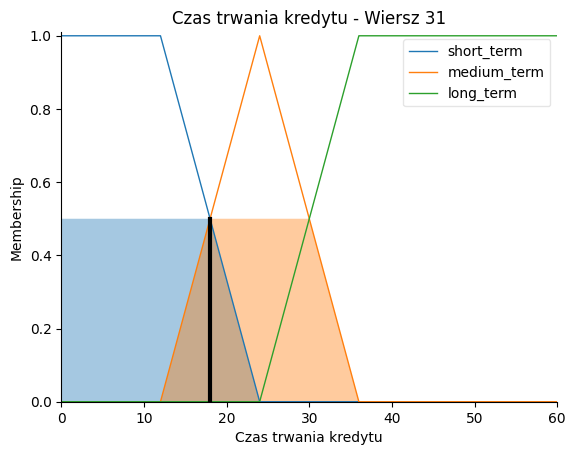

<Figure size 1000x600 with 0 Axes>

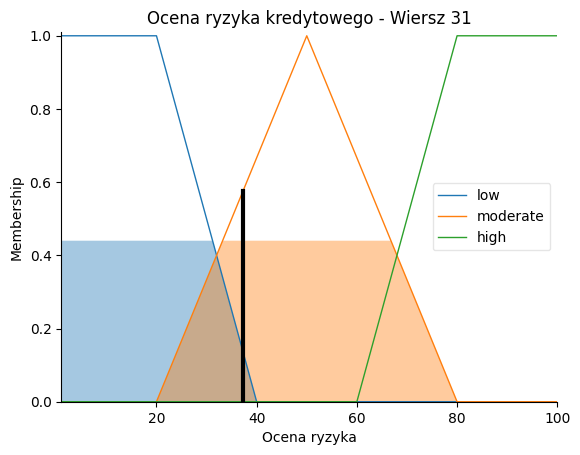

Wartości wejściowe:
Wiek: 27.0
Oszczędności: 30.0
Kwota kredytu: 4020.0
Czas trwania kredytu: 24.0
Wiersz 32:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (27.0): young=0.80, middle_aged=0.08, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (4020.0): low=0.33, medium=0.67, high=0.00
  Czas trwania kredytu (24.0): short=0.00, medium=1.00, long=0.00



<Figure size 1000x600 with 0 Axes>

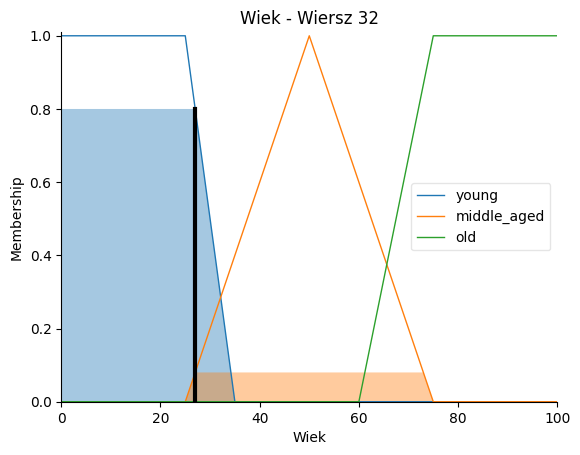

<Figure size 1000x600 with 0 Axes>

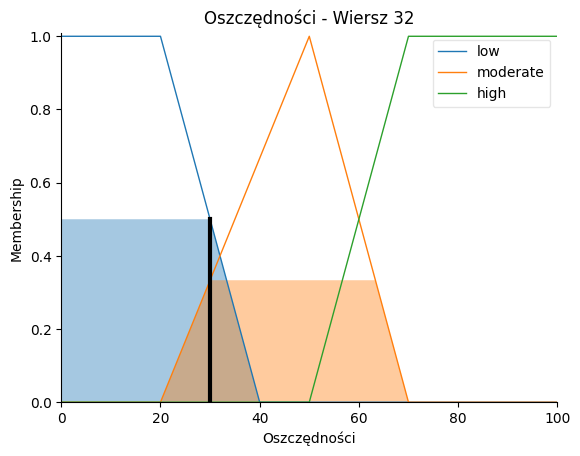

<Figure size 1000x600 with 0 Axes>

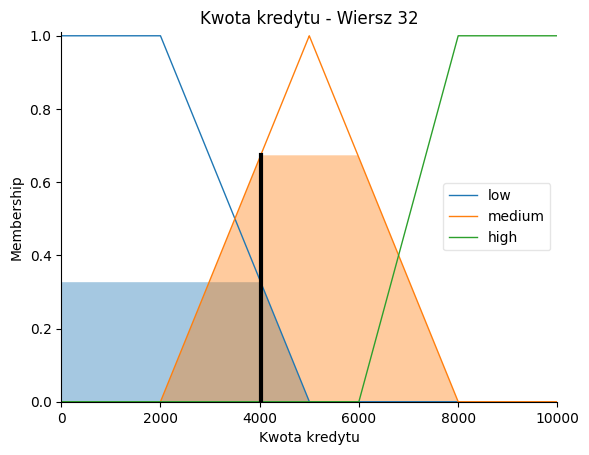

<Figure size 1000x600 with 0 Axes>

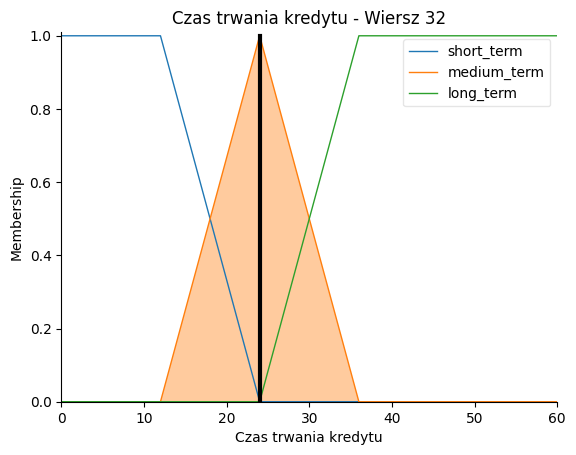

<Figure size 1000x600 with 0 Axes>

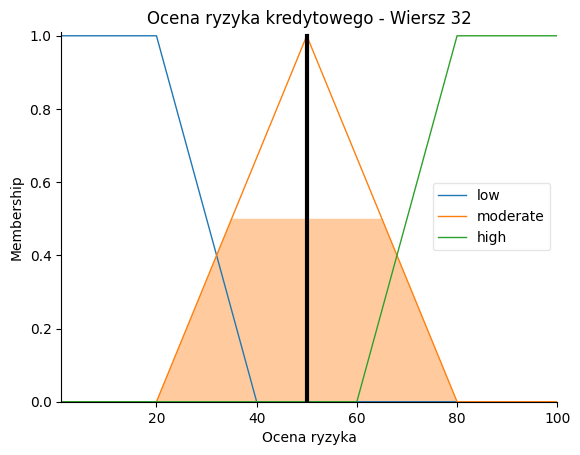

Wartości wejściowe:
Wiek: 30.0
Oszczędności: 50.0
Kwota kredytu: 5866.0
Czas trwania kredytu: 18.0
Wiersz 33:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (30.0): young=0.50, middle_aged=0.20, old=0.00
  Oszczędności (50.0): low=0.00, moderate=1.00, high=0.00
  Kwota kredytu (5866.0): low=0.00, medium=0.71, high=0.00
  Czas trwania kredytu (18.0): short=0.50, medium=0.50, long=0.00



<Figure size 1000x600 with 0 Axes>

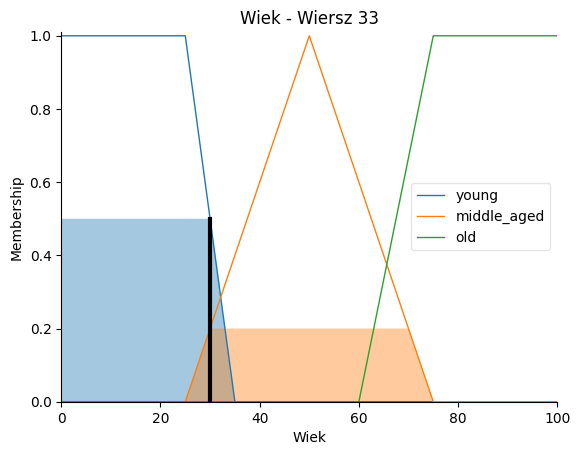

<Figure size 1000x600 with 0 Axes>

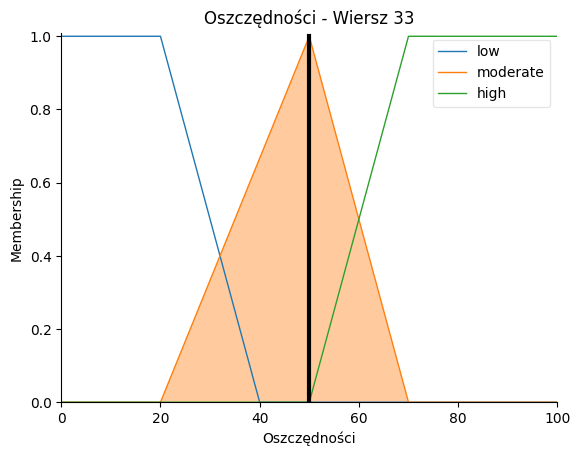

<Figure size 1000x600 with 0 Axes>

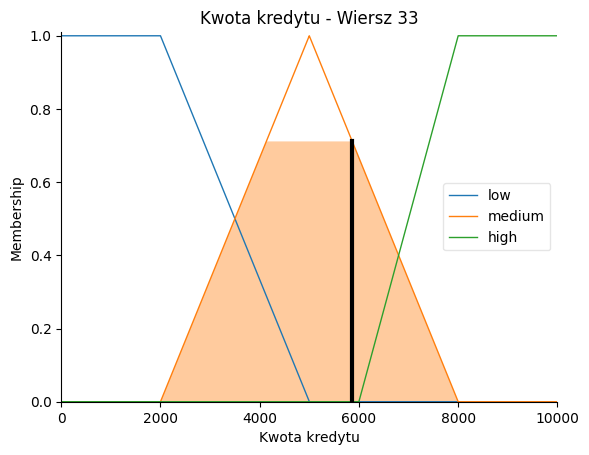

<Figure size 1000x600 with 0 Axes>

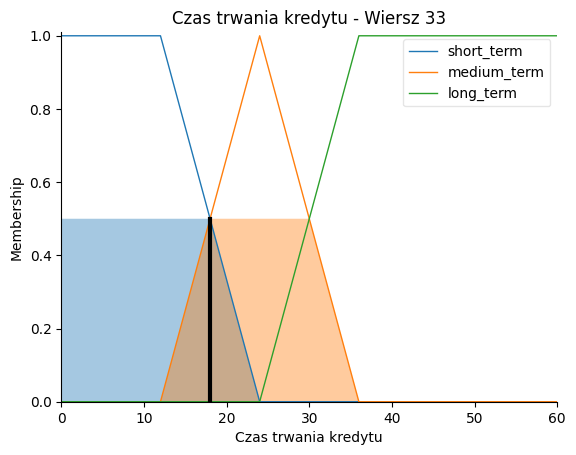

<Figure size 1000x600 with 0 Axes>

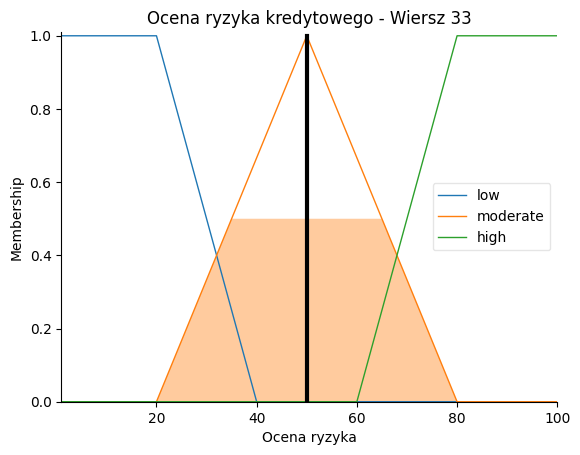

Wartości wejściowe:
Wiek: 33.0
Oszczędności: 30.0
Kwota kredytu: 1474.0
Czas trwania kredytu: 12.0
Wiersz 35:
Ocena ryzyka kredytowego = 18.95 [%]
  Przynależność (Membership):
  Wiek (33.0): young=0.20, middle_aged=0.32, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1474.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

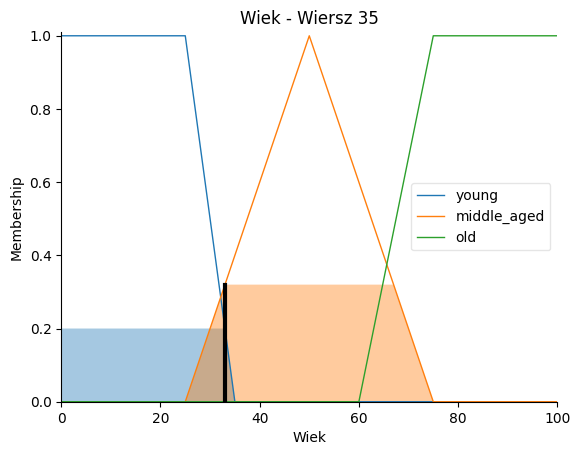

<Figure size 1000x600 with 0 Axes>

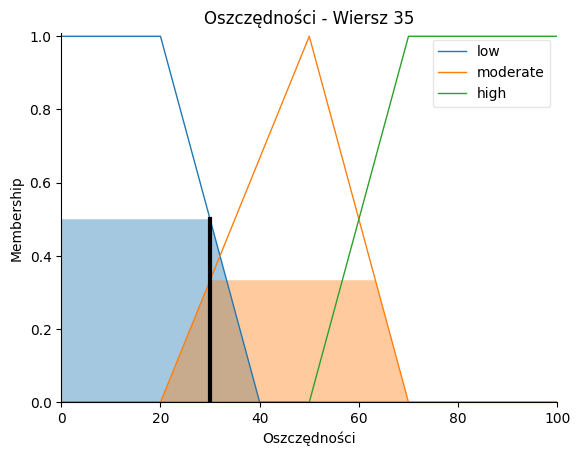

<Figure size 1000x600 with 0 Axes>

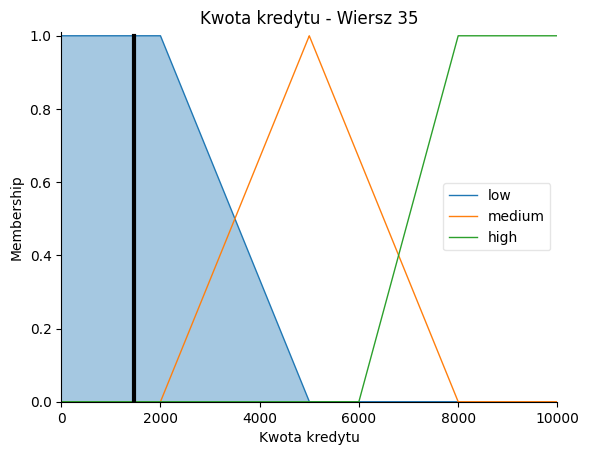

<Figure size 1000x600 with 0 Axes>

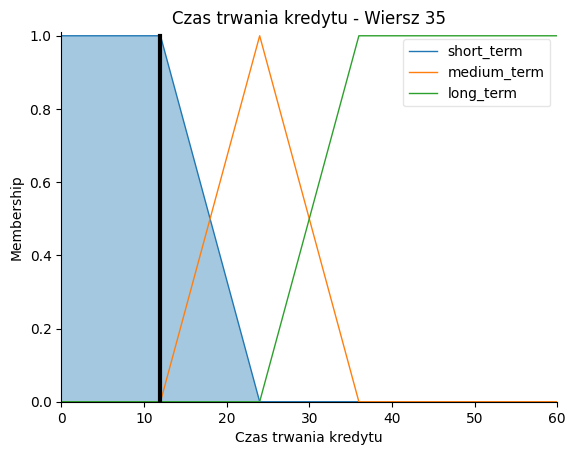

<Figure size 1000x600 with 0 Axes>

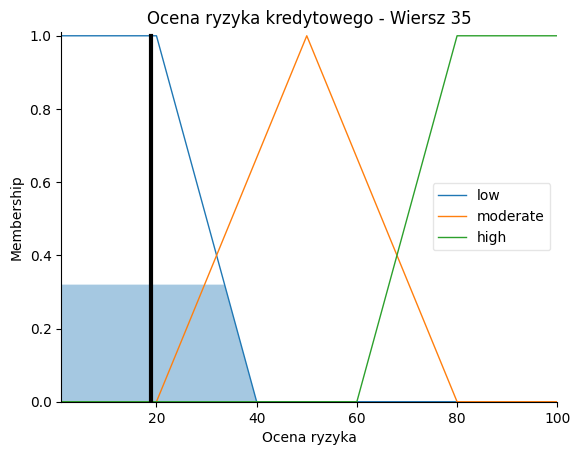

Wartości wejściowe:
Wiek: 25.0
Oszczędności: 30.0
Kwota kredytu: 4746.0
Czas trwania kredytu: 45.0
Wiersz 36:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (25.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (4746.0): low=0.08, medium=0.92, high=0.00
  Czas trwania kredytu (45.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

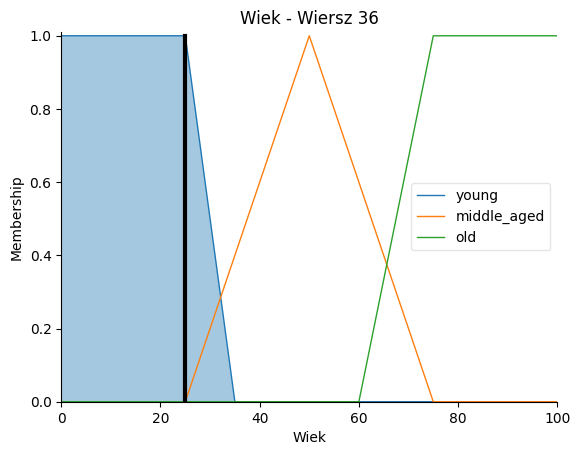

<Figure size 1000x600 with 0 Axes>

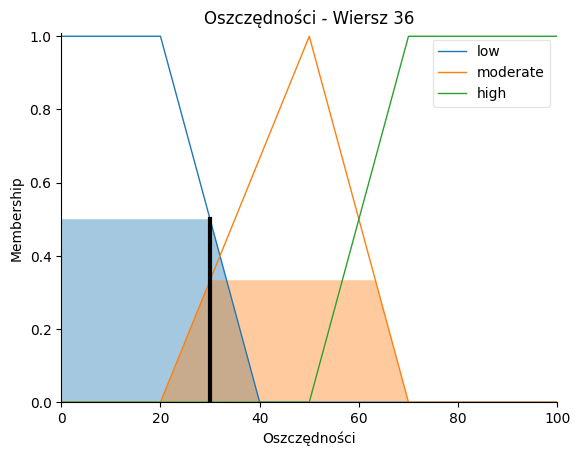

<Figure size 1000x600 with 0 Axes>

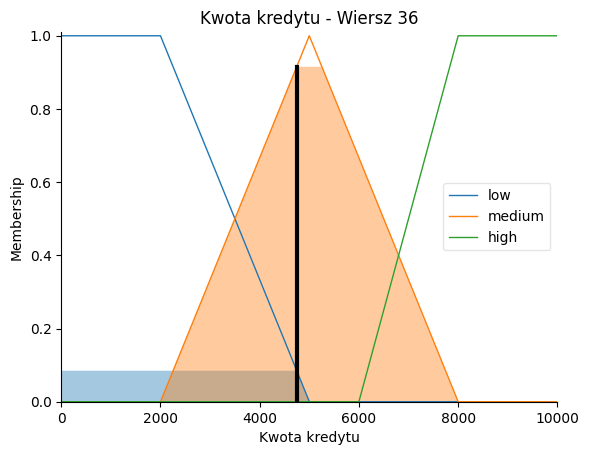

<Figure size 1000x600 with 0 Axes>

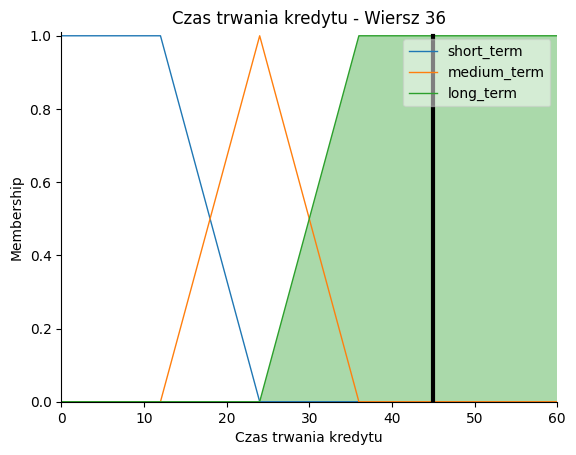

<Figure size 1000x600 with 0 Axes>

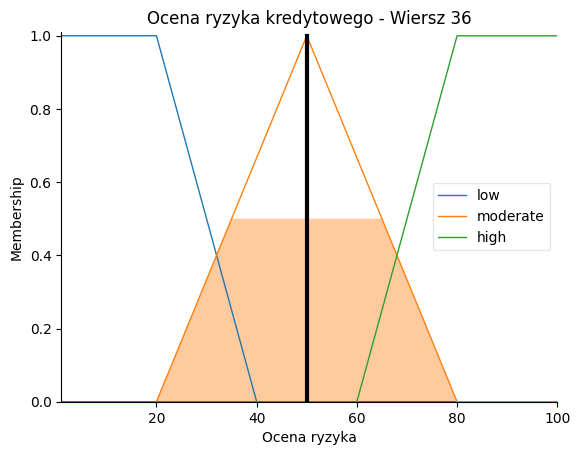

Wartości wejściowe:
Wiek: 31.0
Oszczędności: 30.0
Kwota kredytu: 6110.0
Czas trwania kredytu: 48.0
Wiersz 37:
Ocena ryzyka kredytowego = 52.23 [%]
  Przynależność (Membership):
  Wiek (31.0): young=0.40, middle_aged=0.24, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (6110.0): low=0.00, medium=0.63, high=0.06
  Czas trwania kredytu (48.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

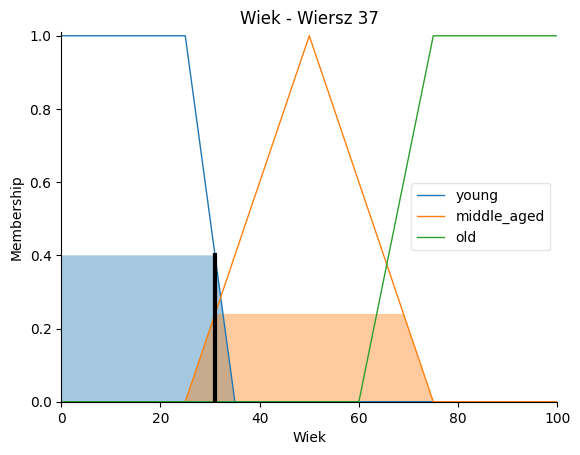

<Figure size 1000x600 with 0 Axes>

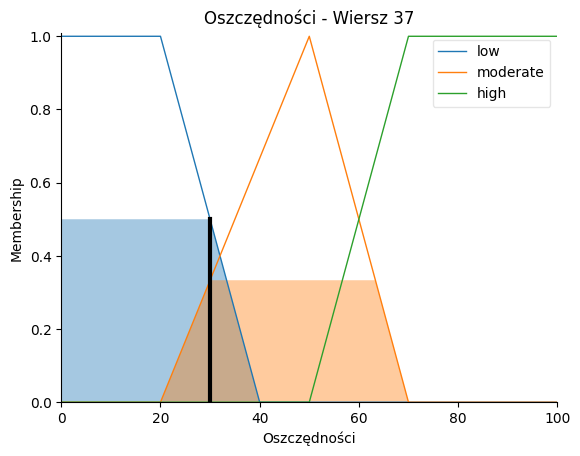

<Figure size 1000x600 with 0 Axes>

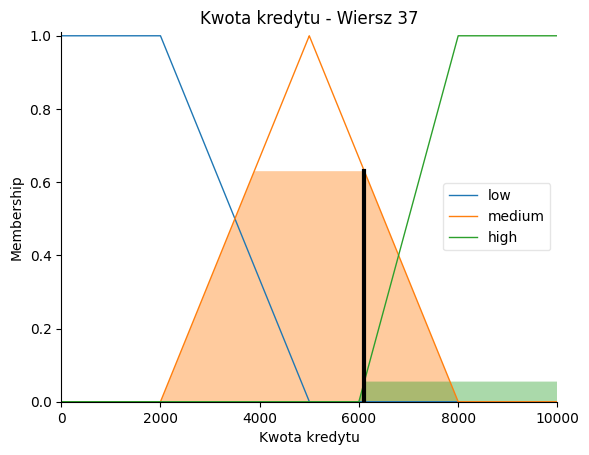

<Figure size 1000x600 with 0 Axes>

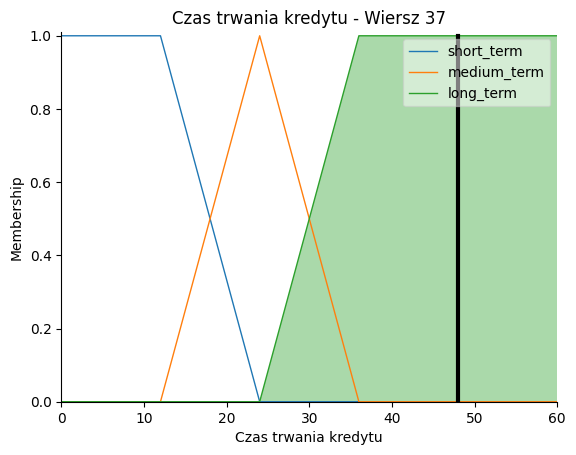

<Figure size 1000x600 with 0 Axes>

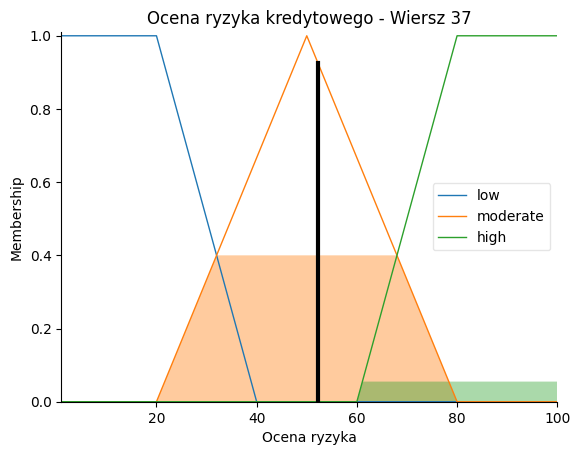

Wartości wejściowe:
Wiek: 37.0
Oszczędności: 30.0
Kwota kredytu: 2100.0
Czas trwania kredytu: 18.0
Wiersz 38:
Ocena ryzyka kredytowego = 37.04 [%]
  Przynależność (Membership):
  Wiek (37.0): young=0.00, middle_aged=0.48, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (2100.0): low=0.97, medium=0.03, high=0.00
  Czas trwania kredytu (18.0): short=0.50, medium=0.50, long=0.00



<Figure size 1000x600 with 0 Axes>

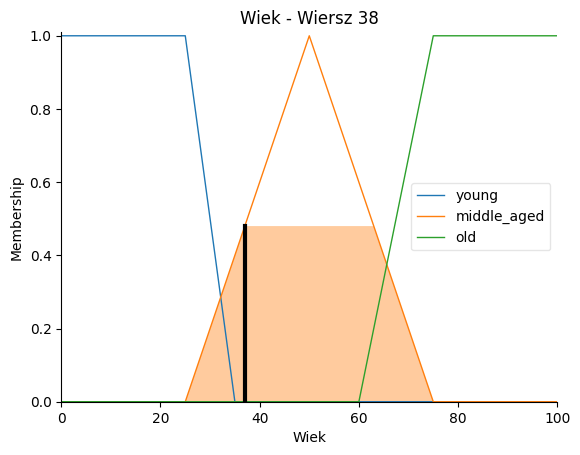

<Figure size 1000x600 with 0 Axes>

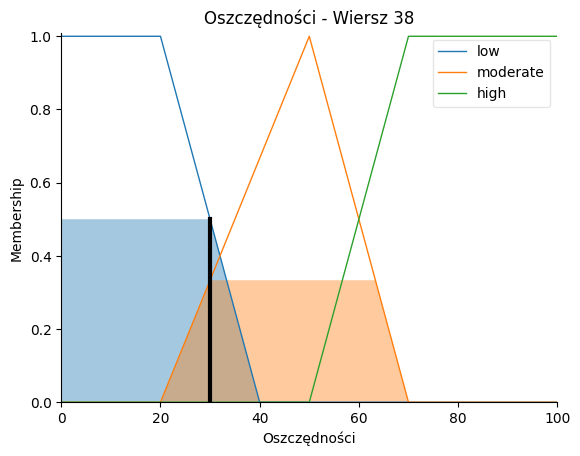

<Figure size 1000x600 with 0 Axes>

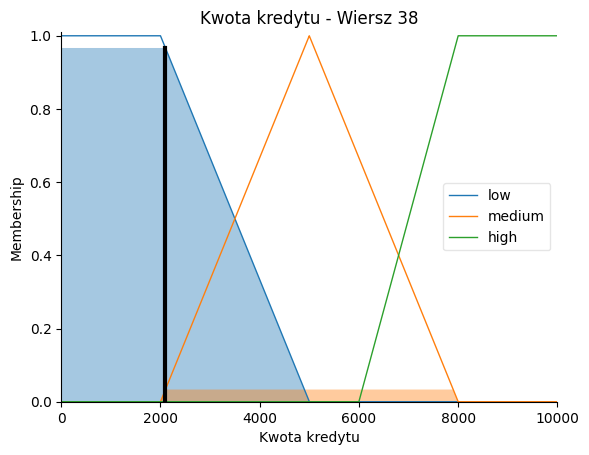

<Figure size 1000x600 with 0 Axes>

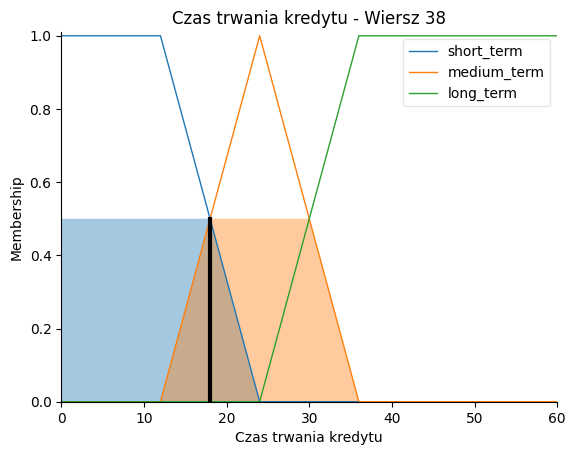

<Figure size 1000x600 with 0 Axes>

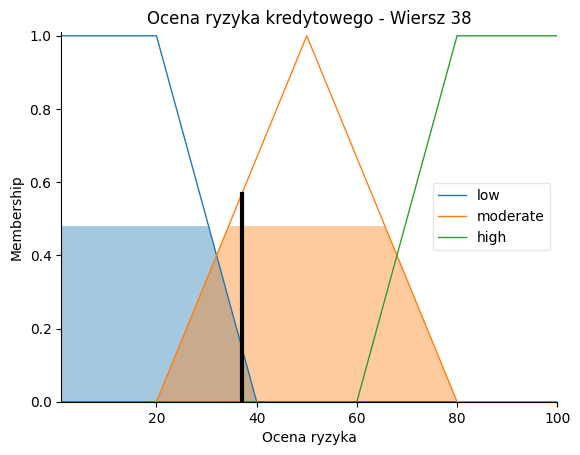

Wartości wejściowe:
Wiek: 37.0
Oszczędności: 30.0
Kwota kredytu: 1225.0
Czas trwania kredytu: 10.0
Wiersz 39:
Ocena ryzyka kredytowego = 18.21 [%]
  Przynależność (Membership):
  Wiek (37.0): young=0.00, middle_aged=0.48, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1225.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (10.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

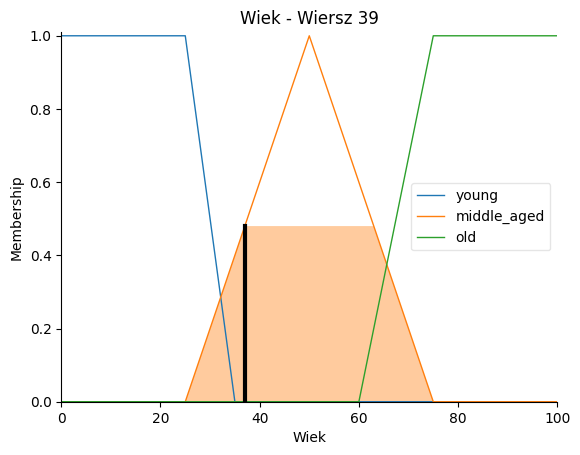

<Figure size 1000x600 with 0 Axes>

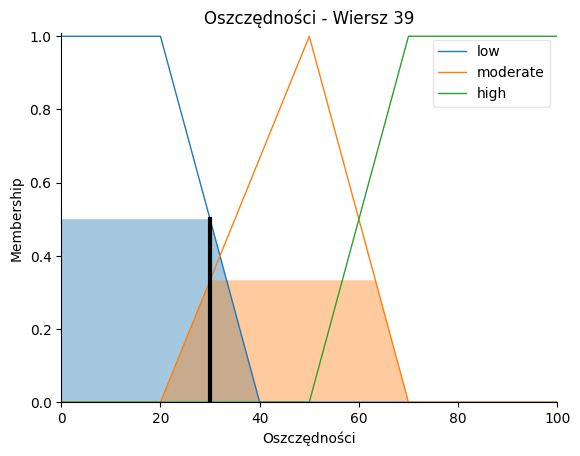

<Figure size 1000x600 with 0 Axes>

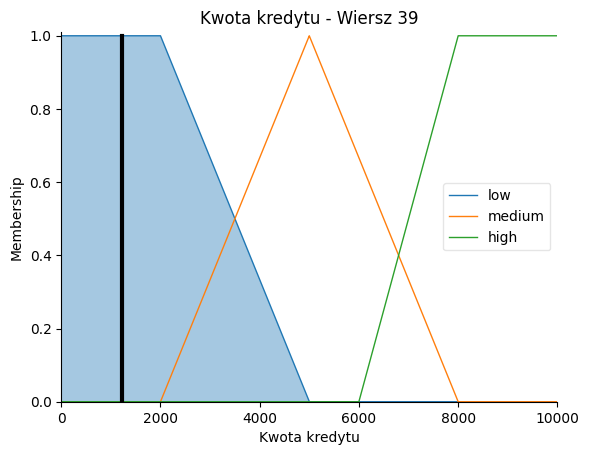

<Figure size 1000x600 with 0 Axes>

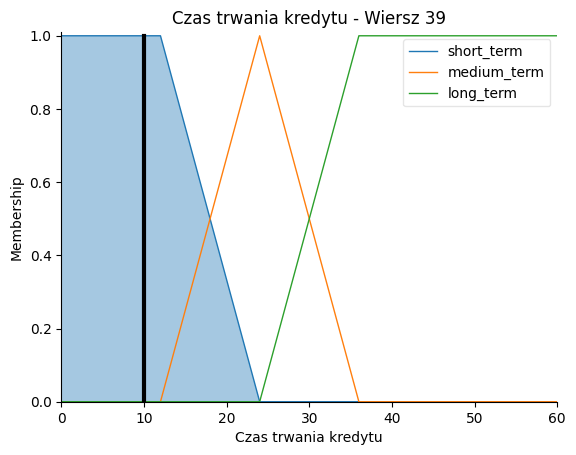

<Figure size 1000x600 with 0 Axes>

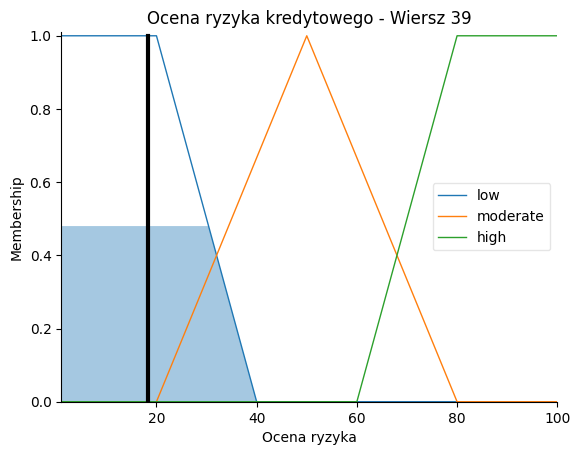

Wartości wejściowe:
Wiek: 24.0
Oszczędności: 30.0
Kwota kredytu: 458.0
Czas trwania kredytu: 9.0
Wiersz 40:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (24.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (458.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (9.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

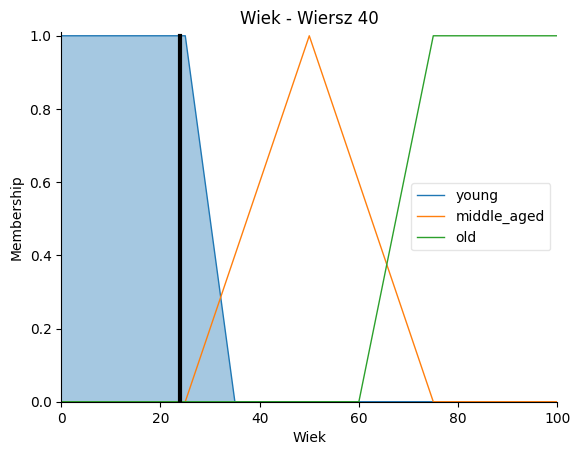

<Figure size 1000x600 with 0 Axes>

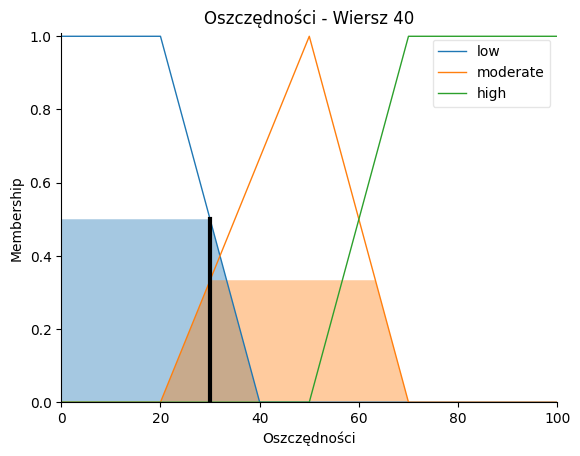

<Figure size 1000x600 with 0 Axes>

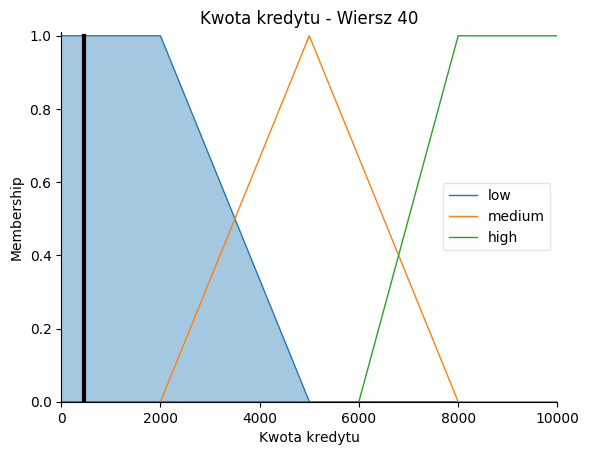

<Figure size 1000x600 with 0 Axes>

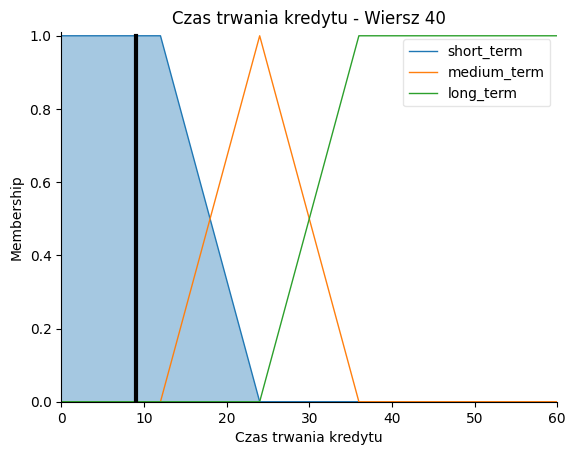

<Figure size 1000x600 with 0 Axes>

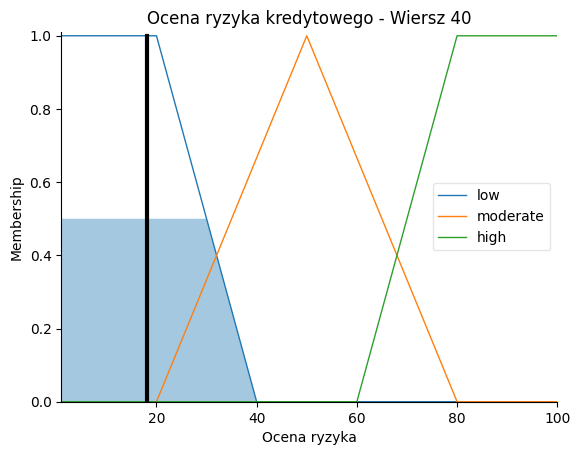

Wartości wejściowe:
Wiek: 30.0
Oszczędności: 90.0
Kwota kredytu: 2333.0
Czas trwania kredytu: 30.0
Wiersz 41:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (30.0): young=0.50, middle_aged=0.20, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (2333.0): low=0.89, medium=0.11, high=0.00
  Czas trwania kredytu (30.0): short=0.00, medium=0.50, long=0.50



<Figure size 1000x600 with 0 Axes>

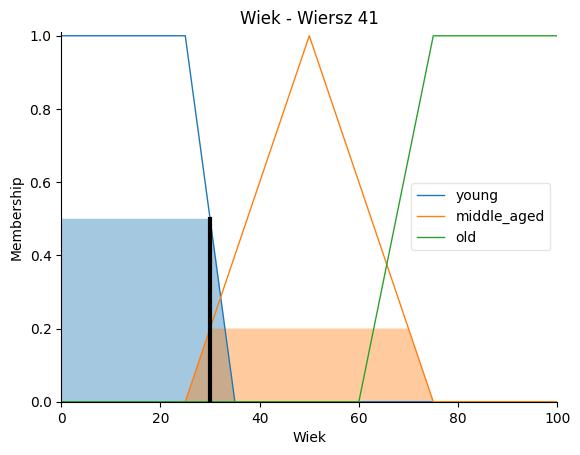

<Figure size 1000x600 with 0 Axes>

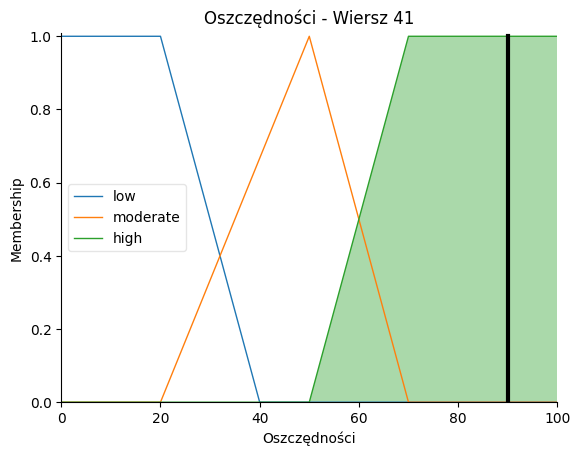

<Figure size 1000x600 with 0 Axes>

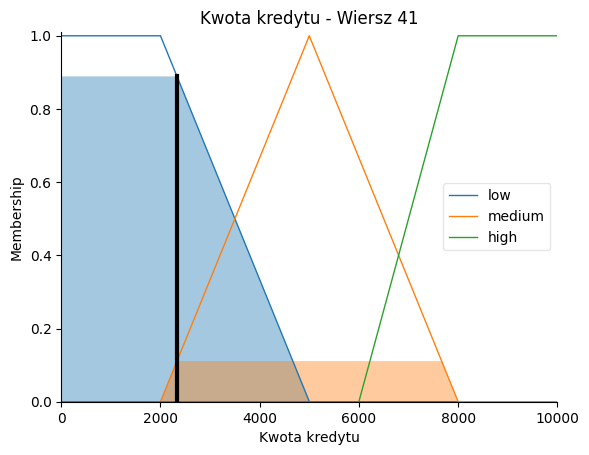

<Figure size 1000x600 with 0 Axes>

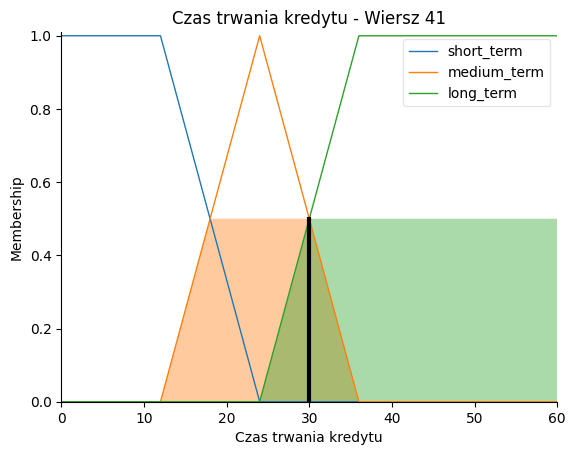

<Figure size 1000x600 with 0 Axes>

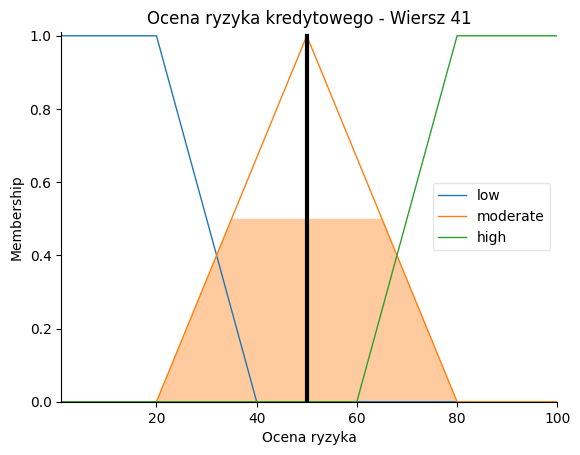

Wartości wejściowe:
Wiek: 26.0
Oszczędności: 90.0
Kwota kredytu: 1158.0
Czas trwania kredytu: 12.0
Wiersz 42:
Ocena ryzyka kredytowego = 16.45 [%]
  Przynależność (Membership):
  Wiek (26.0): young=0.90, middle_aged=0.04, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (1158.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

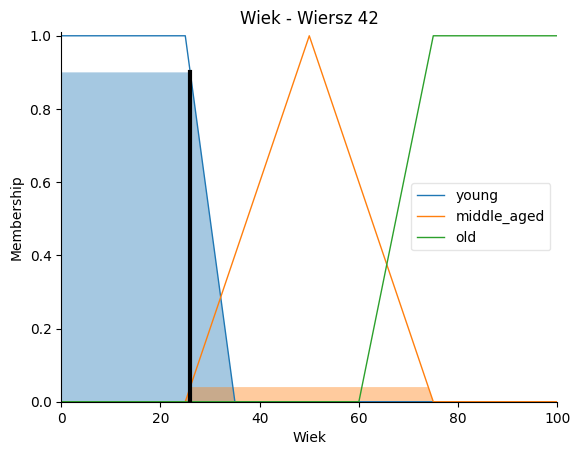

<Figure size 1000x600 with 0 Axes>

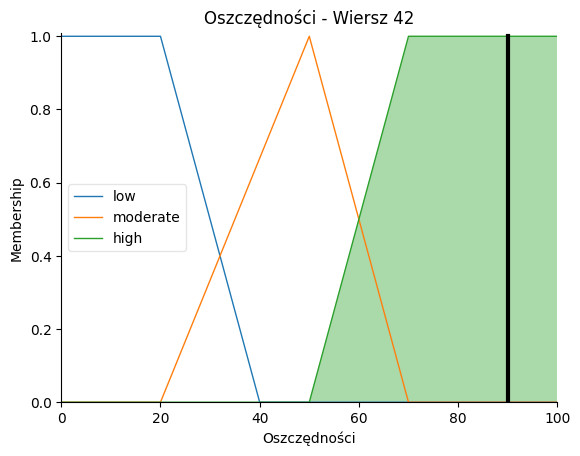

<Figure size 1000x600 with 0 Axes>

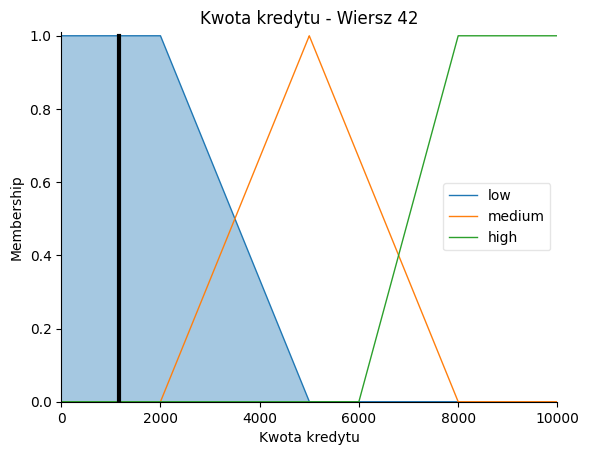

<Figure size 1000x600 with 0 Axes>

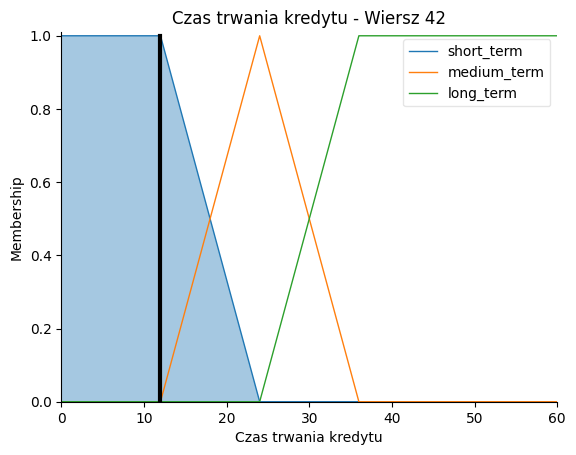

<Figure size 1000x600 with 0 Axes>

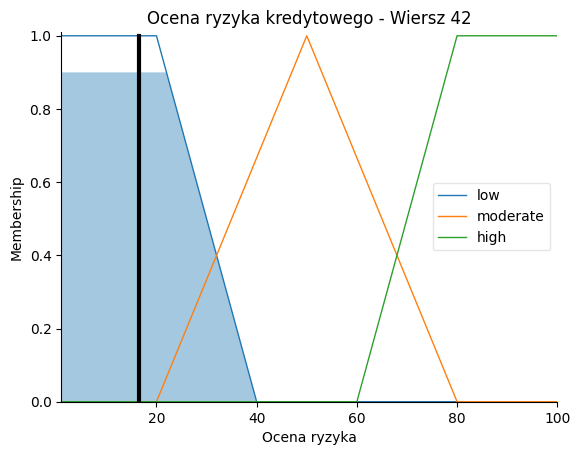

Wartości wejściowe:
Wiek: 44.0
Oszczędności: 30.0
Kwota kredytu: 6204.0
Czas trwania kredytu: 18.0
Wiersz 43:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (44.0): young=0.00, middle_aged=0.76, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (6204.0): low=0.00, medium=0.60, high=0.10
  Czas trwania kredytu (18.0): short=0.50, medium=0.50, long=0.00



<Figure size 1000x600 with 0 Axes>

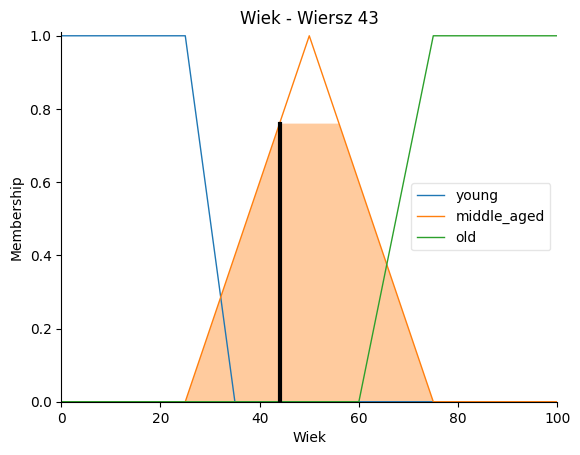

<Figure size 1000x600 with 0 Axes>

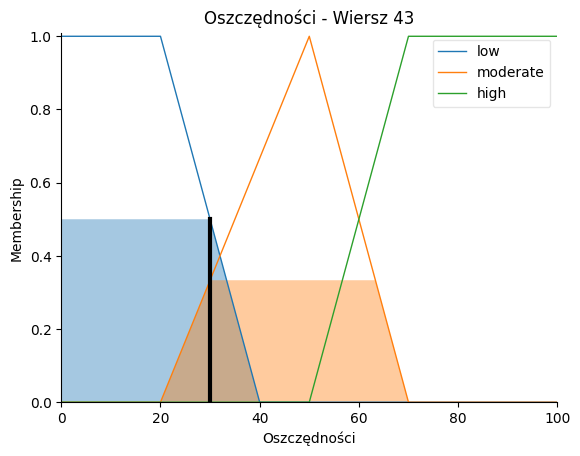

<Figure size 1000x600 with 0 Axes>

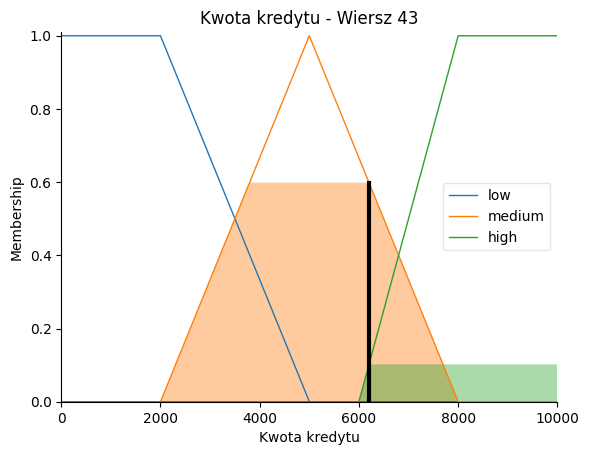

<Figure size 1000x600 with 0 Axes>

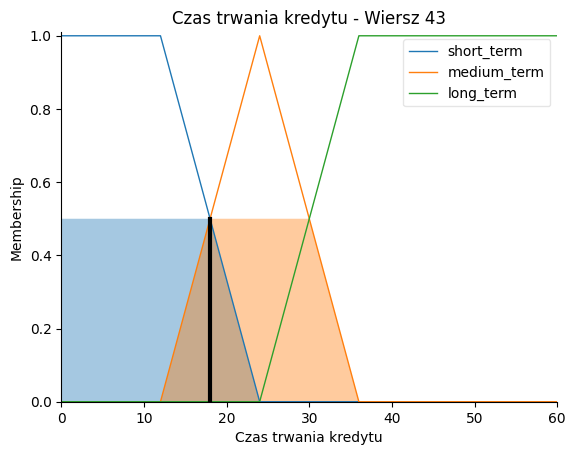

<Figure size 1000x600 with 0 Axes>

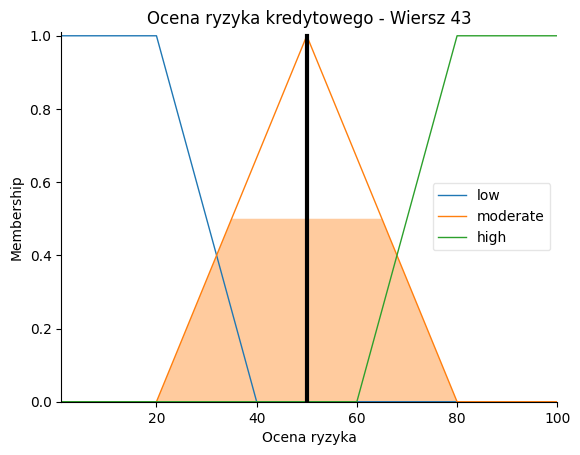

Wartości wejściowe:
Wiek: 24.0
Oszczędności: 50.0
Kwota kredytu: 6187.0
Czas trwania kredytu: 30.0
Wiersz 44:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (24.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (50.0): low=0.00, moderate=1.00, high=0.00
  Kwota kredytu (6187.0): low=0.00, medium=0.60, high=0.09
  Czas trwania kredytu (30.0): short=0.00, medium=0.50, long=0.50



<Figure size 1000x600 with 0 Axes>

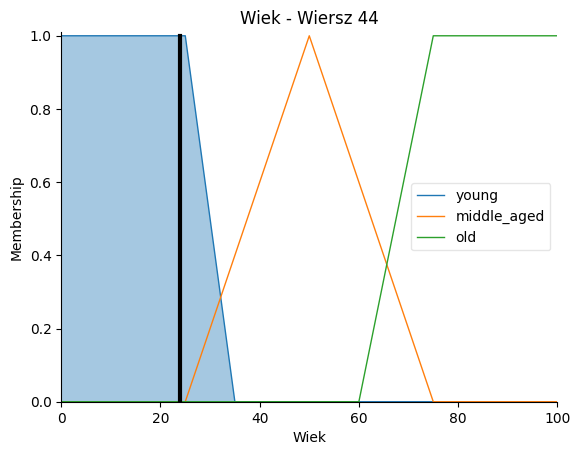

<Figure size 1000x600 with 0 Axes>

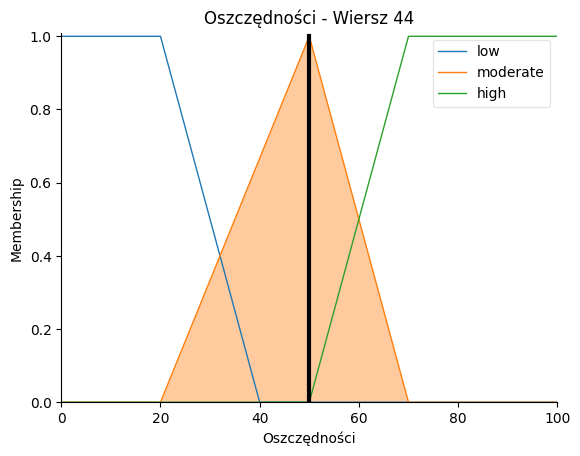

<Figure size 1000x600 with 0 Axes>

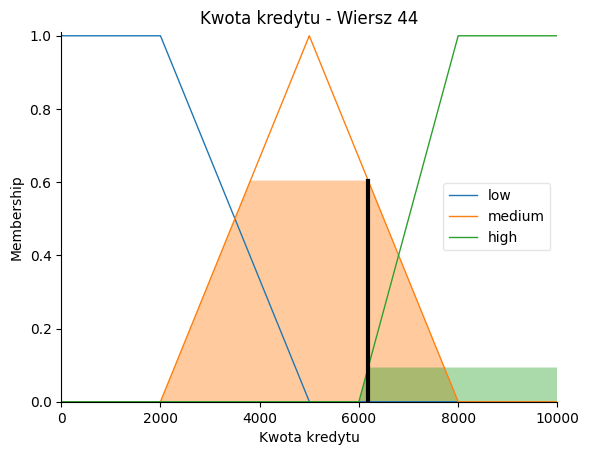

<Figure size 1000x600 with 0 Axes>

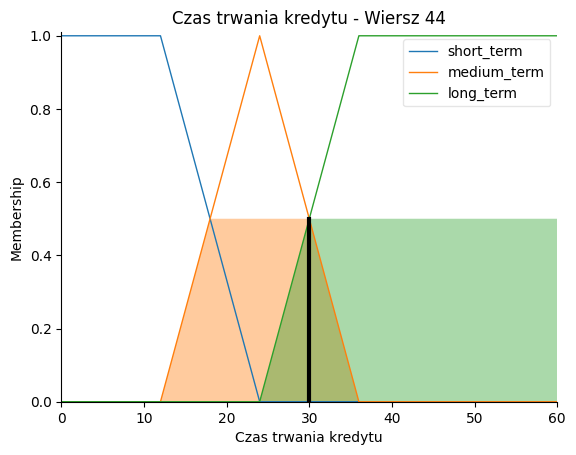

<Figure size 1000x600 with 0 Axes>

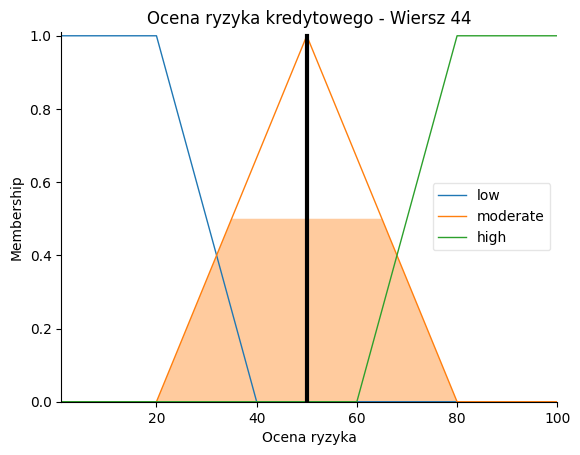

Wartości wejściowe:
Wiek: 58.0
Oszczędności: 30.0
Kwota kredytu: 6143.0
Czas trwania kredytu: 48.0
Wiersz 45:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (58.0): young=0.00, middle_aged=0.68, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (6143.0): low=0.00, medium=0.62, high=0.07
  Czas trwania kredytu (48.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

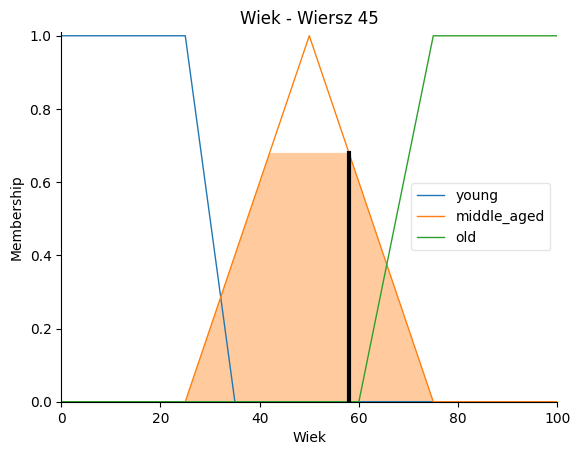

<Figure size 1000x600 with 0 Axes>

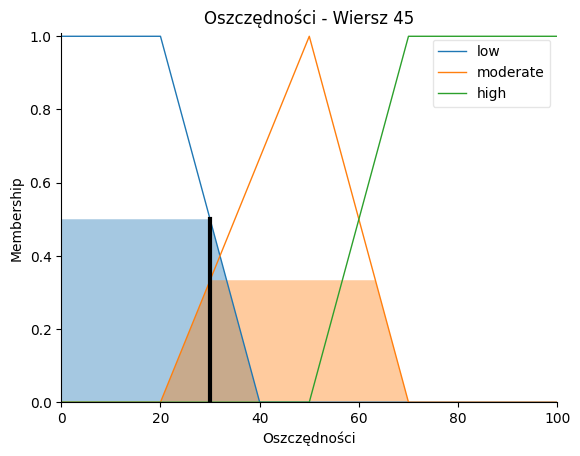

<Figure size 1000x600 with 0 Axes>

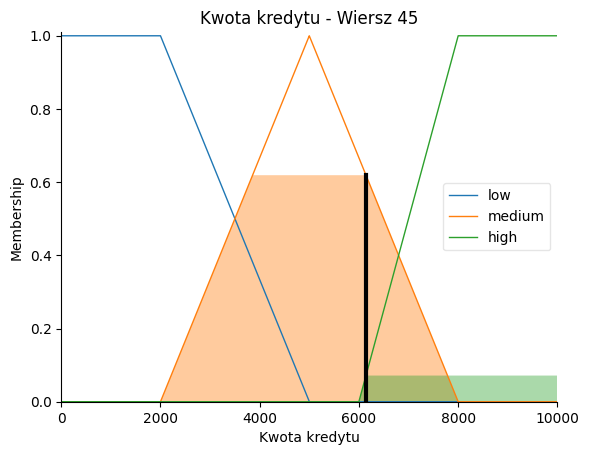

<Figure size 1000x600 with 0 Axes>

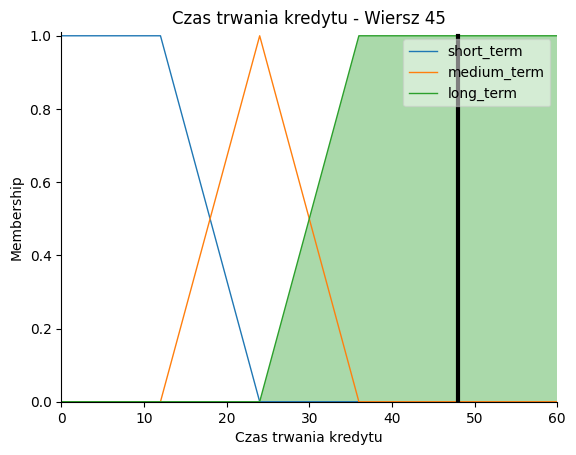

<Figure size 1000x600 with 0 Axes>

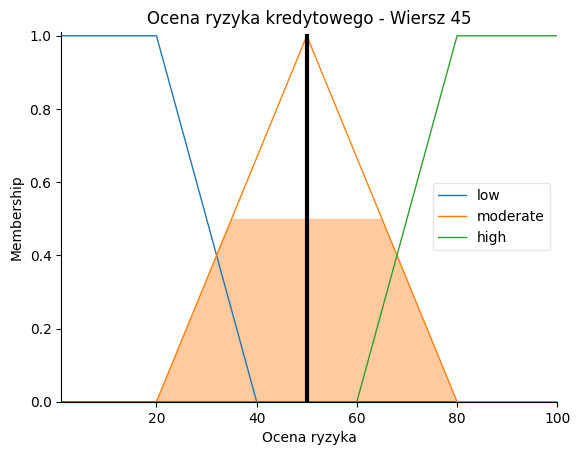

Wartości wejściowe:
Wiek: 35.0
Oszczędności: 30.0
Kwota kredytu: 1393.0
Czas trwania kredytu: 11.0
Wiersz 46:
Ocena ryzyka kredytowego = 18.58 [%]
  Przynależność (Membership):
  Wiek (35.0): young=0.00, middle_aged=0.40, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1393.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (11.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

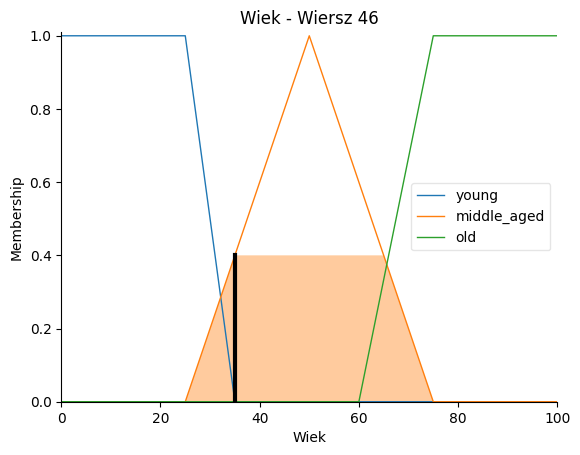

<Figure size 1000x600 with 0 Axes>

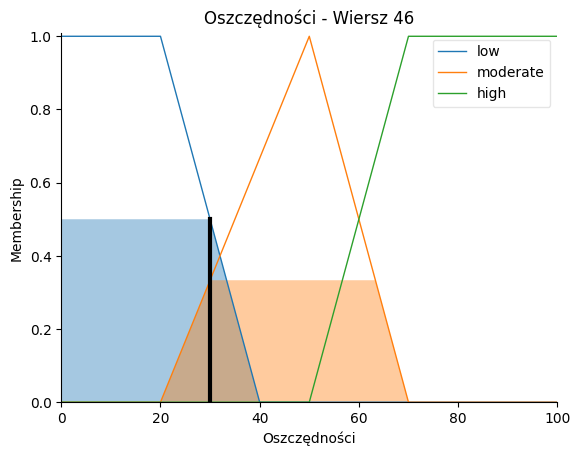

<Figure size 1000x600 with 0 Axes>

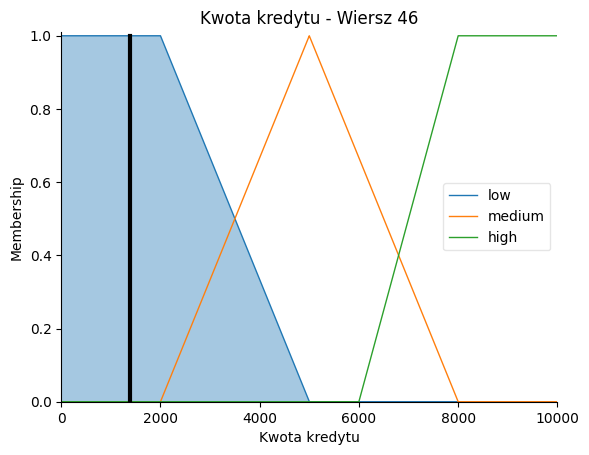

<Figure size 1000x600 with 0 Axes>

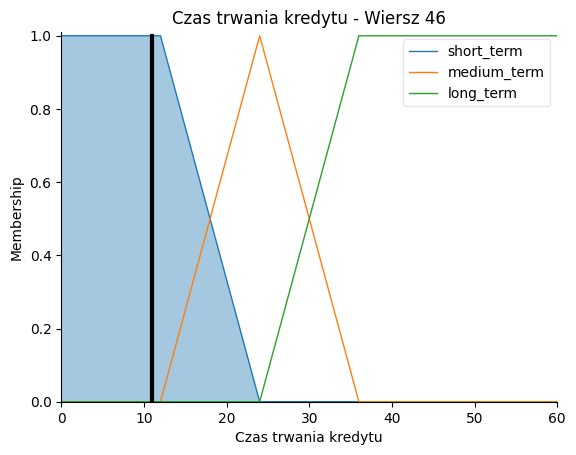

<Figure size 1000x600 with 0 Axes>

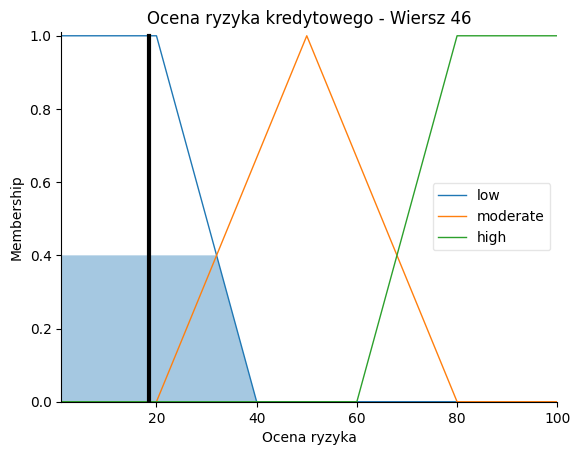

Wartości wejściowe:
Wiek: 39.0
Oszczędności: 90.0
Kwota kredytu: 2299.0
Czas trwania kredytu: 36.0
Wiersz 47:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (39.0): young=0.00, middle_aged=0.56, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (2299.0): low=0.90, medium=0.10, high=0.00
  Czas trwania kredytu (36.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

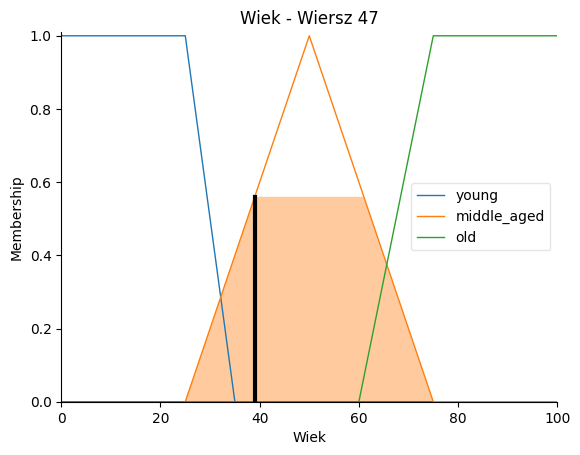

<Figure size 1000x600 with 0 Axes>

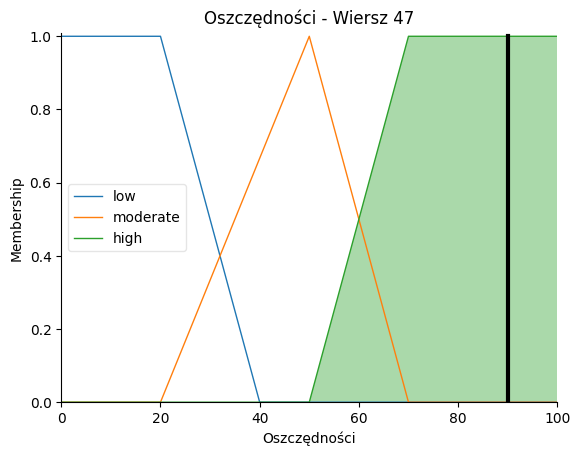

<Figure size 1000x600 with 0 Axes>

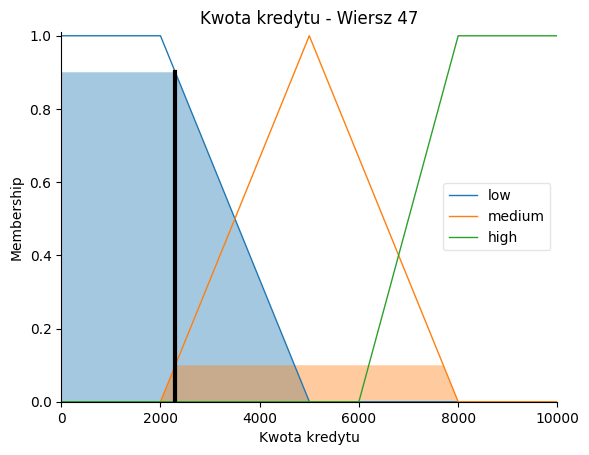

<Figure size 1000x600 with 0 Axes>

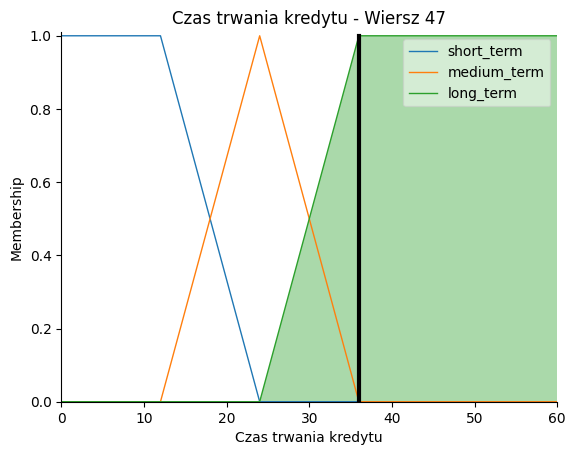

<Figure size 1000x600 with 0 Axes>

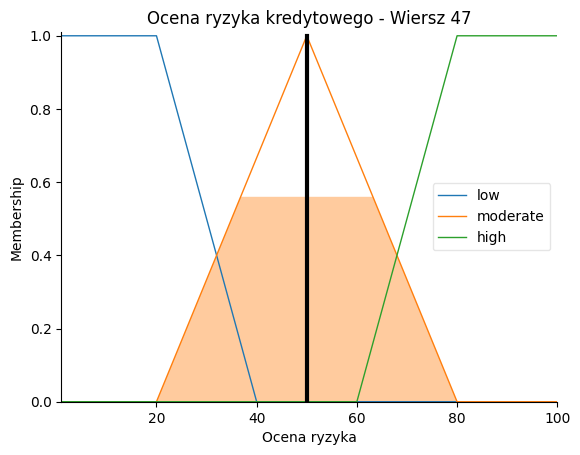

Wartości wejściowe:
Wiek: 23.0
Oszczędności: 90.0
Kwota kredytu: 1352.0
Czas trwania kredytu: 6.0
Wiersz 48:
Ocena ryzyka kredytowego = 16.07 [%]
  Przynależność (Membership):
  Wiek (23.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (1352.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (6.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

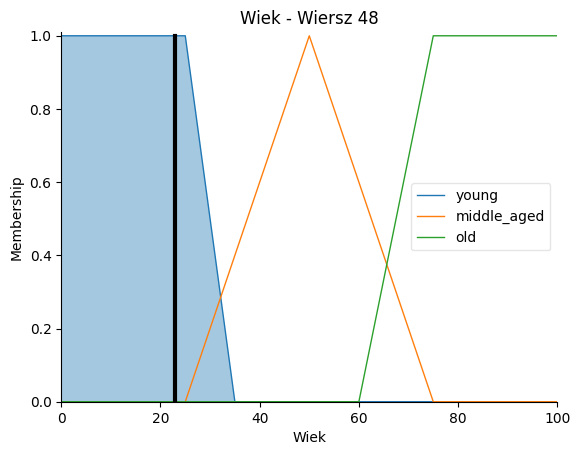

<Figure size 1000x600 with 0 Axes>

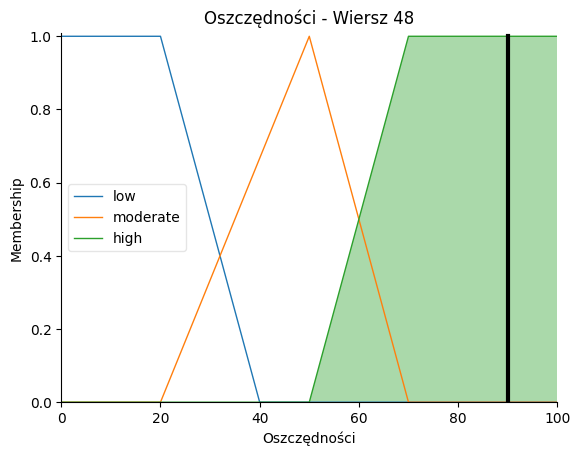

<Figure size 1000x600 with 0 Axes>

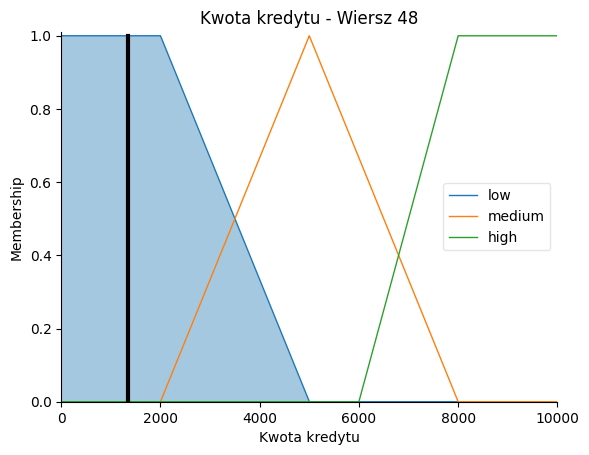

<Figure size 1000x600 with 0 Axes>

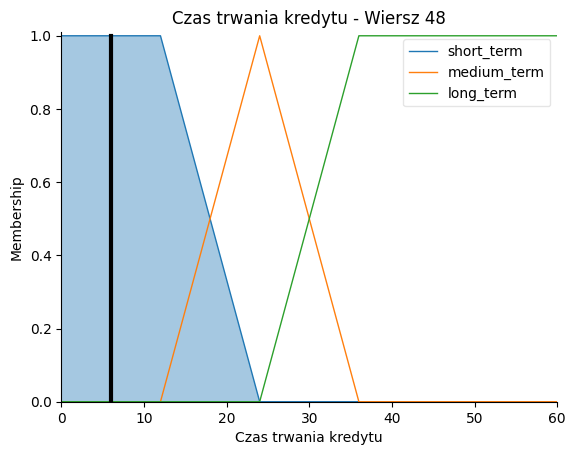

<Figure size 1000x600 with 0 Axes>

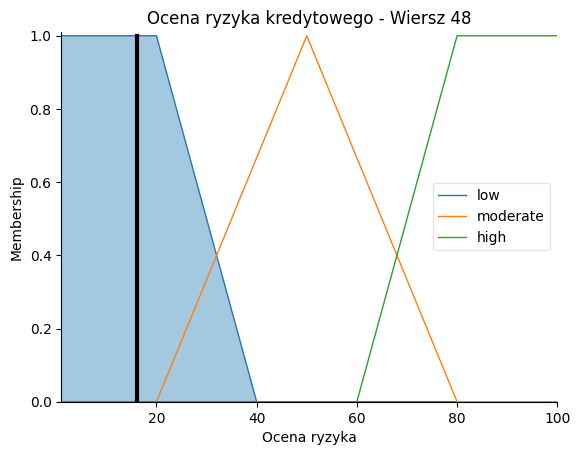

Wartości wejściowe:
Wiek: 39.0
Oszczędności: 30.0
Kwota kredytu: 7228.0
Czas trwania kredytu: 11.0
Wiersz 49:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (39.0): young=0.00, middle_aged=0.56, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (7228.0): low=0.00, medium=0.26, high=0.61
  Czas trwania kredytu (11.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

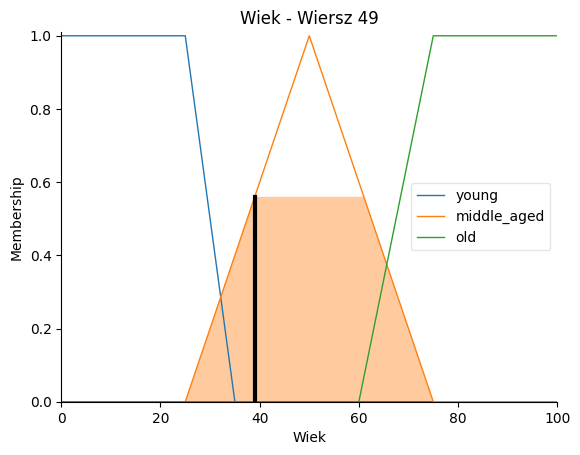

<Figure size 1000x600 with 0 Axes>

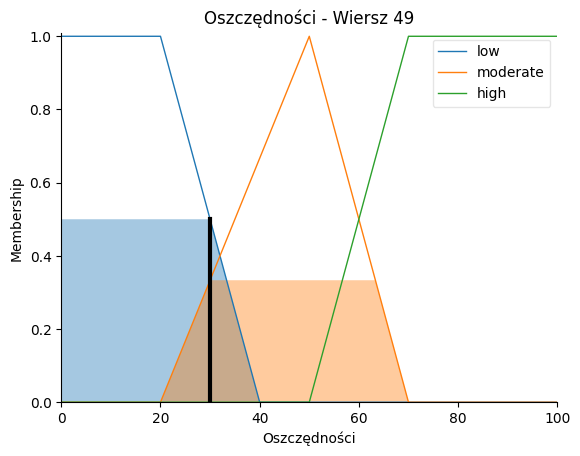

<Figure size 1000x600 with 0 Axes>

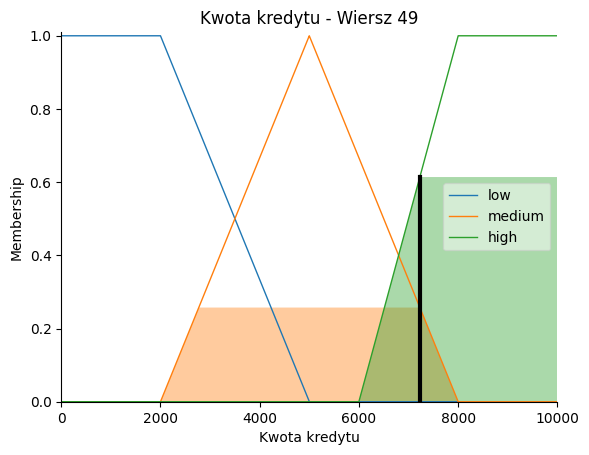

<Figure size 1000x600 with 0 Axes>

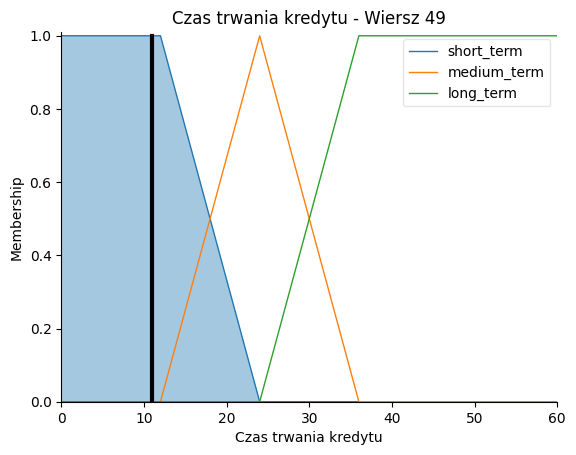

<Figure size 1000x600 with 0 Axes>

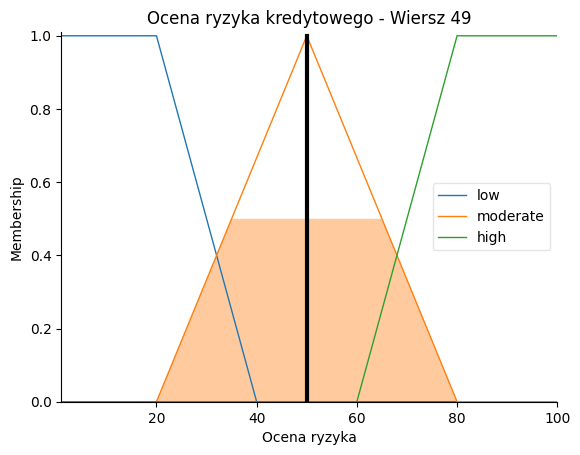

Wartości wejściowe:
Wiek: 28.0
Oszczędności: 50.0
Kwota kredytu: 2073.0
Czas trwania kredytu: 12.0
Wiersz 50:
Ocena ryzyka kredytowego = 19.02 [%]
  Przynależność (Membership):
  Wiek (28.0): young=0.70, middle_aged=0.12, old=0.00
  Oszczędności (50.0): low=0.00, moderate=1.00, high=0.00
  Kwota kredytu (2073.0): low=0.98, medium=0.02, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

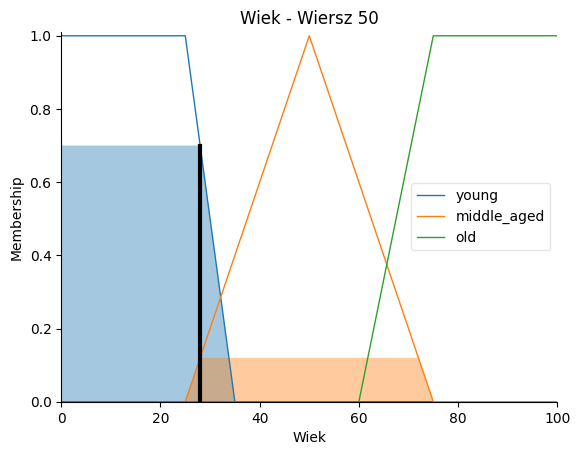

<Figure size 1000x600 with 0 Axes>

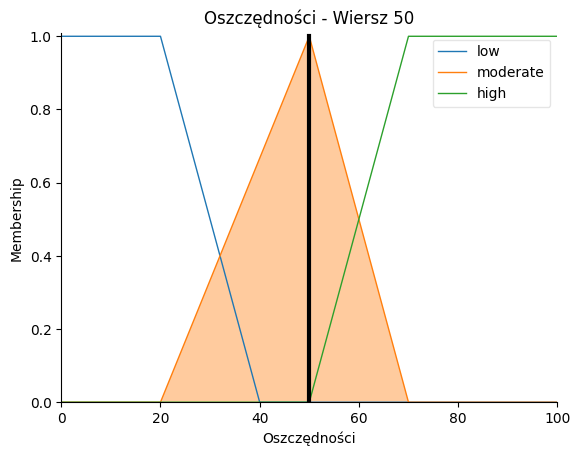

<Figure size 1000x600 with 0 Axes>

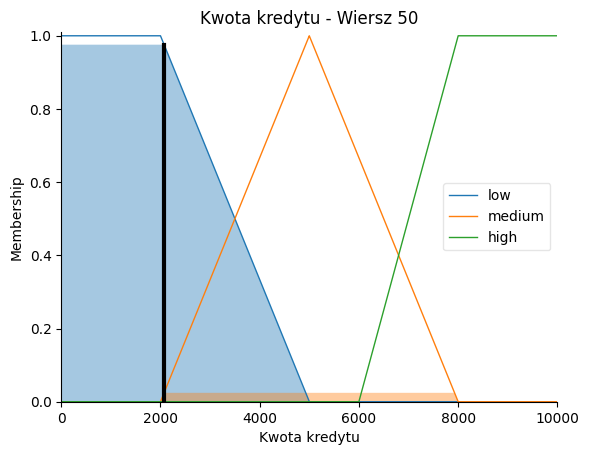

<Figure size 1000x600 with 0 Axes>

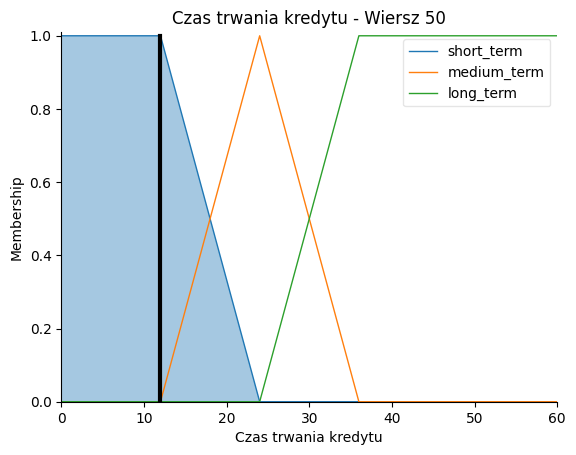

<Figure size 1000x600 with 0 Axes>

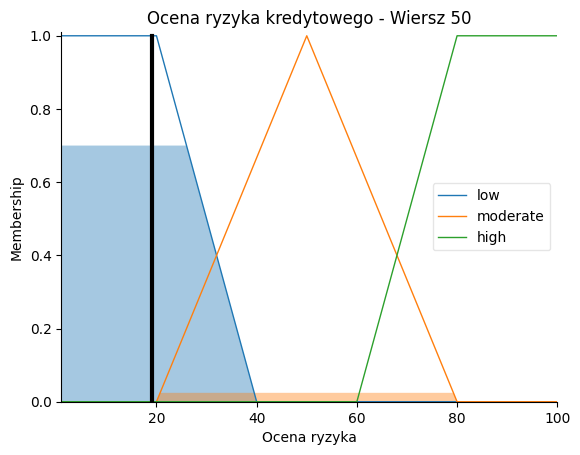

Wartości wejściowe:
Wiek: 30.0
Oszczędności: 30.0
Kwota kredytu: 5965.0
Czas trwania kredytu: 27.0
Wiersz 52:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (30.0): young=0.50, middle_aged=0.20, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (5965.0): low=0.00, medium=0.68, high=0.00
  Czas trwania kredytu (27.0): short=0.00, medium=0.75, long=0.25



<Figure size 1000x600 with 0 Axes>

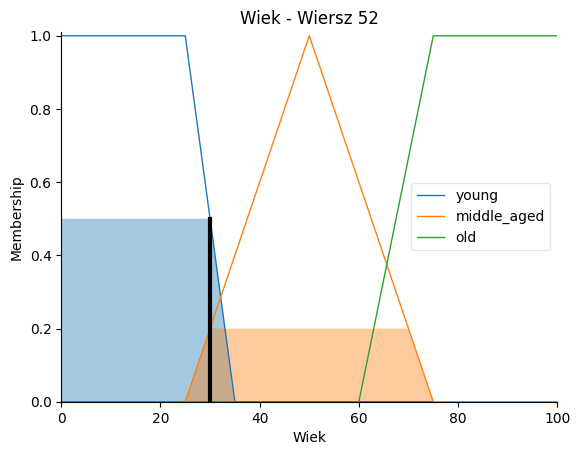

<Figure size 1000x600 with 0 Axes>

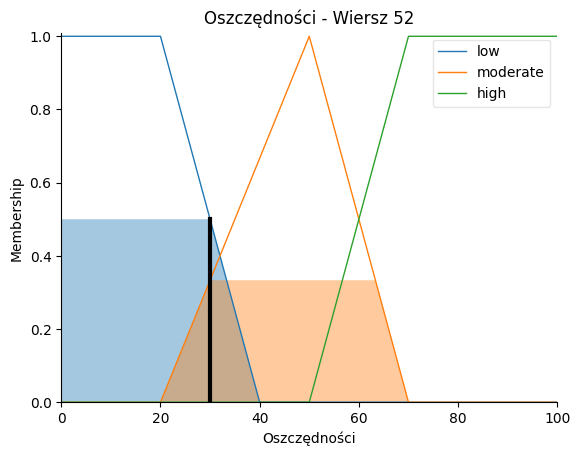

<Figure size 1000x600 with 0 Axes>

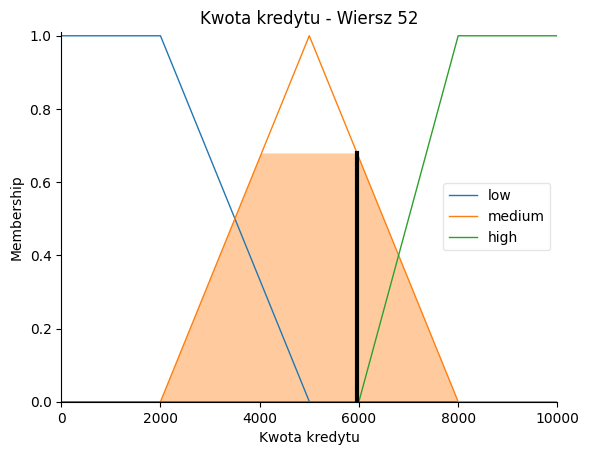

<Figure size 1000x600 with 0 Axes>

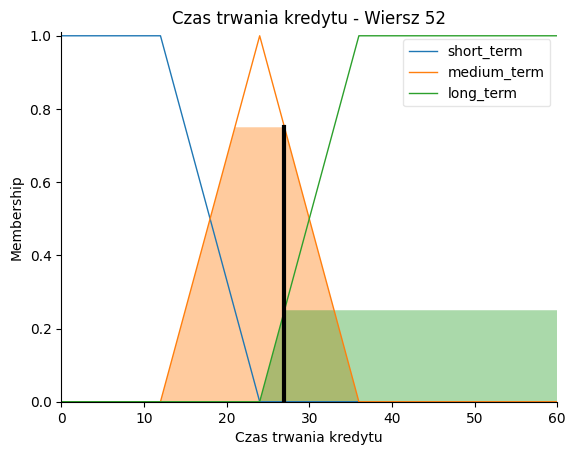

<Figure size 1000x600 with 0 Axes>

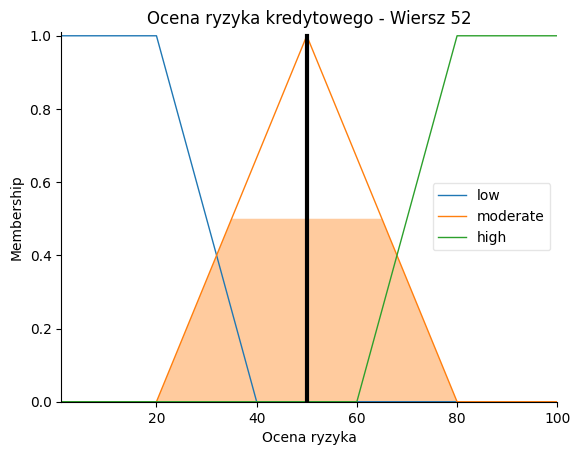

Wartości wejściowe:
Wiek: 25.0
Oszczędności: 30.0
Kwota kredytu: 1262.0
Czas trwania kredytu: 12.0
Wiersz 53:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (25.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1262.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

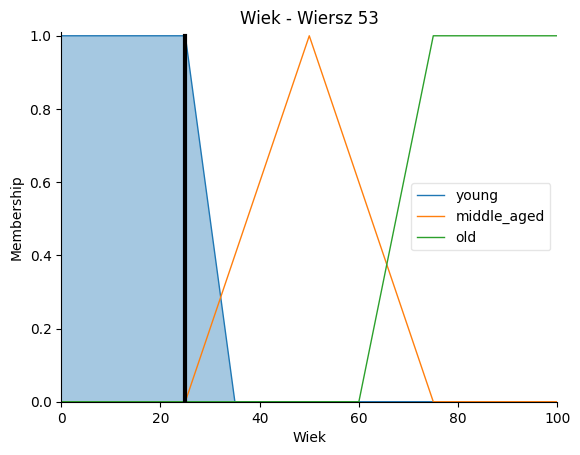

<Figure size 1000x600 with 0 Axes>

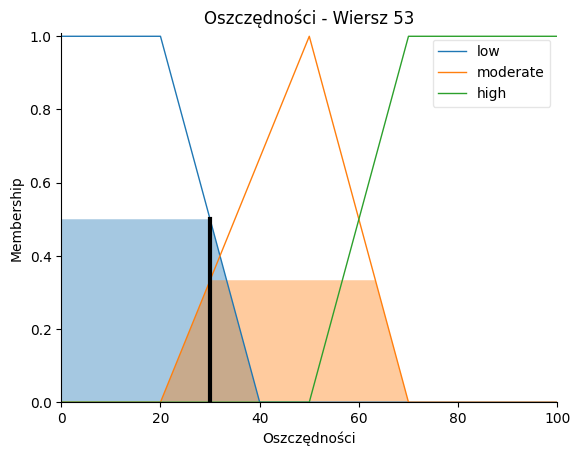

<Figure size 1000x600 with 0 Axes>

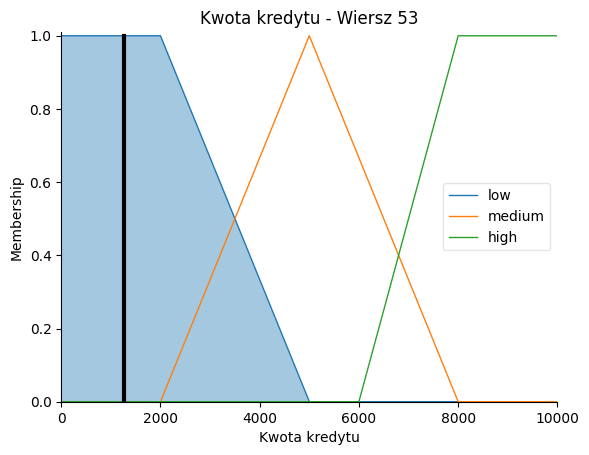

<Figure size 1000x600 with 0 Axes>

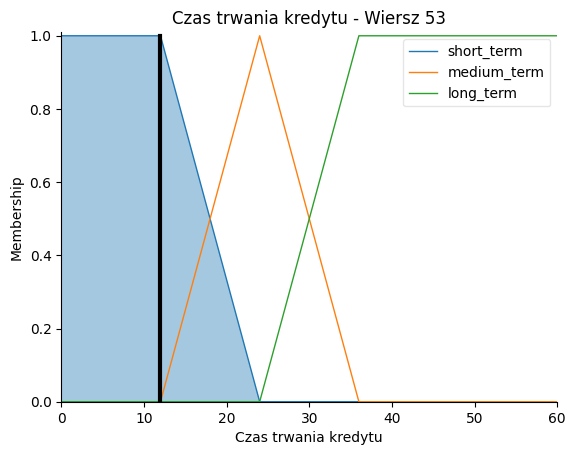

<Figure size 1000x600 with 0 Axes>

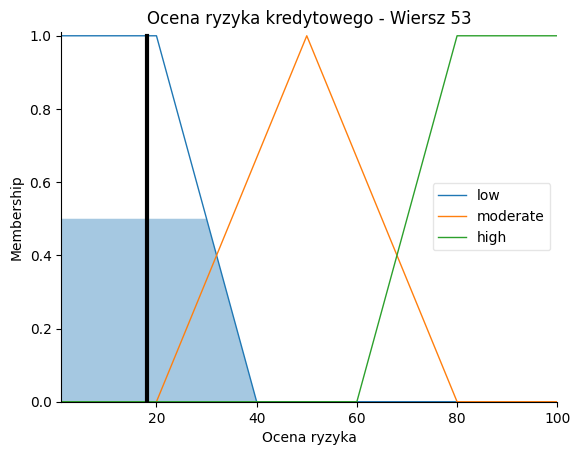

Wartości wejściowe:
Wiek: 57.0
Oszczędności: 30.0
Kwota kredytu: 2225.0
Czas trwania kredytu: 36.0
Wiersz 55:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (57.0): young=0.00, middle_aged=0.72, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (2225.0): low=0.93, medium=0.07, high=0.00
  Czas trwania kredytu (36.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

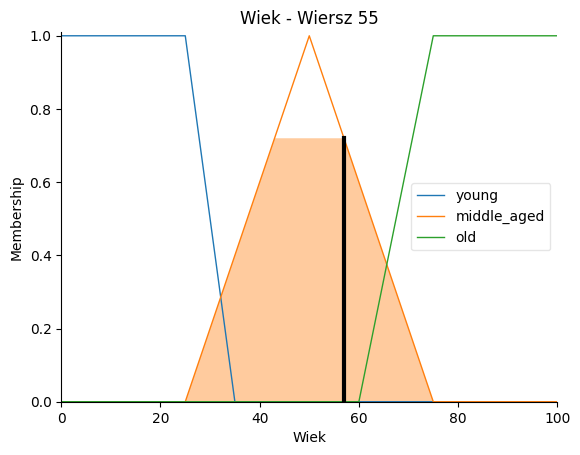

<Figure size 1000x600 with 0 Axes>

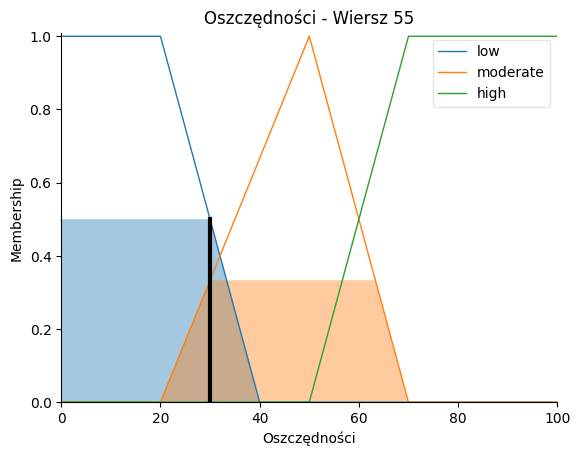

<Figure size 1000x600 with 0 Axes>

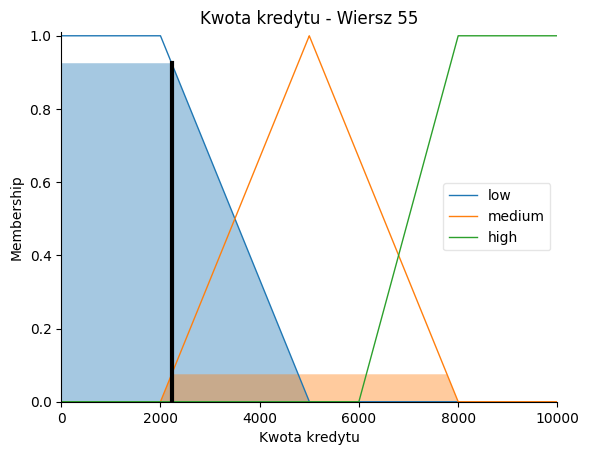

<Figure size 1000x600 with 0 Axes>

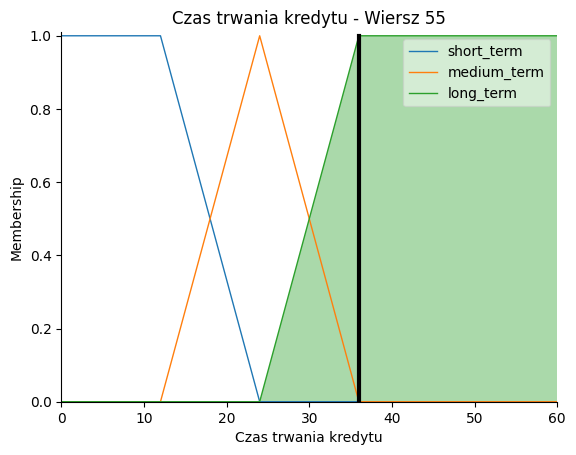

<Figure size 1000x600 with 0 Axes>

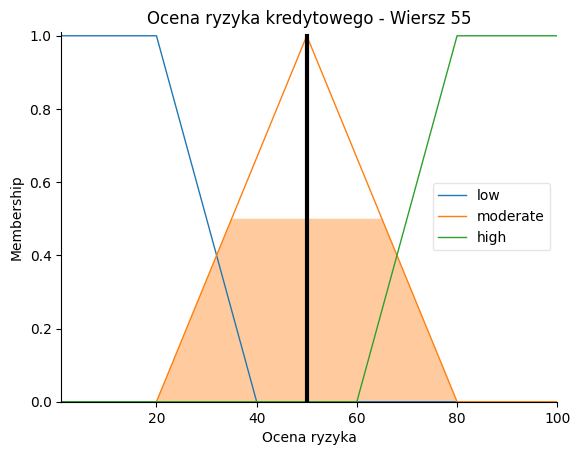

Wartości wejściowe:
Wiek: 31.0
Oszczędności: 30.0
Kwota kredytu: 9566.0
Czas trwania kredytu: 36.0
Wiersz 58:
Ocena ryzyka kredytowego = 64.15 [%]
  Przynależność (Membership):
  Wiek (31.0): young=0.40, middle_aged=0.24, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (9566.0): low=0.00, medium=0.00, high=1.00
  Czas trwania kredytu (36.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

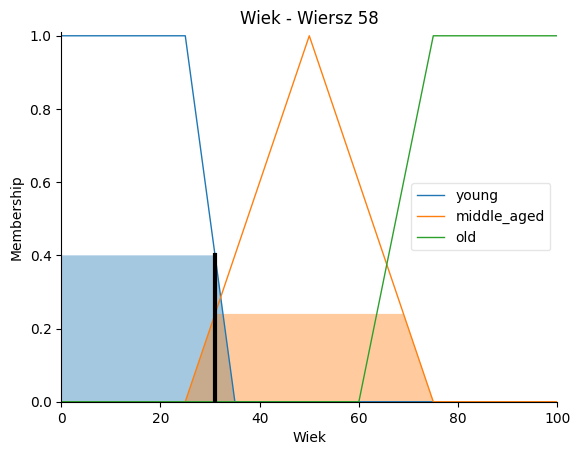

<Figure size 1000x600 with 0 Axes>

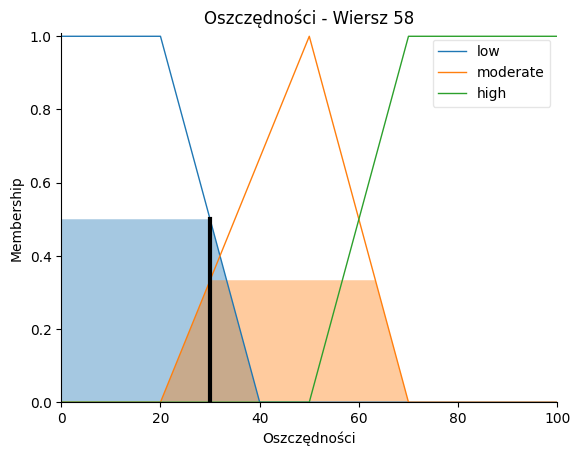

<Figure size 1000x600 with 0 Axes>

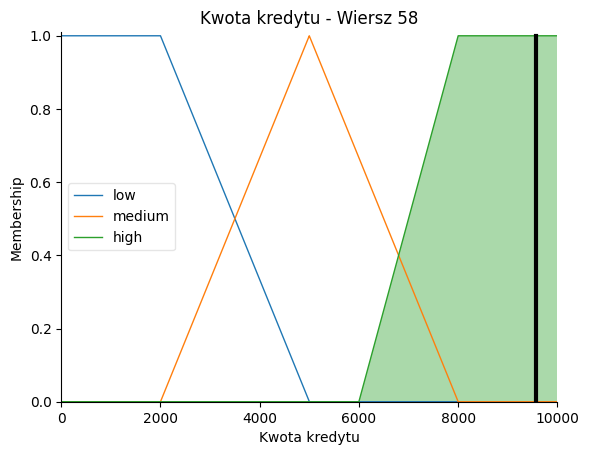

<Figure size 1000x600 with 0 Axes>

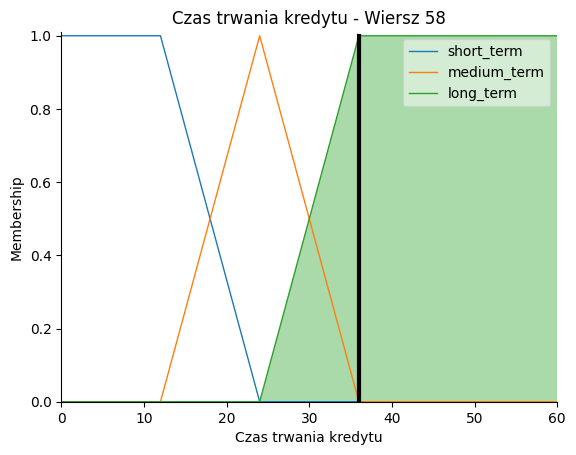

<Figure size 1000x600 with 0 Axes>

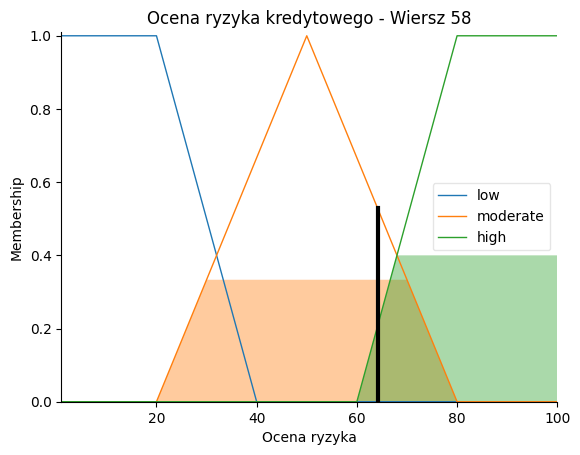

Wartości wejściowe:
Wiek: 23.0
Oszczędności: 30.0
Kwota kredytu: 1961.0
Czas trwania kredytu: 18.0
Wiersz 59:
Ocena ryzyka kredytowego = 36.91 [%]
  Przynależność (Membership):
  Wiek (23.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1961.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (18.0): short=0.50, medium=0.50, long=0.00



<Figure size 1000x600 with 0 Axes>

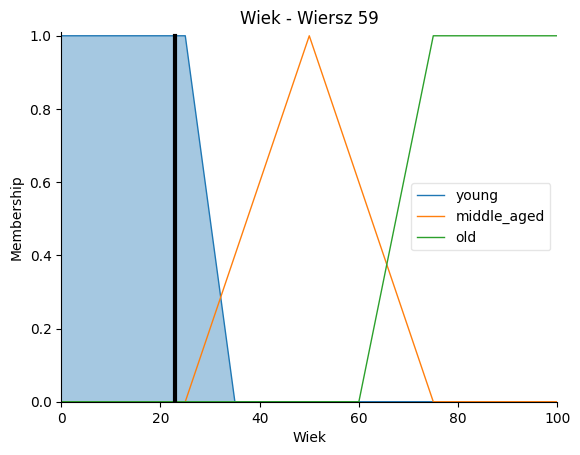

<Figure size 1000x600 with 0 Axes>

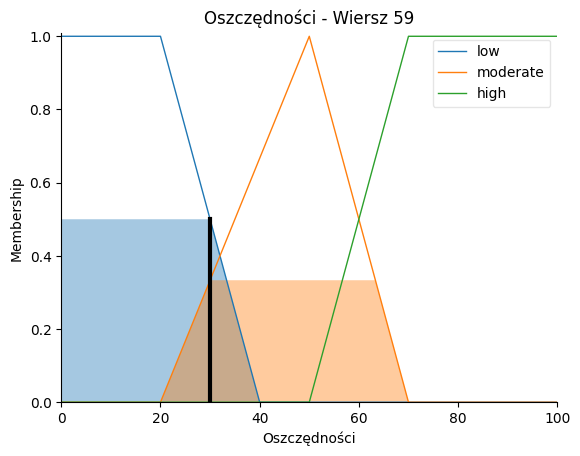

<Figure size 1000x600 with 0 Axes>

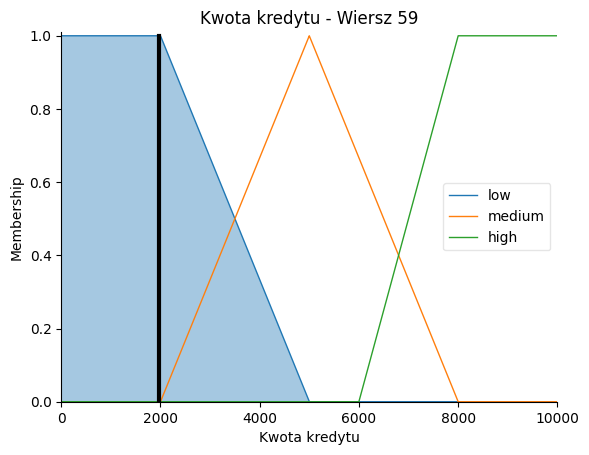

<Figure size 1000x600 with 0 Axes>

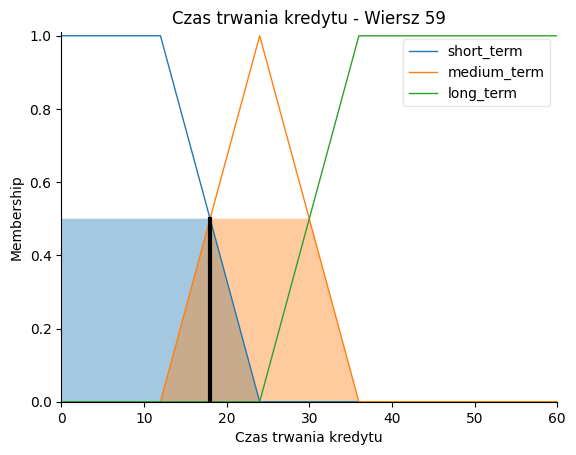

<Figure size 1000x600 with 0 Axes>

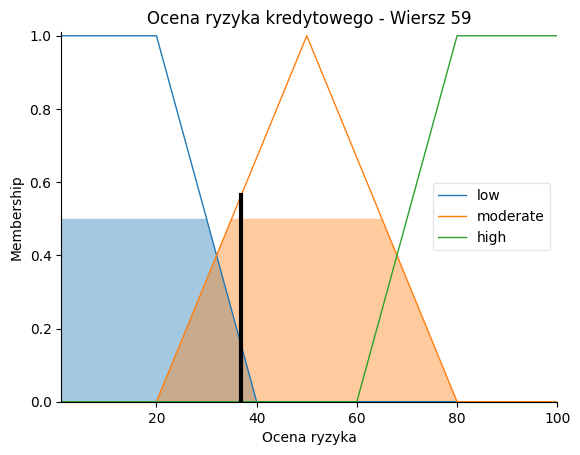

Wartości wejściowe:
Wiek: 23.0
Oszczędności: 30.0
Kwota kredytu: 6229.0
Czas trwania kredytu: 36.0
Wiersz 60:
Ocena ryzyka kredytowego = 53.90 [%]
  Przynależność (Membership):
  Wiek (23.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (6229.0): low=0.00, medium=0.59, high=0.11
  Czas trwania kredytu (36.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

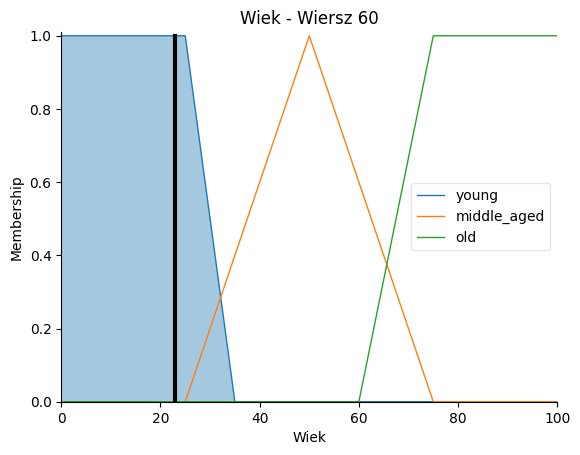

<Figure size 1000x600 with 0 Axes>

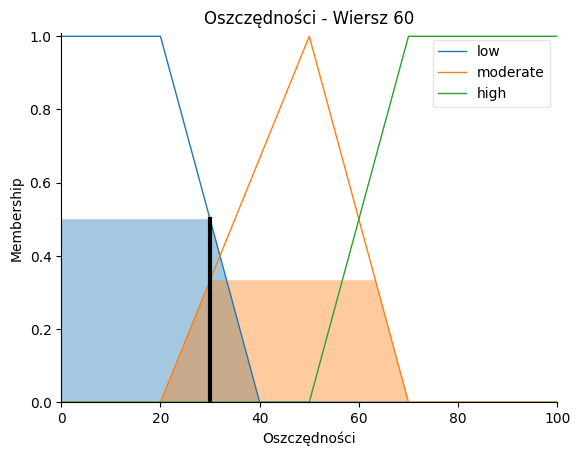

<Figure size 1000x600 with 0 Axes>

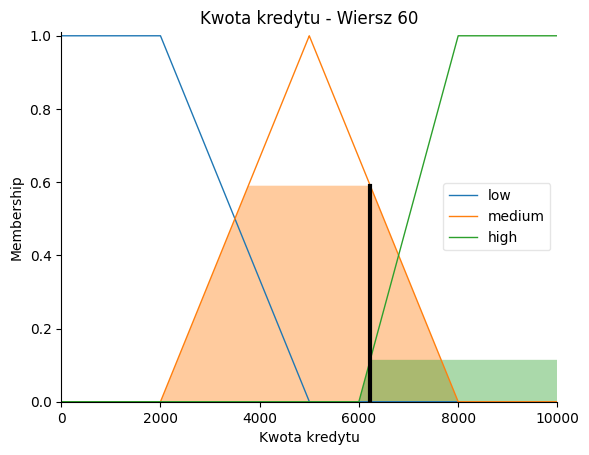

<Figure size 1000x600 with 0 Axes>

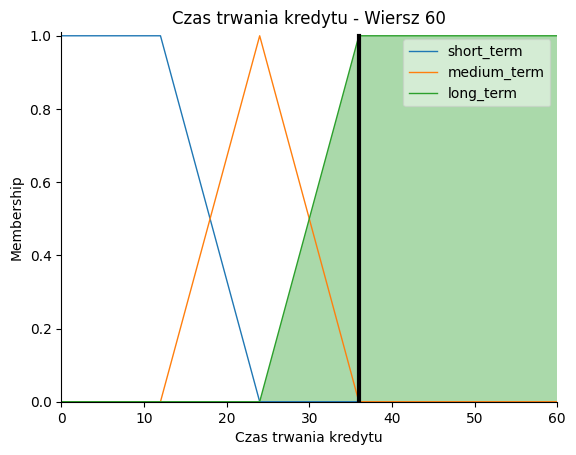

<Figure size 1000x600 with 0 Axes>

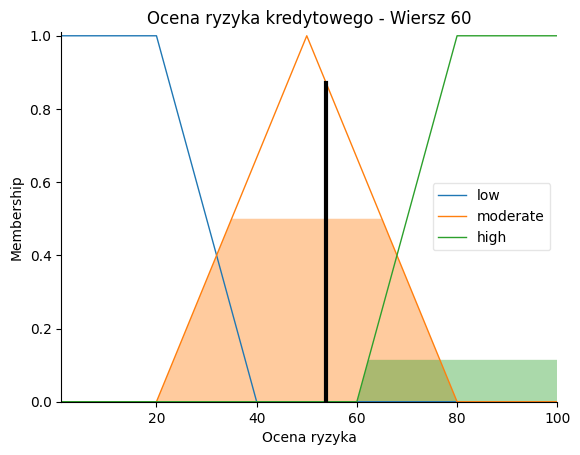

Wartości wejściowe:
Wiek: 27.0
Oszczędności: 30.0
Kwota kredytu: 1391.0
Czas trwania kredytu: 9.0
Wiersz 61:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (27.0): young=0.80, middle_aged=0.08, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1391.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (9.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

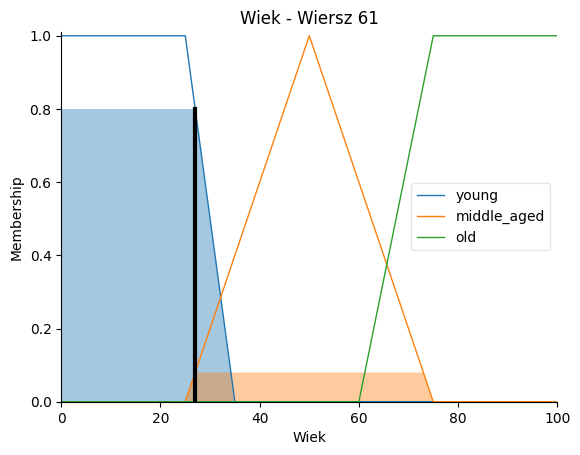

<Figure size 1000x600 with 0 Axes>

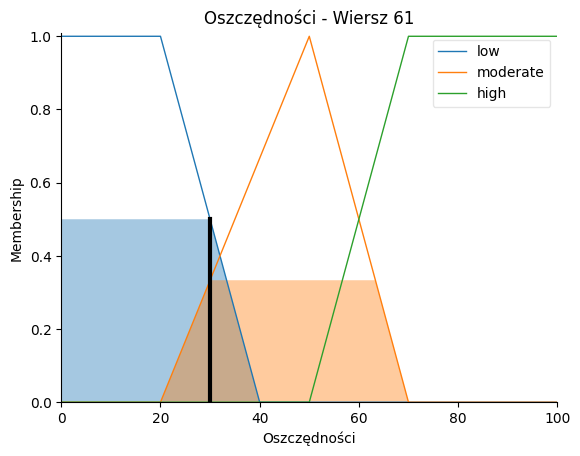

<Figure size 1000x600 with 0 Axes>

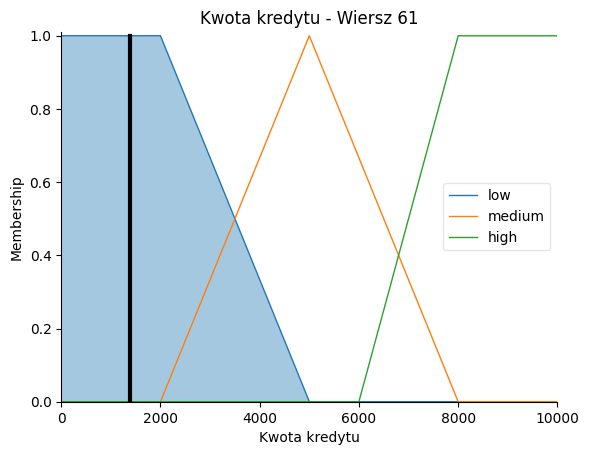

<Figure size 1000x600 with 0 Axes>

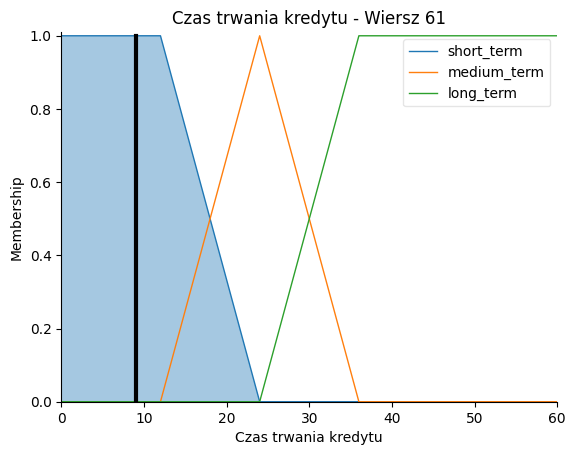

<Figure size 1000x600 with 0 Axes>

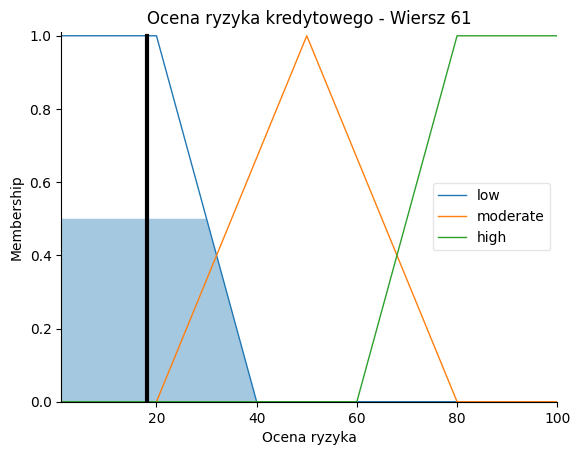

Wartości wejściowe:
Wiek: 61.0
Oszczędności: 30.0
Kwota kredytu: 1953.0
Czas trwania kredytu: 36.0
Wiersz 63:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (61.0): young=0.00, middle_aged=0.56, old=0.07
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1953.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (36.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

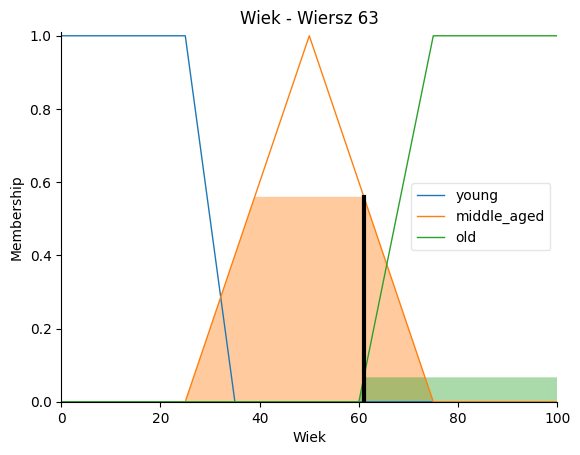

<Figure size 1000x600 with 0 Axes>

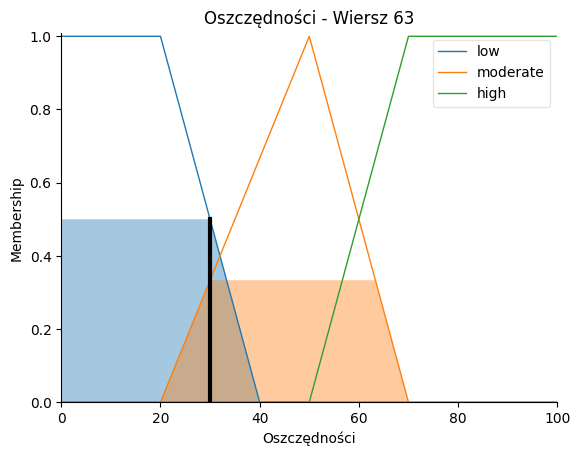

<Figure size 1000x600 with 0 Axes>

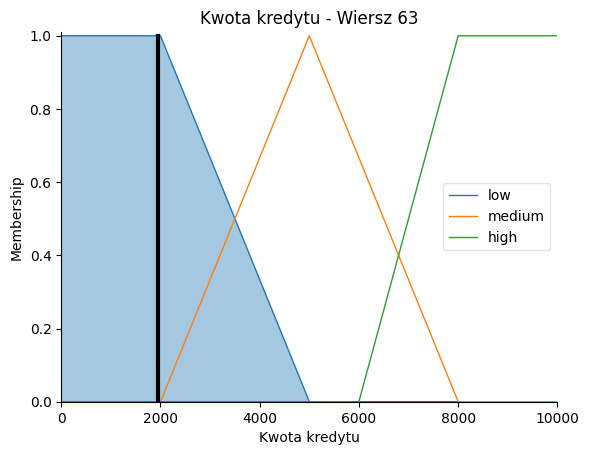

<Figure size 1000x600 with 0 Axes>

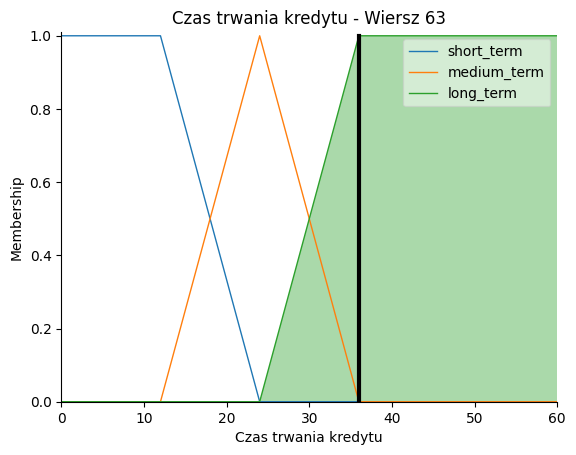

<Figure size 1000x600 with 0 Axes>

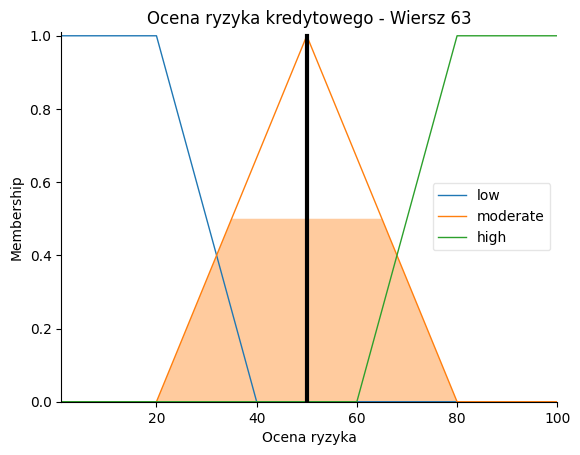

Wartości wejściowe:
Wiek: 25.0
Oszczędności: 30.0
Kwota kredytu: 14421.0
Czas trwania kredytu: 48.0
Wiersz 64:
Ocena ryzyka kredytowego = 66.23 [%]
  Przynależność (Membership):
  Wiek (25.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (14421.0): low=0.00, medium=0.00, high=0.00
  Czas trwania kredytu (48.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

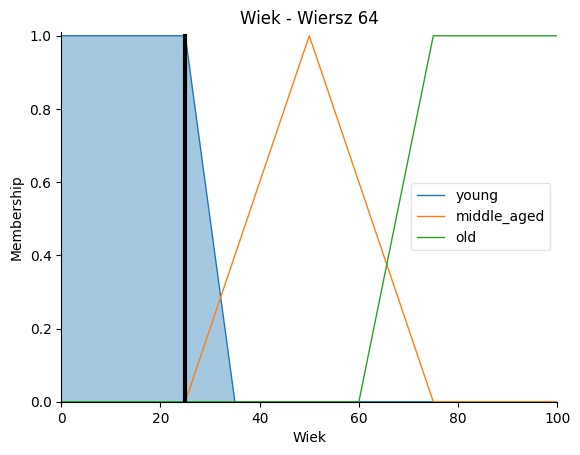

<Figure size 1000x600 with 0 Axes>

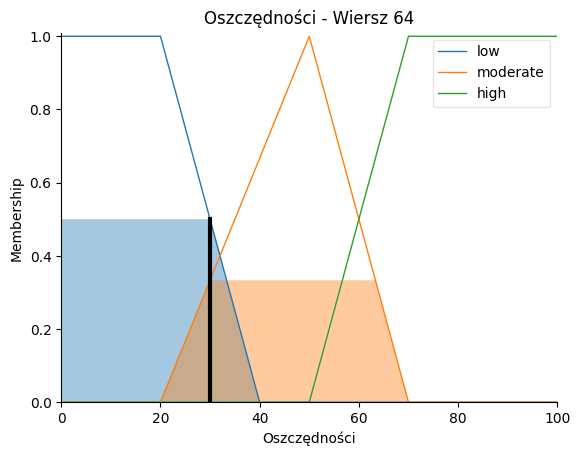

<Figure size 1000x600 with 0 Axes>

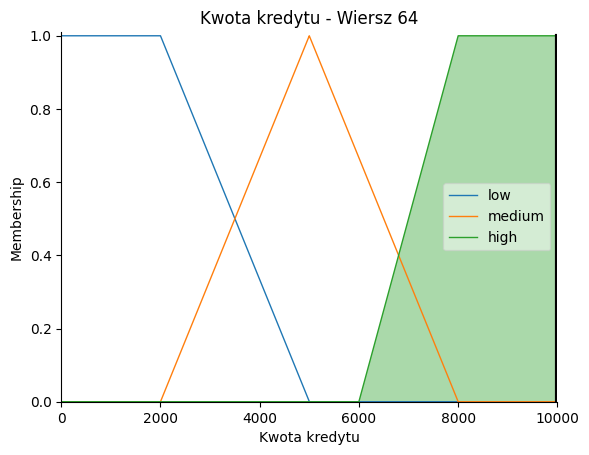

<Figure size 1000x600 with 0 Axes>

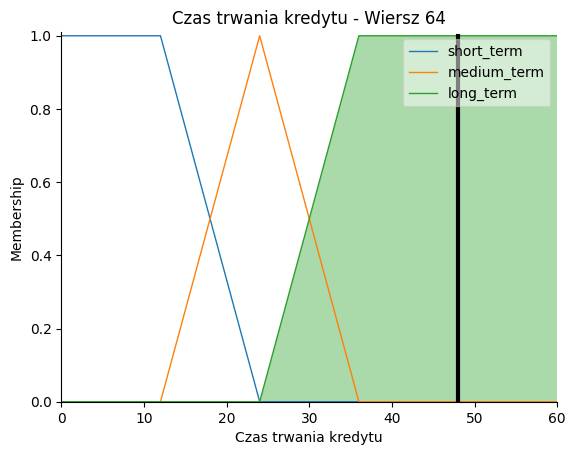

<Figure size 1000x600 with 0 Axes>

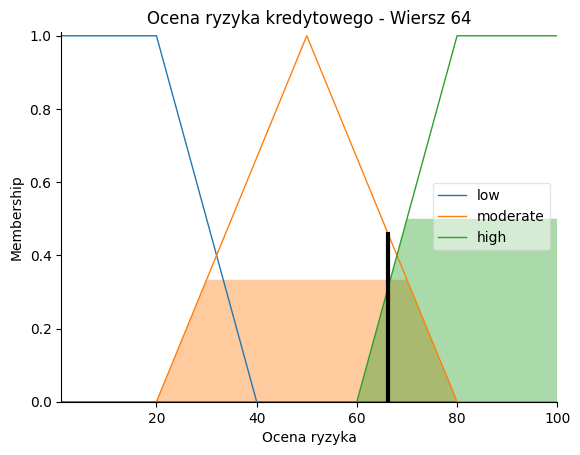

Wartości wejściowe:
Wiek: 26.0
Oszczędności: 30.0
Kwota kredytu: 3181.0
Czas trwania kredytu: 24.0
Wiersz 65:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (26.0): young=0.90, middle_aged=0.04, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (3181.0): low=0.61, medium=0.39, high=0.00
  Czas trwania kredytu (24.0): short=0.00, medium=1.00, long=0.00



<Figure size 1000x600 with 0 Axes>

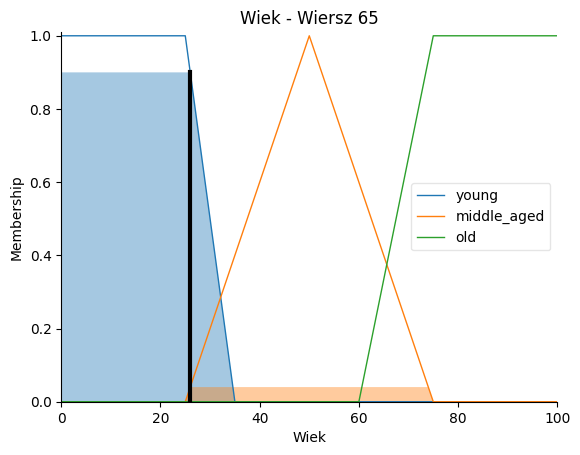

<Figure size 1000x600 with 0 Axes>

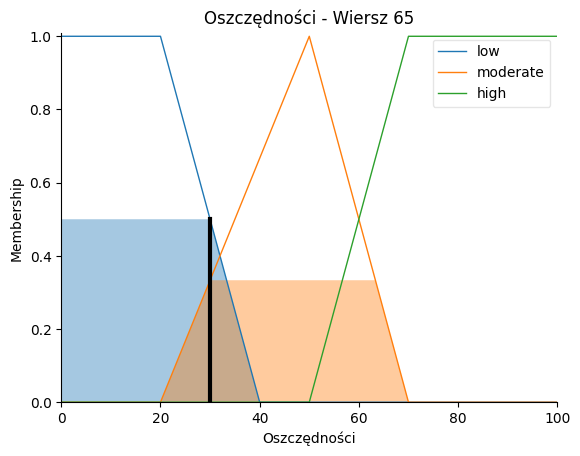

<Figure size 1000x600 with 0 Axes>

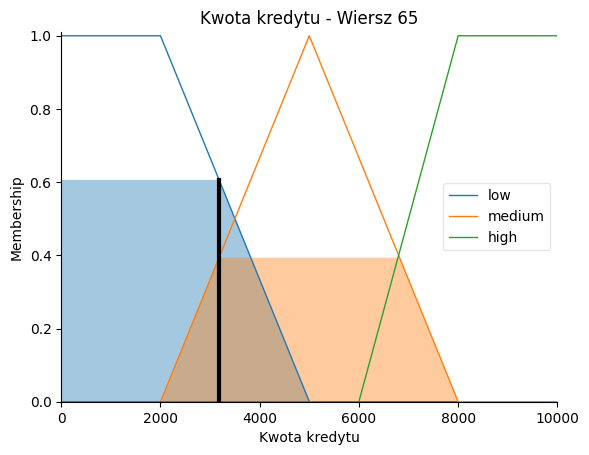

<Figure size 1000x600 with 0 Axes>

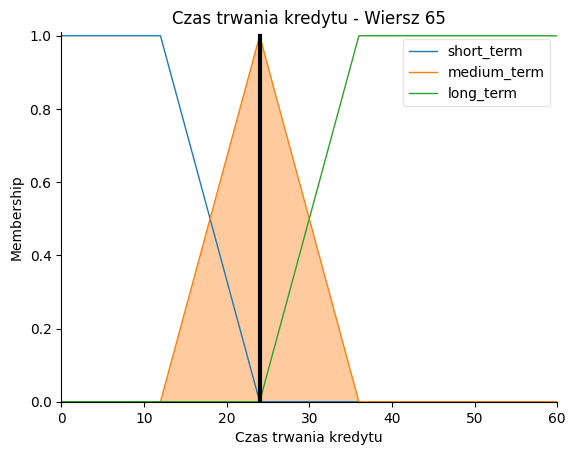

<Figure size 1000x600 with 0 Axes>

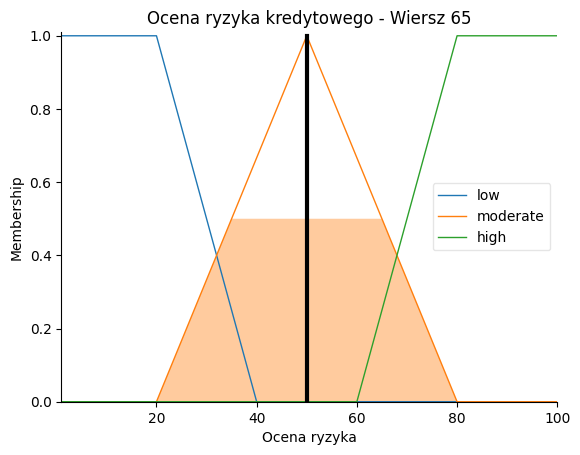

Wartości wejściowe:
Wiek: 29.0
Oszczędności: 30.0
Kwota kredytu: 2171.0
Czas trwania kredytu: 12.0
Wiersz 67:
Ocena ryzyka kredytowego = 22.96 [%]
  Przynależność (Membership):
  Wiek (29.0): young=0.60, middle_aged=0.16, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (2171.0): low=0.94, medium=0.06, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

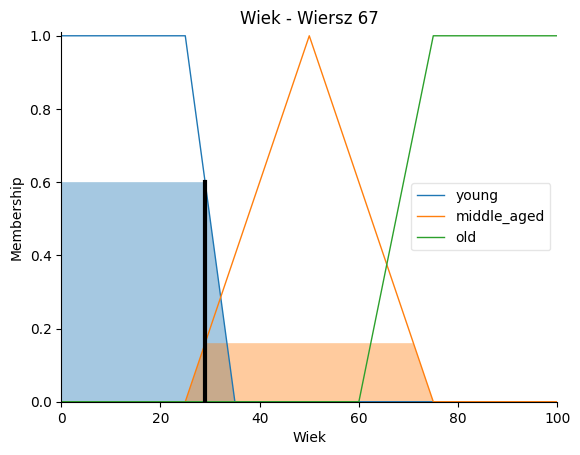

<Figure size 1000x600 with 0 Axes>

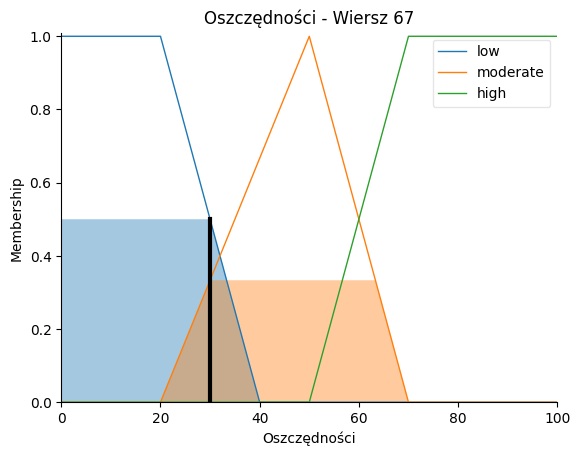

<Figure size 1000x600 with 0 Axes>

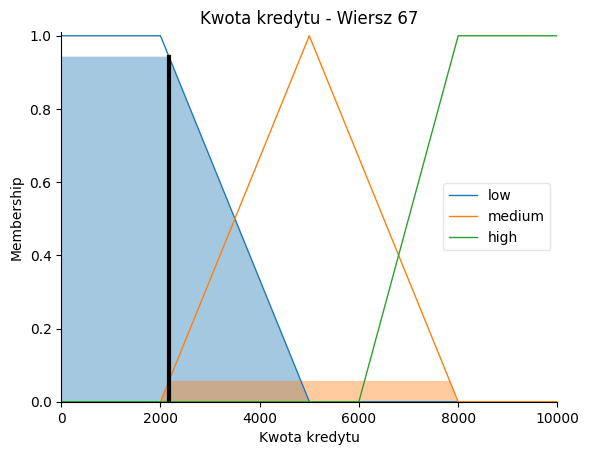

<Figure size 1000x600 with 0 Axes>

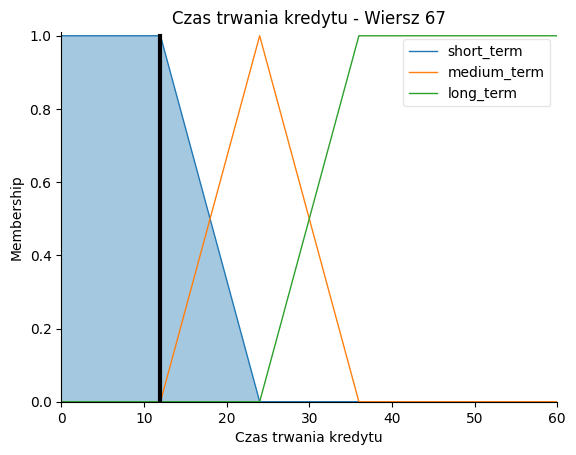

<Figure size 1000x600 with 0 Axes>

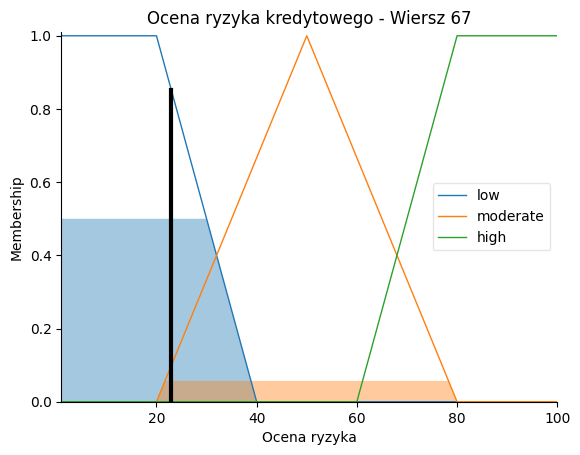

Wartości wejściowe:
Wiek: 22.0
Oszczędności: 90.0
Kwota kredytu: 1007.0
Czas trwania kredytu: 12.0
Wiersz 68:
Ocena ryzyka kredytowego = 16.07 [%]
  Przynależność (Membership):
  Wiek (22.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (1007.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

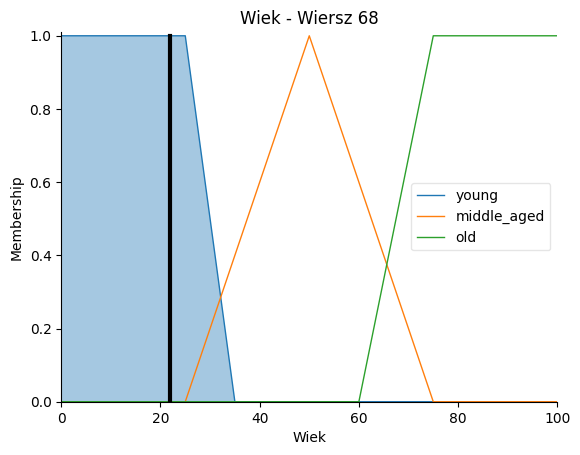

<Figure size 1000x600 with 0 Axes>

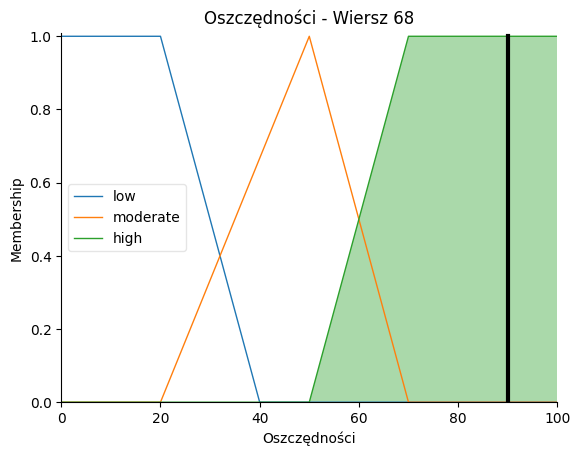

<Figure size 1000x600 with 0 Axes>

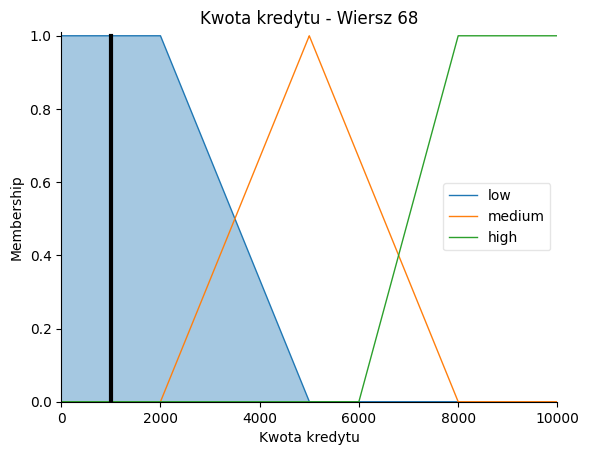

<Figure size 1000x600 with 0 Axes>

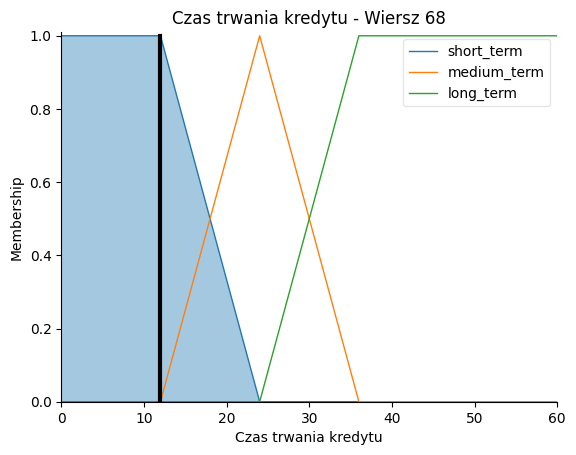

<Figure size 1000x600 with 0 Axes>

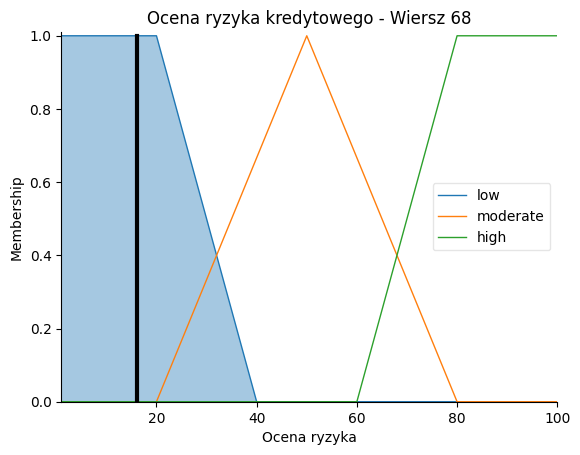

Wartości wejściowe:
Wiek: 37.0
Oszczędności: 30.0
Kwota kredytu: 1819.0
Czas trwania kredytu: 36.0
Wiersz 69:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (37.0): young=0.00, middle_aged=0.48, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1819.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (36.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

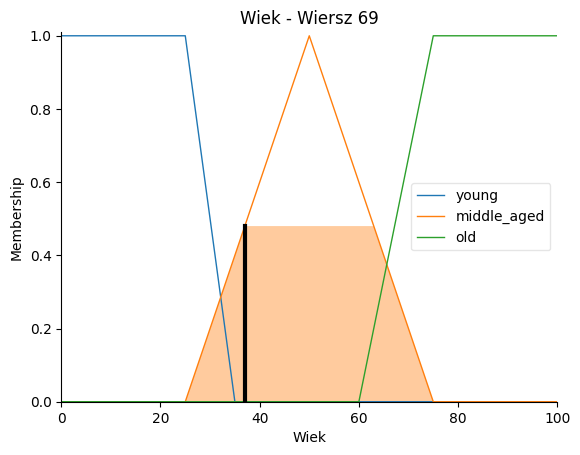

<Figure size 1000x600 with 0 Axes>

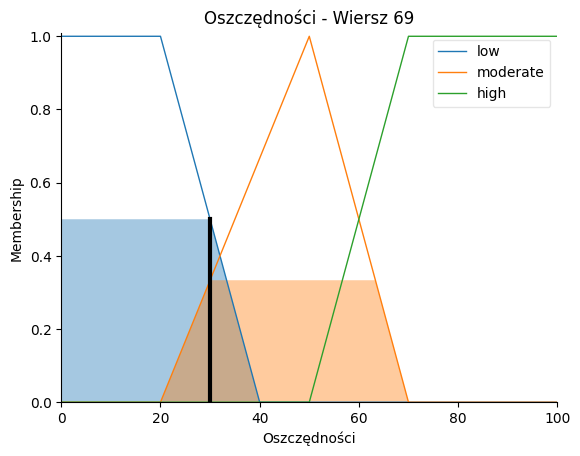

<Figure size 1000x600 with 0 Axes>

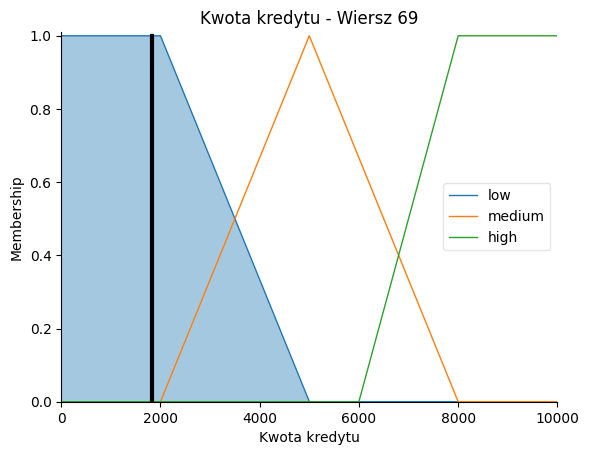

<Figure size 1000x600 with 0 Axes>

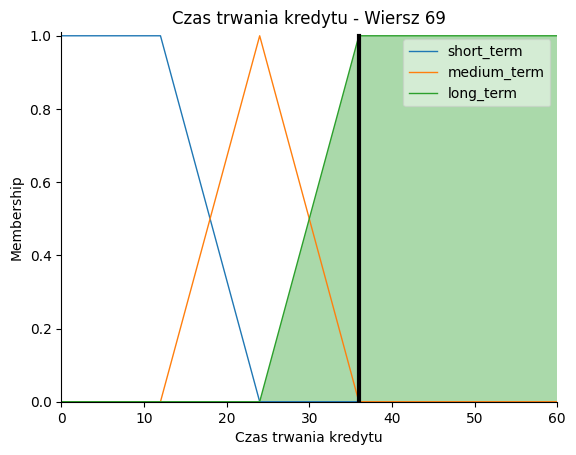

<Figure size 1000x600 with 0 Axes>

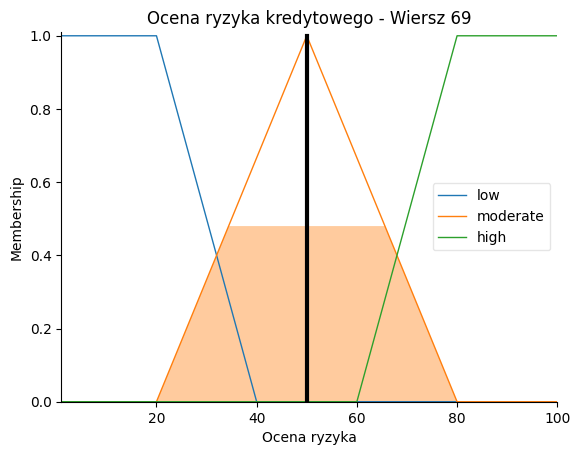

Wartości wejściowe:
Wiek: 30.0
Oszczędności: 30.0
Kwota kredytu: 8133.0
Czas trwania kredytu: 36.0
Wiersz 71:
Ocena ryzyka kredytowego = 66.23 [%]
  Przynależność (Membership):
  Wiek (30.0): young=0.50, middle_aged=0.20, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (8133.0): low=0.00, medium=0.00, high=1.00
  Czas trwania kredytu (36.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

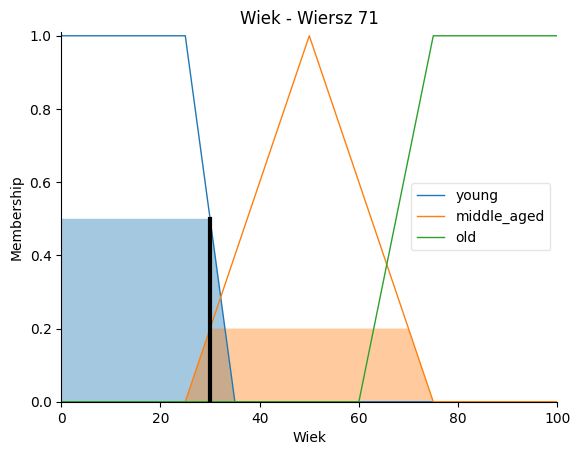

<Figure size 1000x600 with 0 Axes>

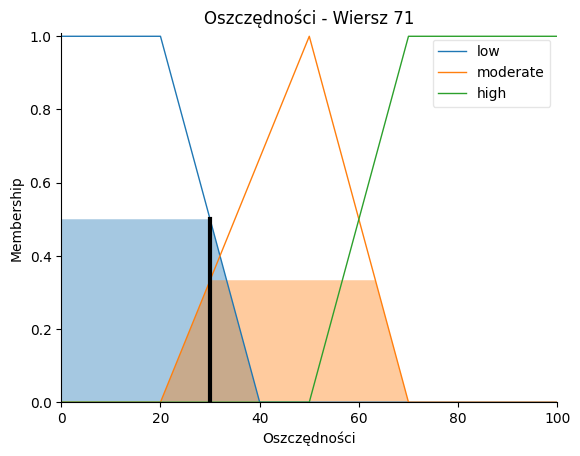

<Figure size 1000x600 with 0 Axes>

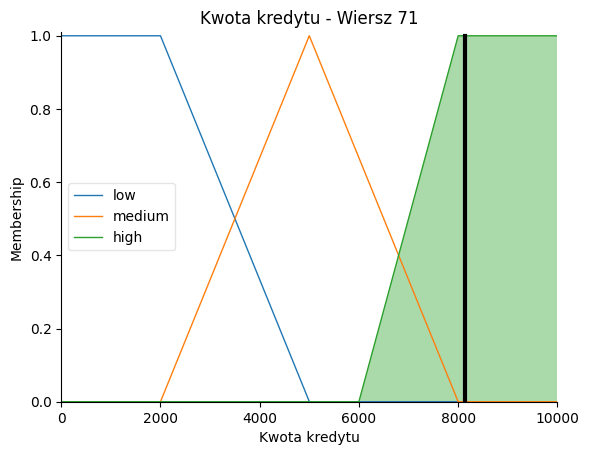

<Figure size 1000x600 with 0 Axes>

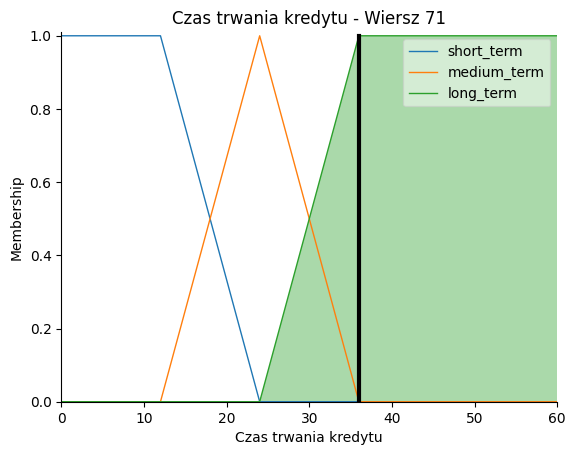

<Figure size 1000x600 with 0 Axes>

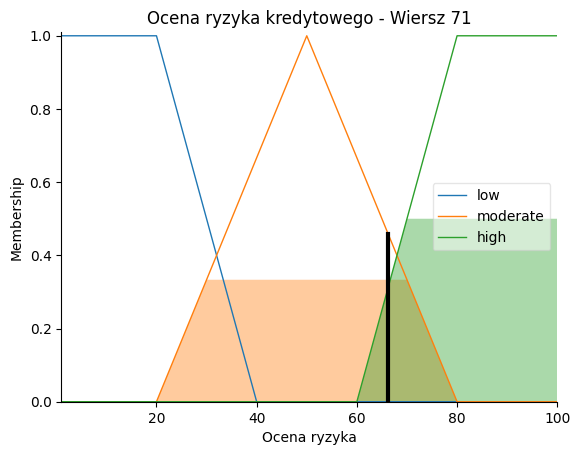

Wartości wejściowe:
Wiek: 51.0
Oszczędności: 30.0
Kwota kredytu: 1164.0
Czas trwania kredytu: 8.0
Wiersz 73:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (51.0): young=0.00, middle_aged=0.96, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1164.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (8.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

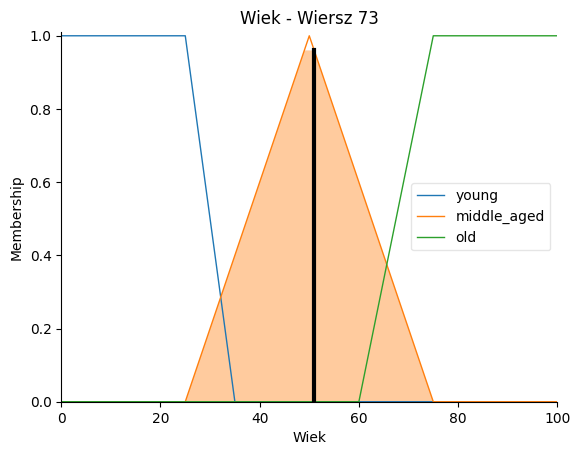

<Figure size 1000x600 with 0 Axes>

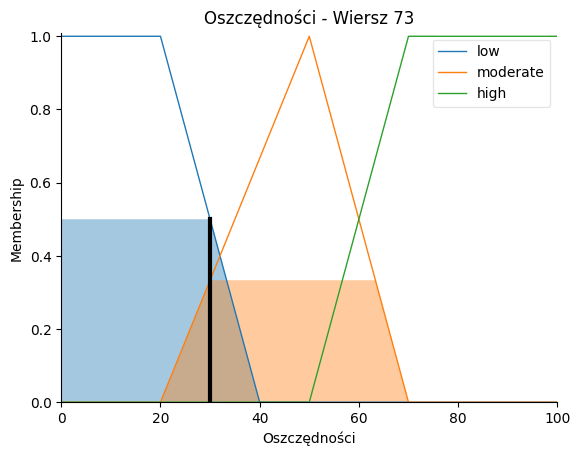

<Figure size 1000x600 with 0 Axes>

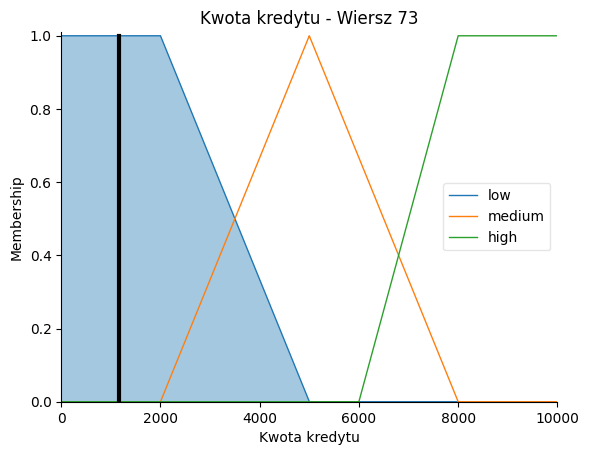

<Figure size 1000x600 with 0 Axes>

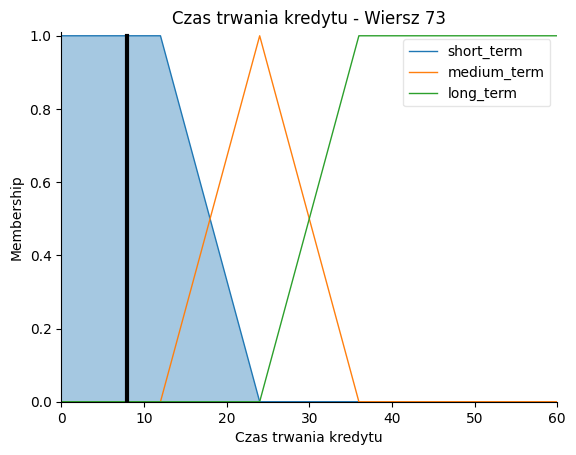

<Figure size 1000x600 with 0 Axes>

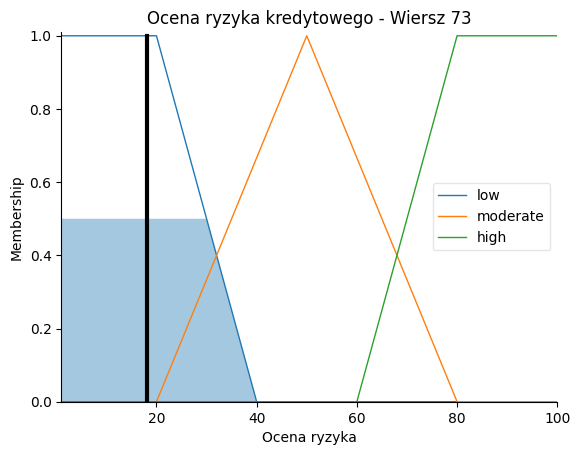

Wartości wejściowe:
Wiek: 41.0
Oszczędności: 30.0
Kwota kredytu: 5954.0
Czas trwania kredytu: 42.0
Wiersz 74:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (41.0): young=0.00, middle_aged=0.64, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (5954.0): low=0.00, medium=0.68, high=0.00
  Czas trwania kredytu (42.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

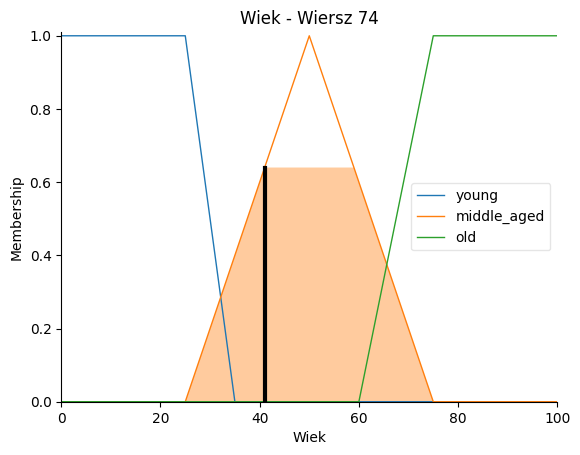

<Figure size 1000x600 with 0 Axes>

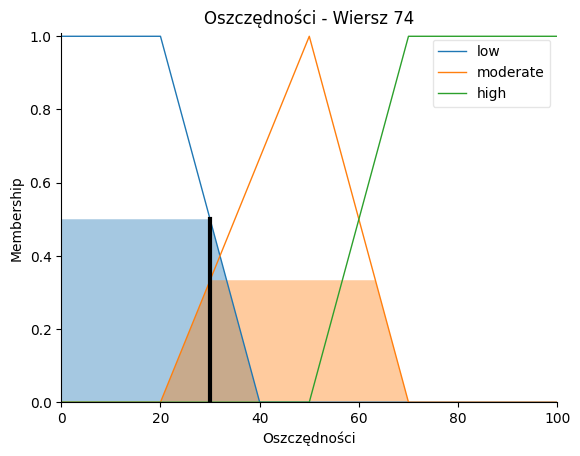

<Figure size 1000x600 with 0 Axes>

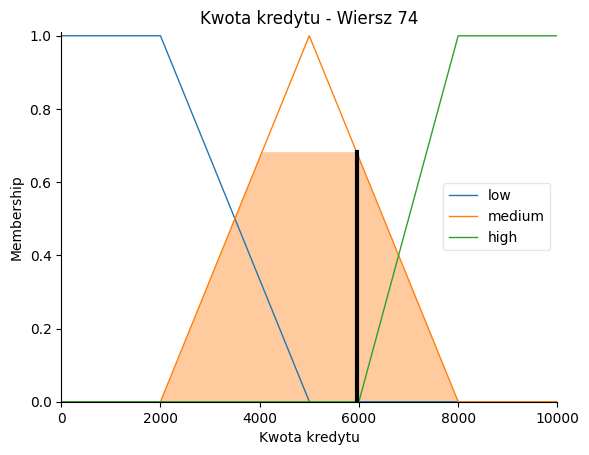

<Figure size 1000x600 with 0 Axes>

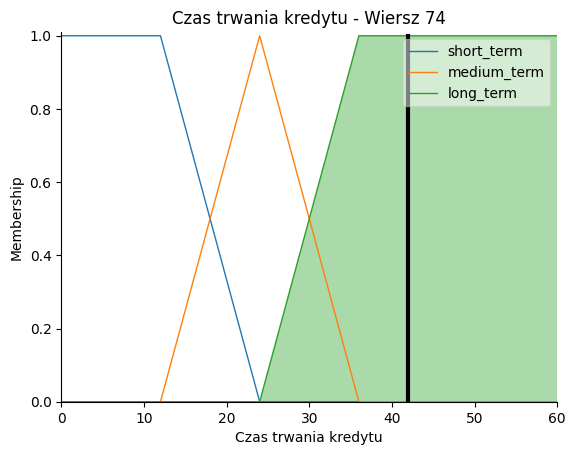

<Figure size 1000x600 with 0 Axes>

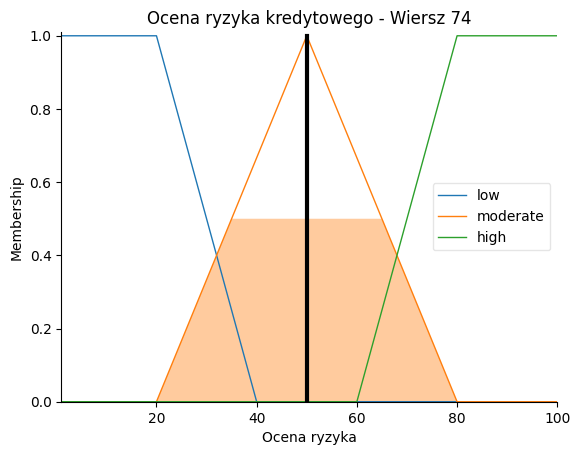

Wartości wejściowe:
Wiek: 66.0
Oszczędności: 30.0
Kwota kredytu: 1526.0
Czas trwania kredytu: 12.0
Wiersz 76:
Ocena ryzyka kredytowego = 18.58 [%]
  Przynależność (Membership):
  Wiek (66.0): young=0.00, middle_aged=0.36, old=0.40
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1526.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

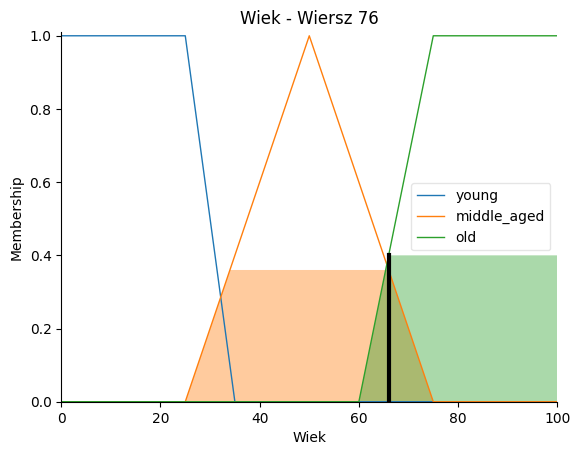

<Figure size 1000x600 with 0 Axes>

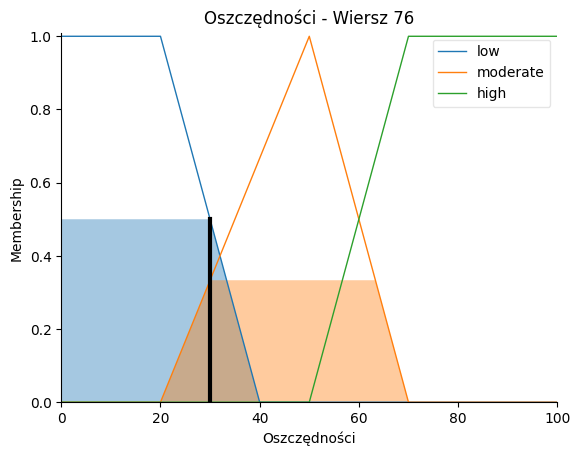

<Figure size 1000x600 with 0 Axes>

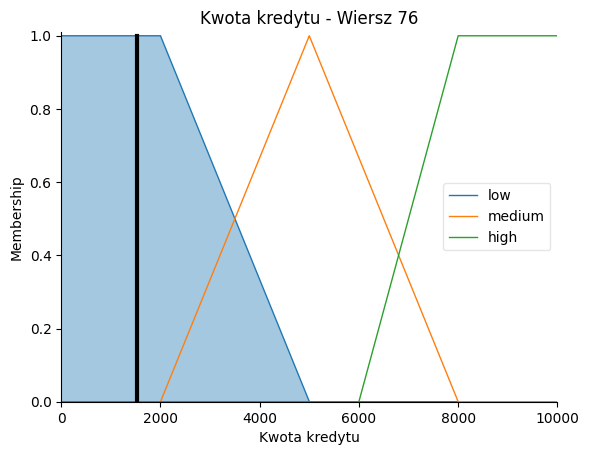

<Figure size 1000x600 with 0 Axes>

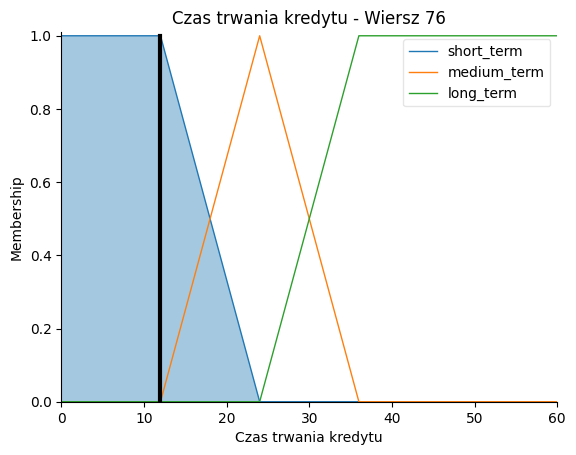

<Figure size 1000x600 with 0 Axes>

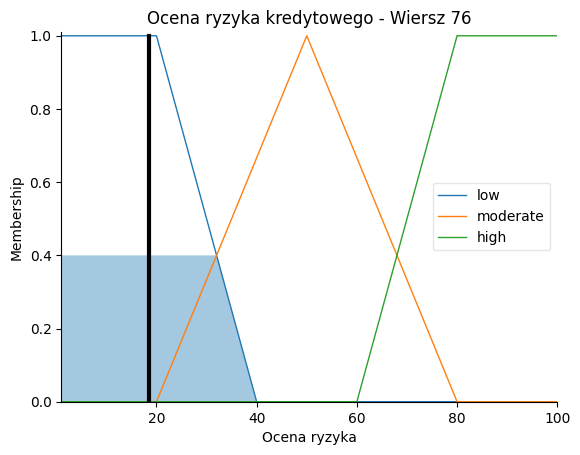

Wartości wejściowe:
Wiek: 34.0
Oszczędności: 30.0
Kwota kredytu: 3965.0
Czas trwania kredytu: 42.0
Wiersz 77:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (34.0): young=0.10, middle_aged=0.36, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (3965.0): low=0.34, medium=0.66, high=0.00
  Czas trwania kredytu (42.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

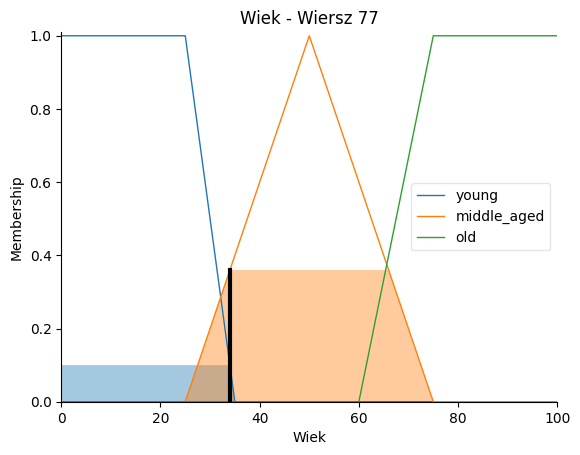

<Figure size 1000x600 with 0 Axes>

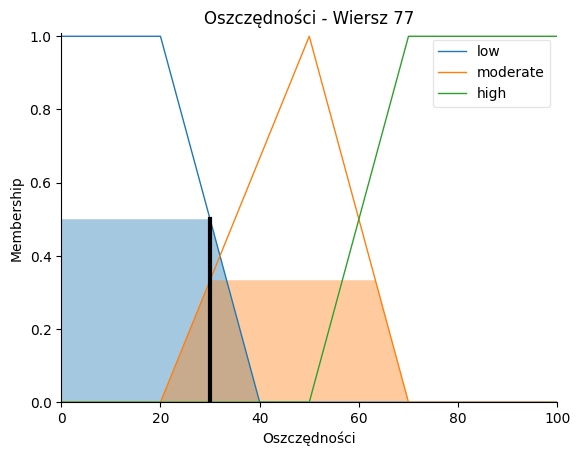

<Figure size 1000x600 with 0 Axes>

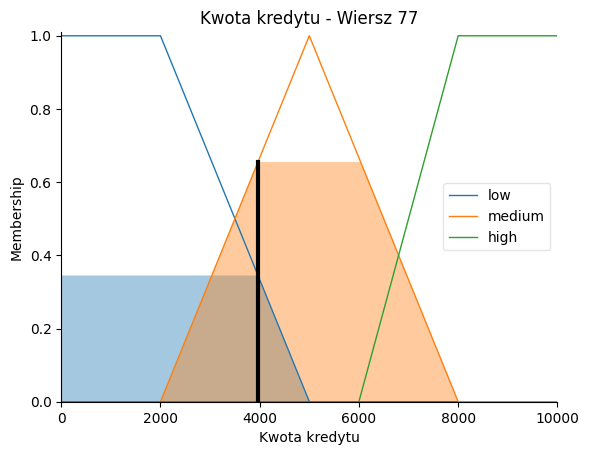

<Figure size 1000x600 with 0 Axes>

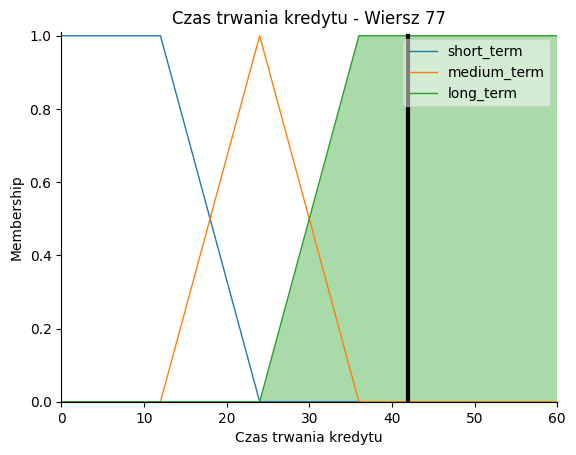

<Figure size 1000x600 with 0 Axes>

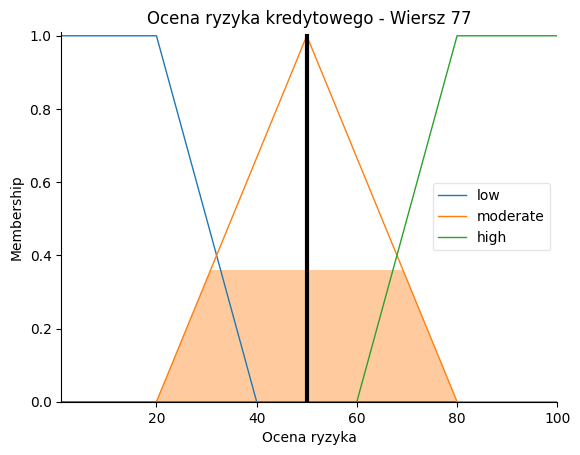

Wartości wejściowe:
Wiek: 51.0
Oszczędności: 30.0
Kwota kredytu: 4771.0
Czas trwania kredytu: 11.0
Wiersz 78:
Ocena ryzyka kredytowego = 47.51 [%]
  Przynależność (Membership):
  Wiek (51.0): young=0.00, middle_aged=0.96, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (4771.0): low=0.08, medium=0.92, high=0.00
  Czas trwania kredytu (11.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

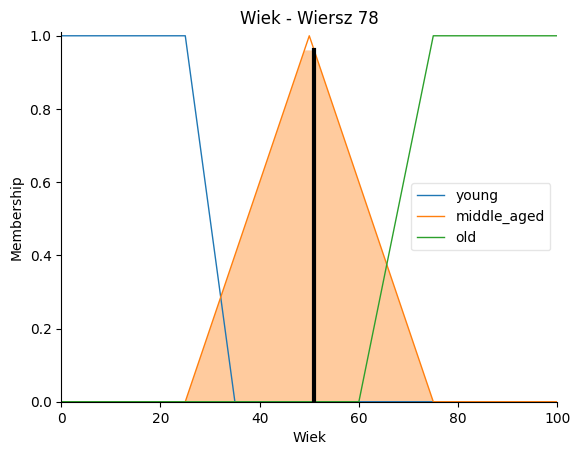

<Figure size 1000x600 with 0 Axes>

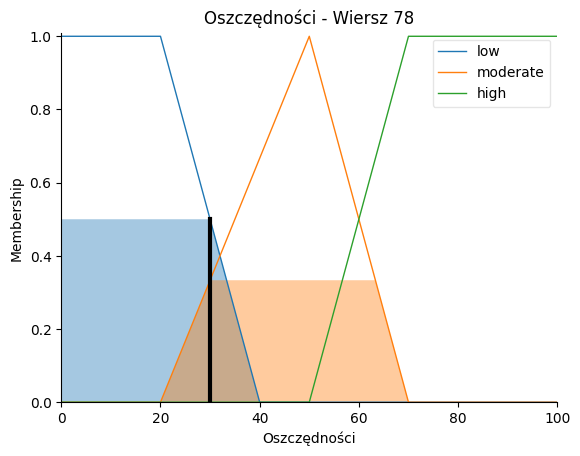

<Figure size 1000x600 with 0 Axes>

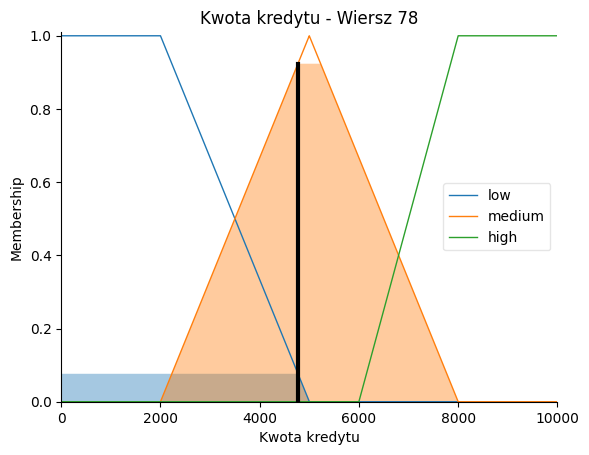

<Figure size 1000x600 with 0 Axes>

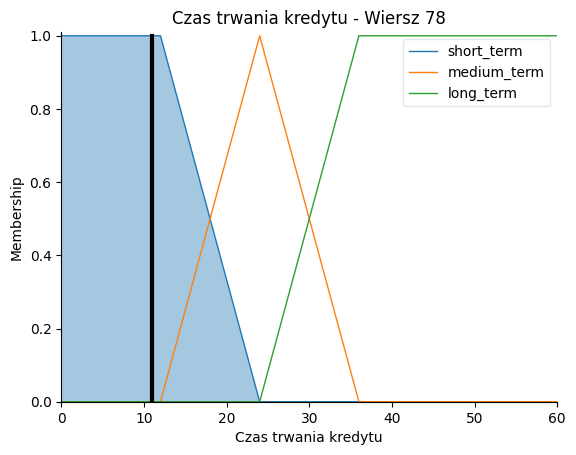

<Figure size 1000x600 with 0 Axes>

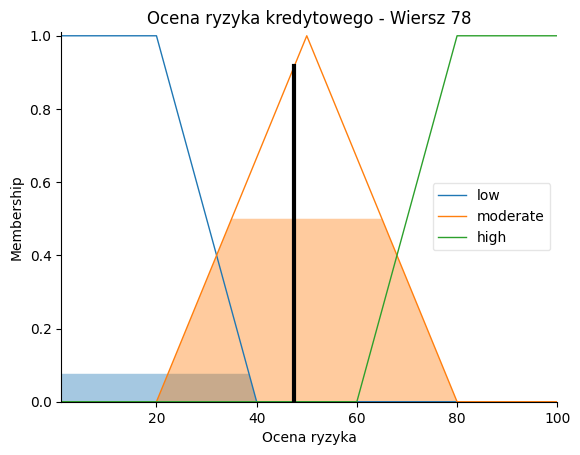

Wartości wejściowe:
Wiek: 22.0
Oszczędności: 30.0
Kwota kredytu: 3832.0
Czas trwania kredytu: 30.0
Wiersz 80:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (22.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (3832.0): low=0.39, medium=0.61, high=0.00
  Czas trwania kredytu (30.0): short=0.00, medium=0.50, long=0.50



<Figure size 1000x600 with 0 Axes>

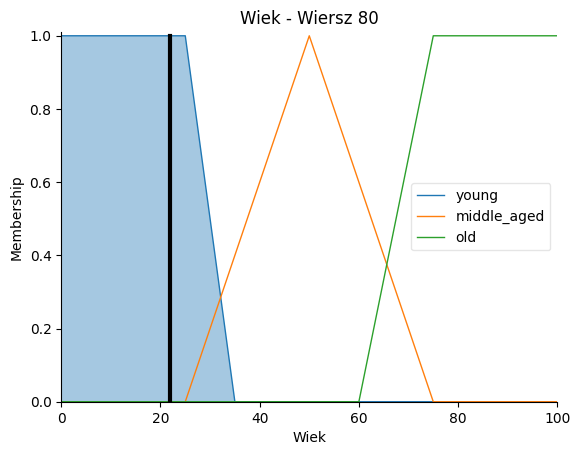

<Figure size 1000x600 with 0 Axes>

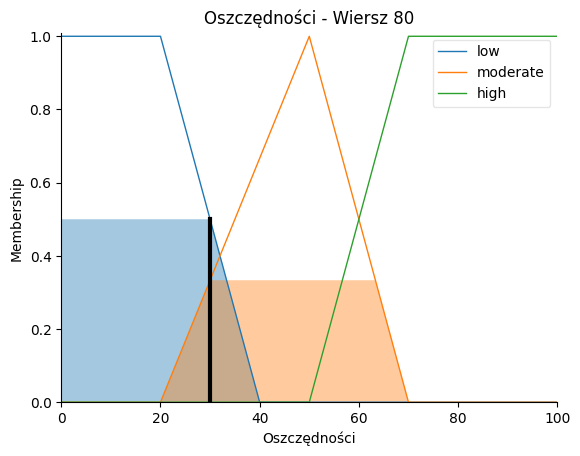

<Figure size 1000x600 with 0 Axes>

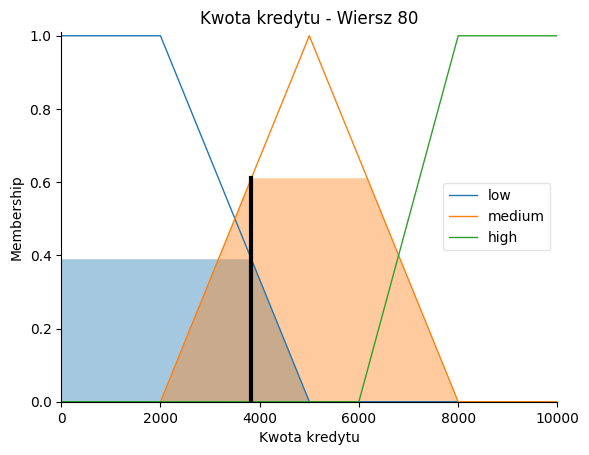

<Figure size 1000x600 with 0 Axes>

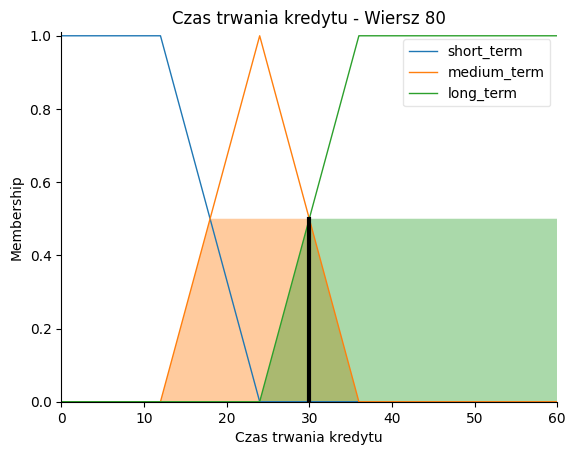

<Figure size 1000x600 with 0 Axes>

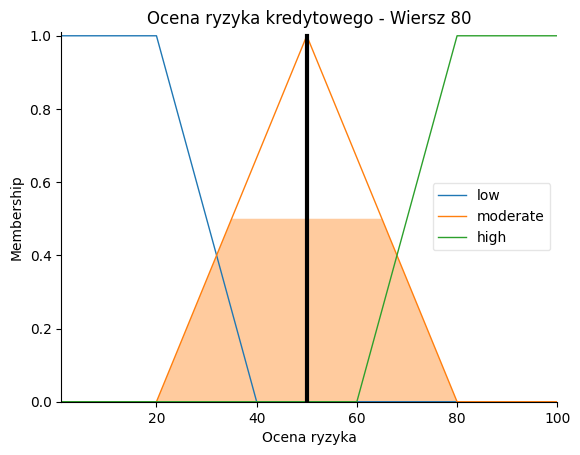

Wartości wejściowe:
Wiek: 47.0
Oszczędności: 90.0
Kwota kredytu: 1213.0
Czas trwania kredytu: 15.0
Wiersz 82:
Ocena ryzyka kredytowego = 28.64 [%]
  Przynależność (Membership):
  Wiek (47.0): young=0.00, middle_aged=0.88, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (1213.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (15.0): short=0.75, medium=0.25, long=0.00



<Figure size 1000x600 with 0 Axes>

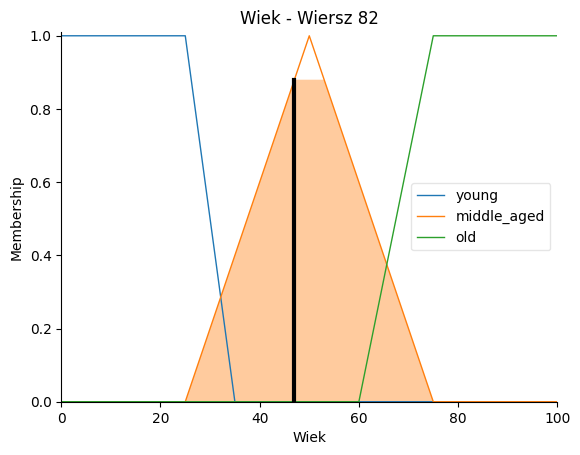

<Figure size 1000x600 with 0 Axes>

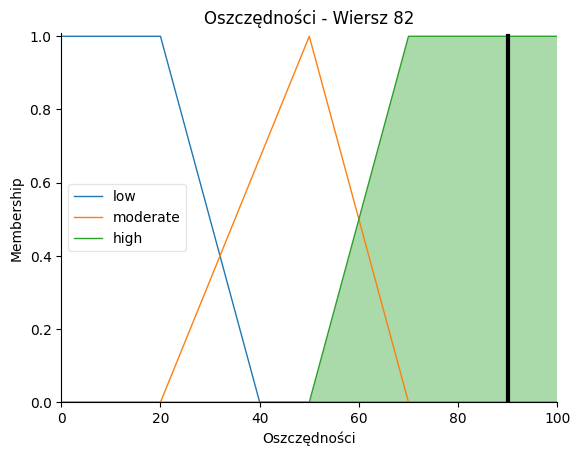

<Figure size 1000x600 with 0 Axes>

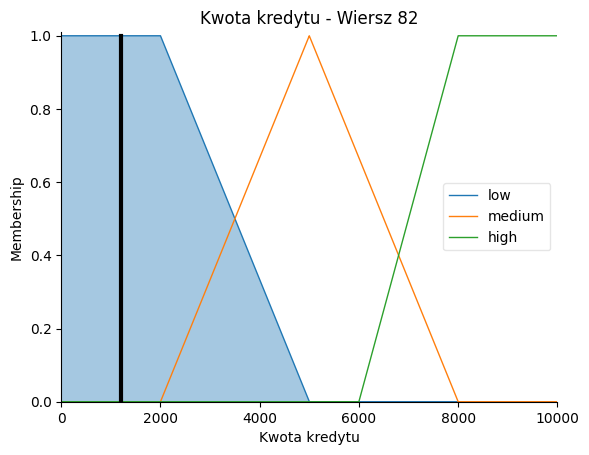

<Figure size 1000x600 with 0 Axes>

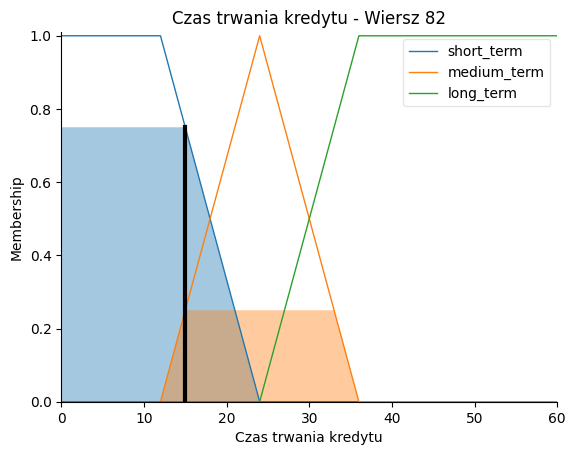

<Figure size 1000x600 with 0 Axes>

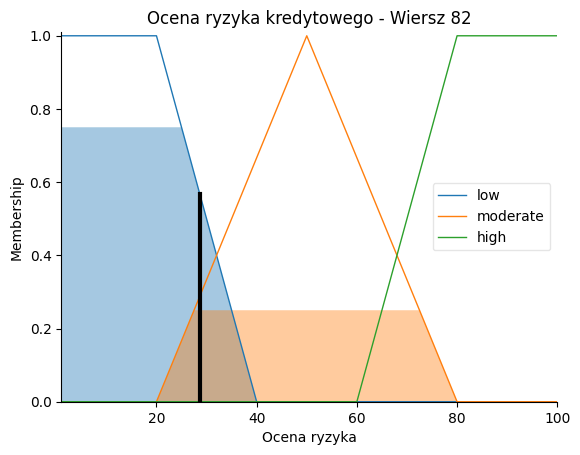

Wartości wejściowe:
Wiek: 24.0
Oszczędności: 50.0
Kwota kredytu: 1568.0
Czas trwania kredytu: 18.0
Wiersz 83:
Ocena ryzyka kredytowego = 36.91 [%]
  Przynależność (Membership):
  Wiek (24.0): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (50.0): low=0.00, moderate=1.00, high=0.00
  Kwota kredytu (1568.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (18.0): short=0.50, medium=0.50, long=0.00



<Figure size 1000x600 with 0 Axes>

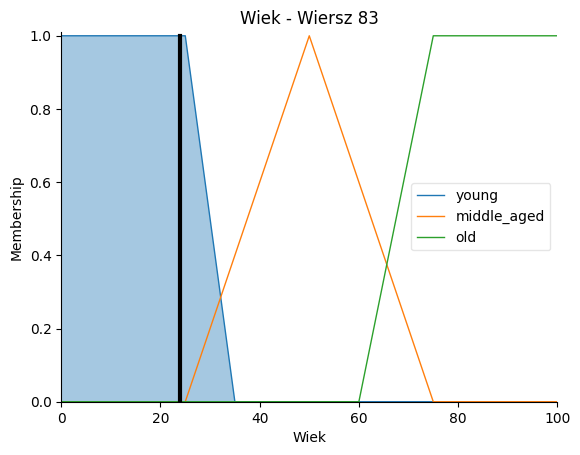

<Figure size 1000x600 with 0 Axes>

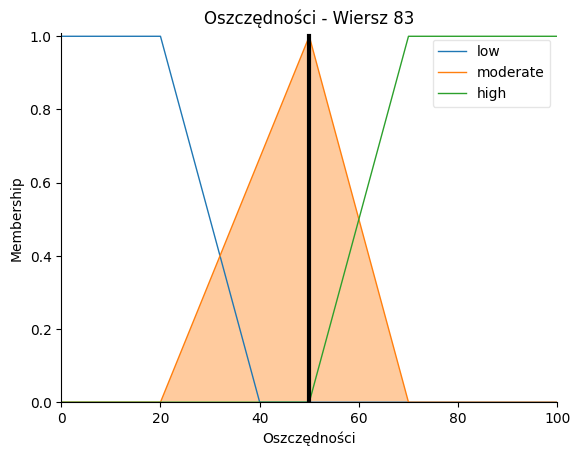

<Figure size 1000x600 with 0 Axes>

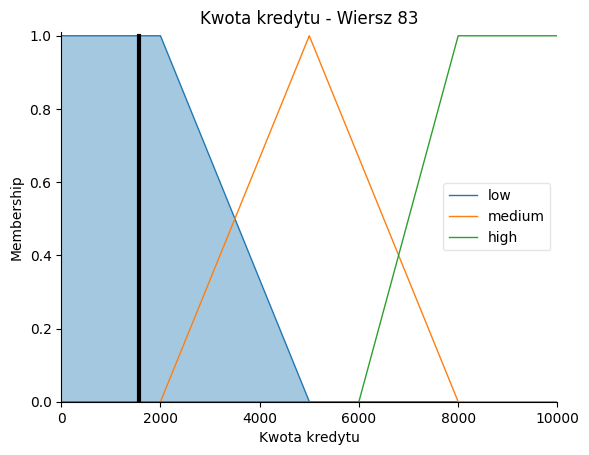

<Figure size 1000x600 with 0 Axes>

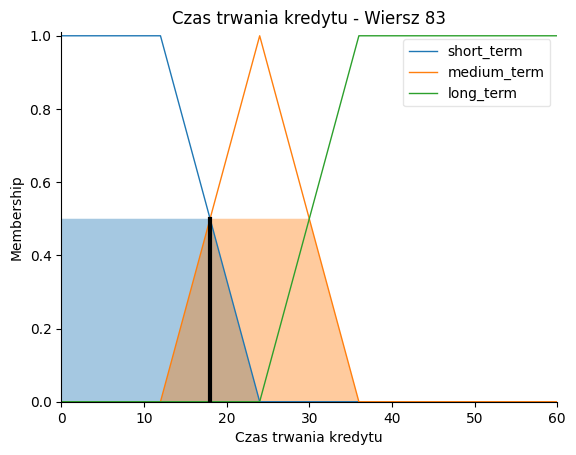

<Figure size 1000x600 with 0 Axes>

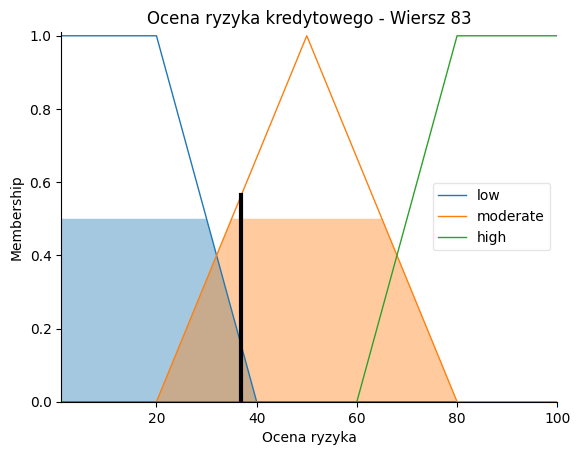

Wartości wejściowe:
Wiek: 58.0
Oszczędności: 30.0
Kwota kredytu: 1755.0
Czas trwania kredytu: 24.0
Wiersz 84:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (58.0): young=0.00, middle_aged=0.68, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1755.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (24.0): short=0.00, medium=1.00, long=0.00



<Figure size 1000x600 with 0 Axes>

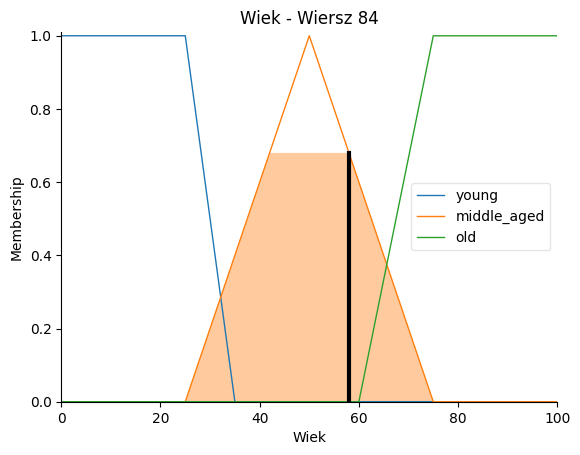

<Figure size 1000x600 with 0 Axes>

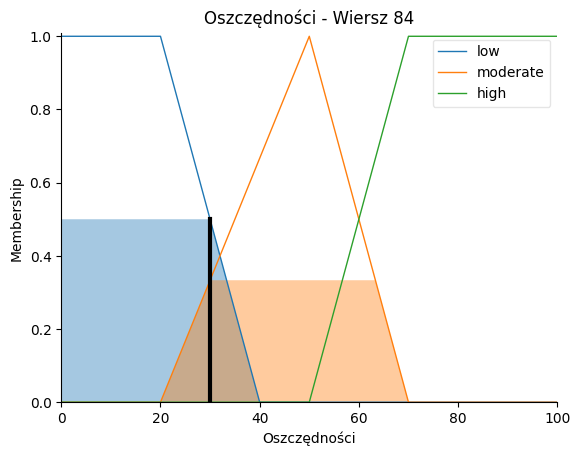

<Figure size 1000x600 with 0 Axes>

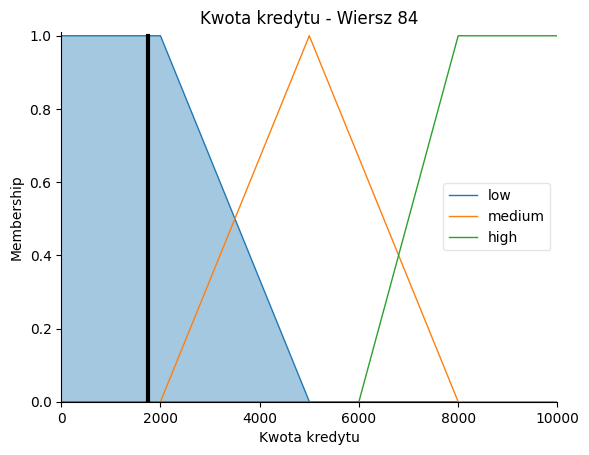

<Figure size 1000x600 with 0 Axes>

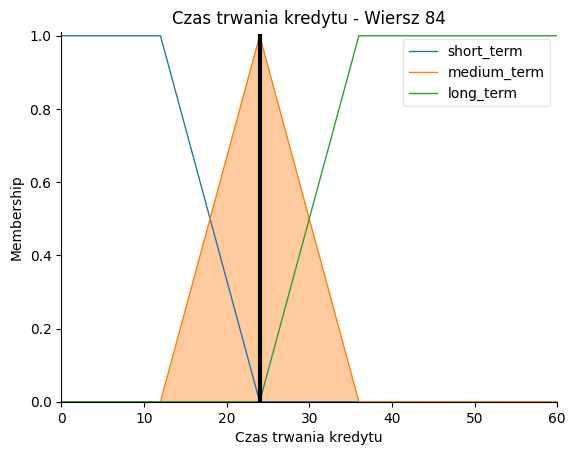

<Figure size 1000x600 with 0 Axes>

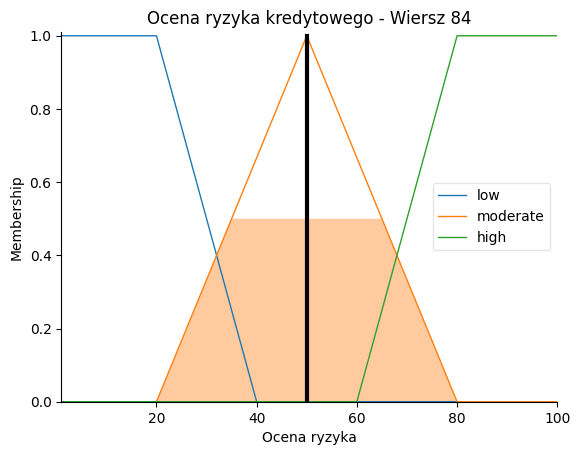

Wartości wejściowe:
Wiek: 52.0
Oszczędności: 30.0
Kwota kredytu: 2315.0
Czas trwania kredytu: 10.0
Wiersz 85:
Ocena ryzyka kredytowego = 26.08 [%]
  Przynależność (Membership):
  Wiek (52.0): young=0.00, middle_aged=0.92, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (2315.0): low=0.90, medium=0.10, high=0.00
  Czas trwania kredytu (10.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

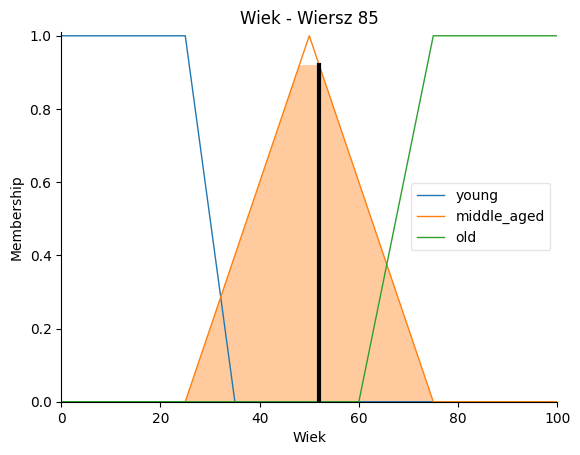

<Figure size 1000x600 with 0 Axes>

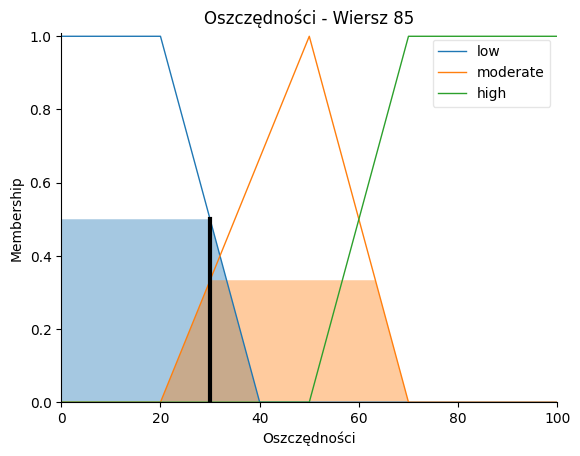

<Figure size 1000x600 with 0 Axes>

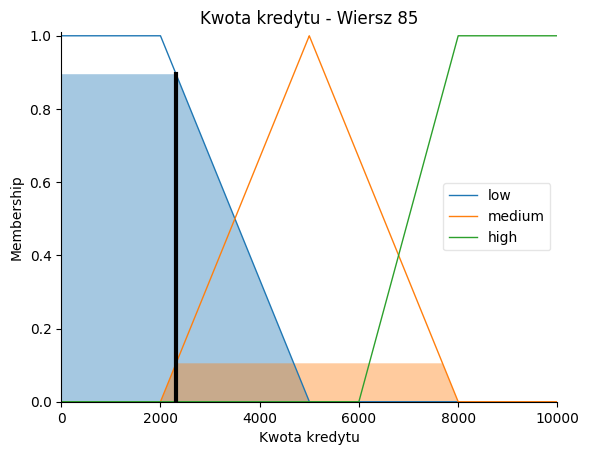

<Figure size 1000x600 with 0 Axes>

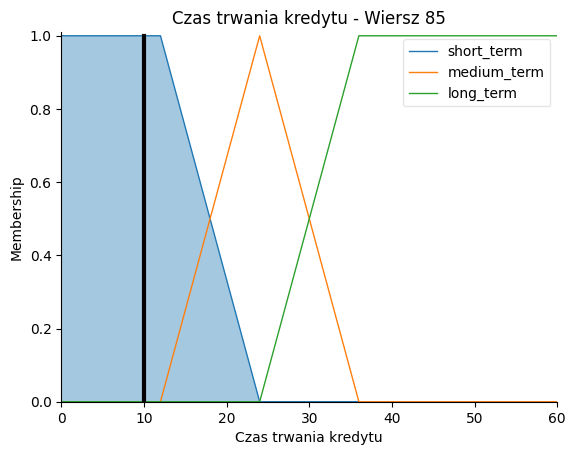

<Figure size 1000x600 with 0 Axes>

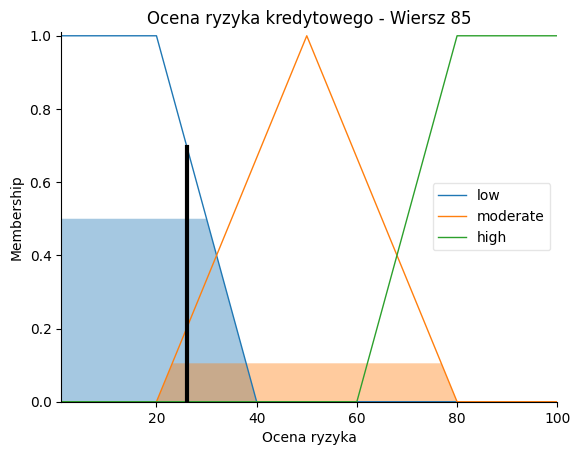

Wartości wejściowe:
Wiek: 29.0
Oszczędności: 30.0
Kwota kredytu: 1412.0
Czas trwania kredytu: 12.0
Wiersz 86:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (29.0): young=0.60, middle_aged=0.16, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1412.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

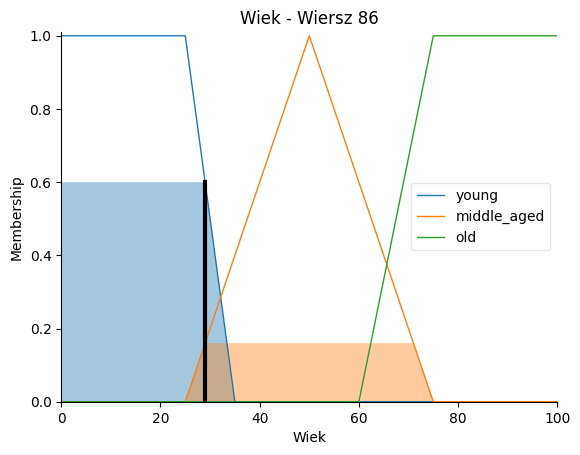

<Figure size 1000x600 with 0 Axes>

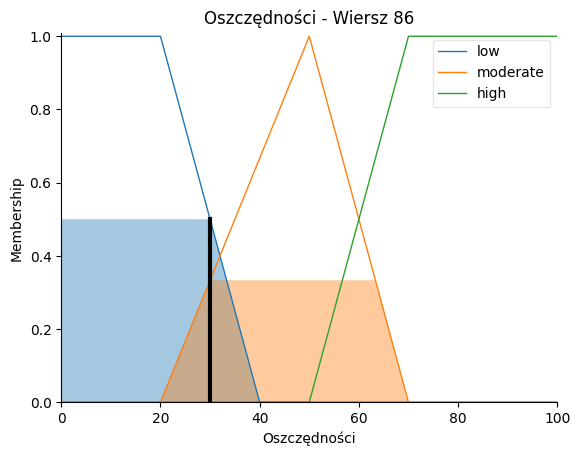

<Figure size 1000x600 with 0 Axes>

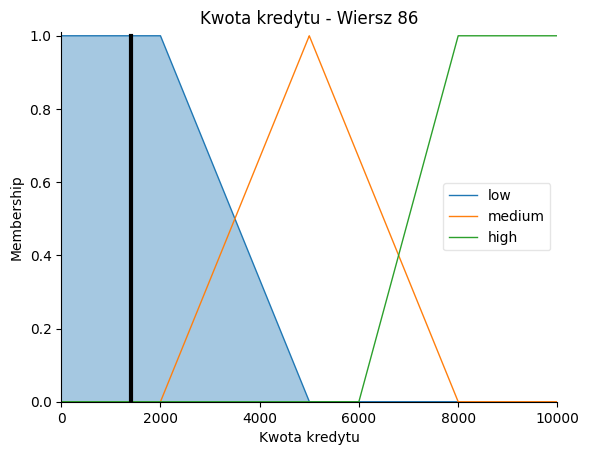

<Figure size 1000x600 with 0 Axes>

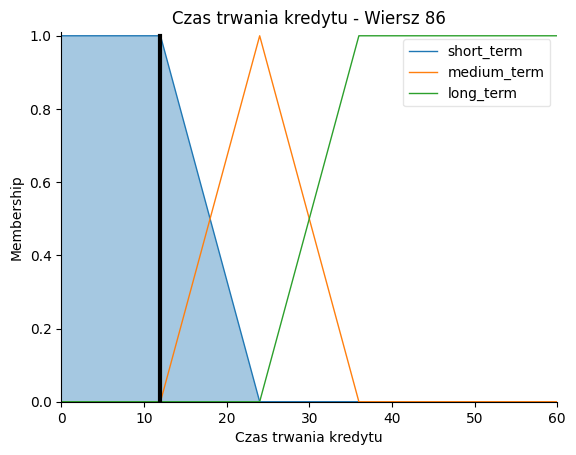

<Figure size 1000x600 with 0 Axes>

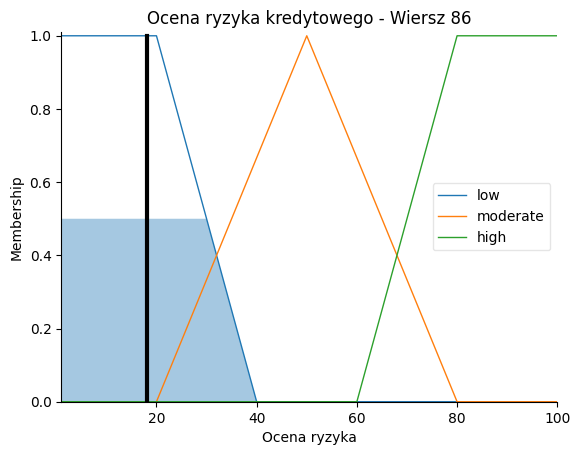

Wartości wejściowe:
Wiek: 27.0
Oszczędności: 30.0
Kwota kredytu: 1295.0
Czas trwania kredytu: 18.0
Wiersz 87:
Ocena ryzyka kredytowego = 36.91 [%]
  Przynależność (Membership):
  Wiek (27.0): young=0.80, middle_aged=0.08, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1295.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (18.0): short=0.50, medium=0.50, long=0.00



<Figure size 1000x600 with 0 Axes>

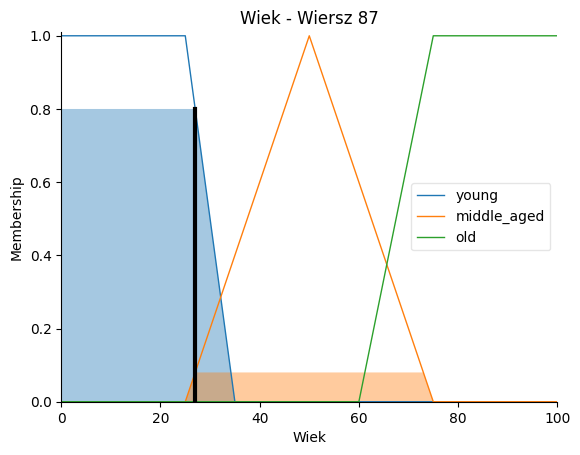

<Figure size 1000x600 with 0 Axes>

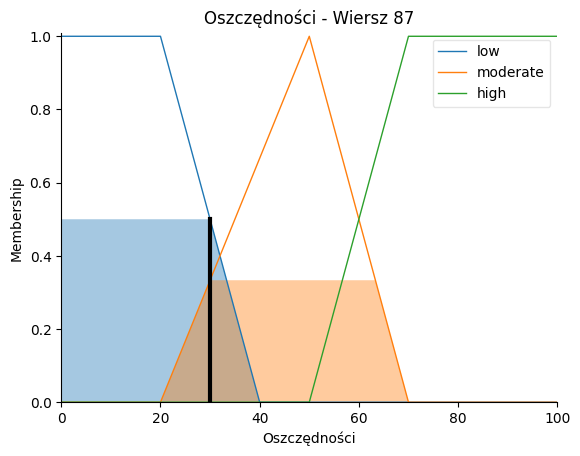

<Figure size 1000x600 with 0 Axes>

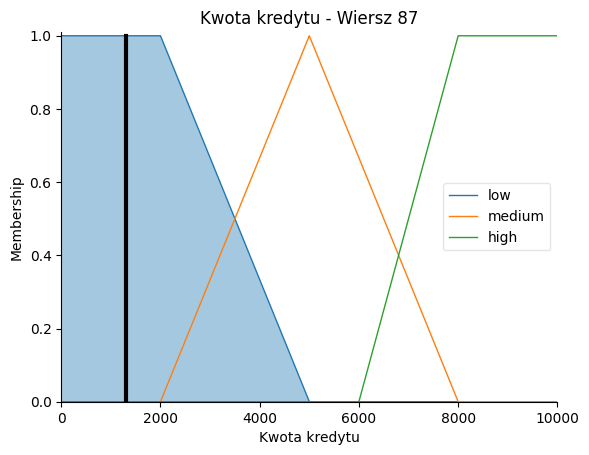

<Figure size 1000x600 with 0 Axes>

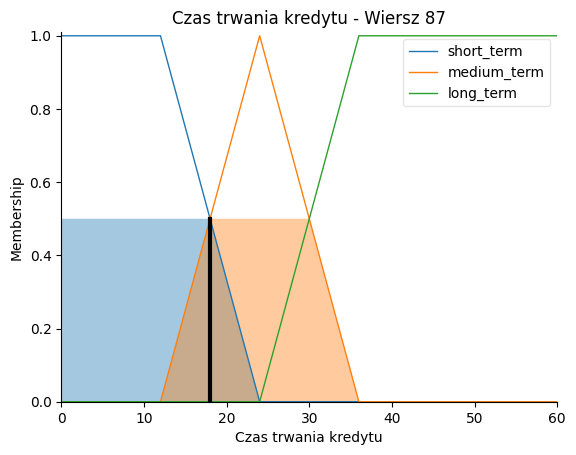

<Figure size 1000x600 with 0 Axes>

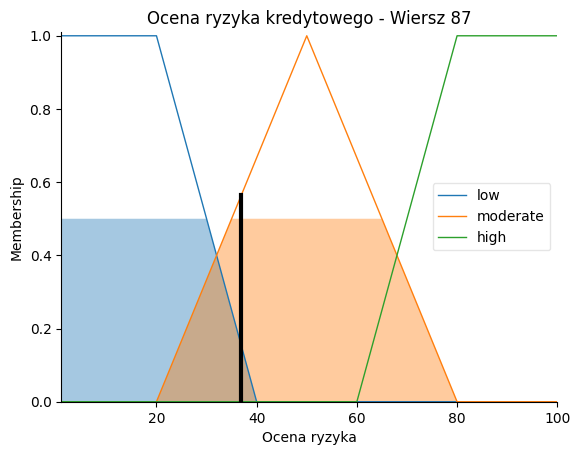

Wartości wejściowe:
Wiek: 47.0
Oszczędności: 50.0
Kwota kredytu: 12612.0
Czas trwania kredytu: 36.0
Wiersz 88:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (47.0): young=0.00, middle_aged=0.88, old=0.00
  Oszczędności (50.0): low=0.00, moderate=1.00, high=0.00
  Kwota kredytu (12612.0): low=0.00, medium=0.00, high=0.00
  Czas trwania kredytu (36.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

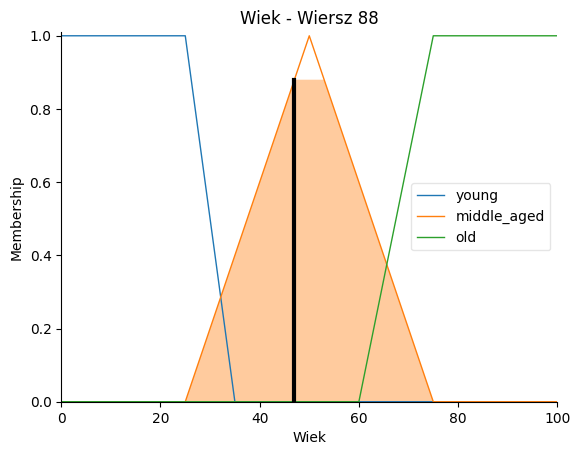

<Figure size 1000x600 with 0 Axes>

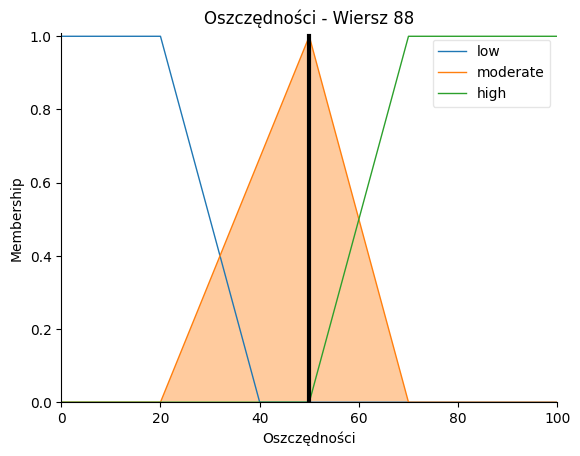

<Figure size 1000x600 with 0 Axes>

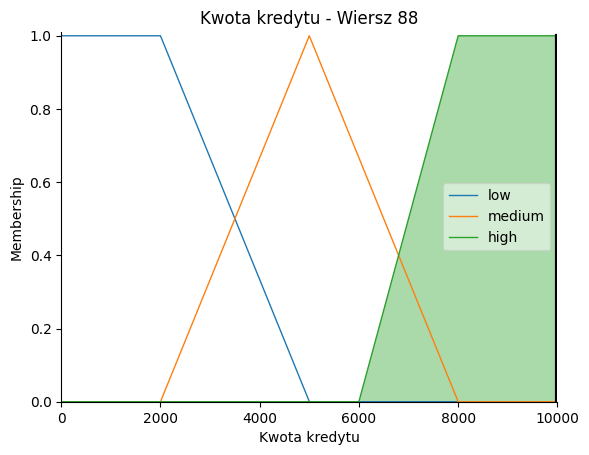

<Figure size 1000x600 with 0 Axes>

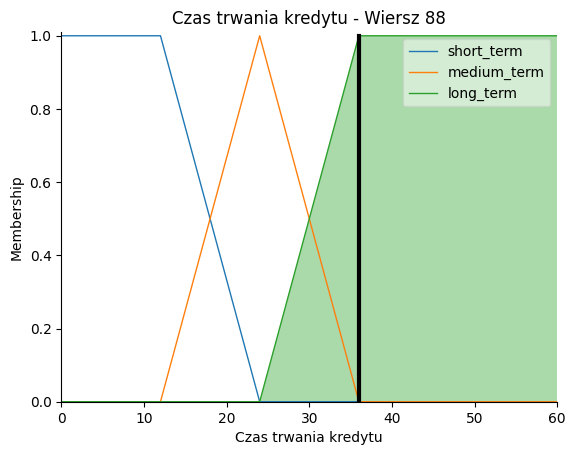

<Figure size 1000x600 with 0 Axes>

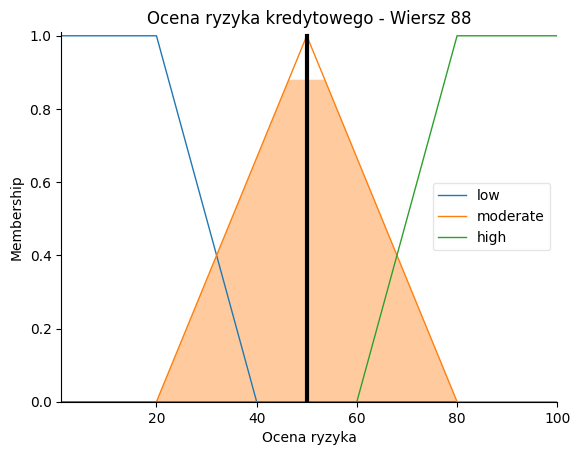

Wartości wejściowe:
Wiek: 30.0
Oszczędności: 50.0
Kwota kredytu: 2249.0
Czas trwania kredytu: 18.0
Wiersz 89:
Ocena ryzyka kredytowego = 36.91 [%]
  Przynależność (Membership):
  Wiek (30.0): young=0.50, middle_aged=0.20, old=0.00
  Oszczędności (50.0): low=0.00, moderate=1.00, high=0.00
  Kwota kredytu (2249.0): low=0.92, medium=0.08, high=0.00
  Czas trwania kredytu (18.0): short=0.50, medium=0.50, long=0.00



<Figure size 1000x600 with 0 Axes>

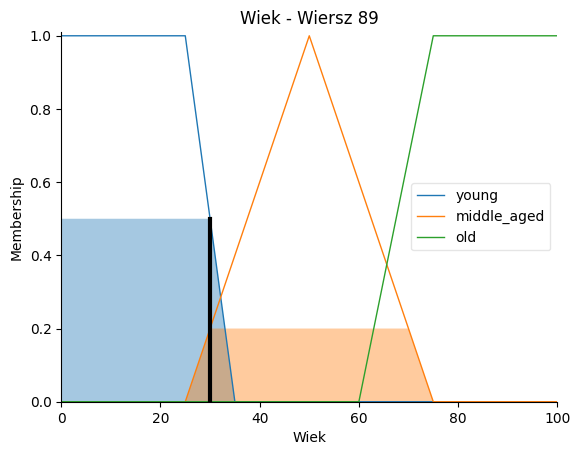

<Figure size 1000x600 with 0 Axes>

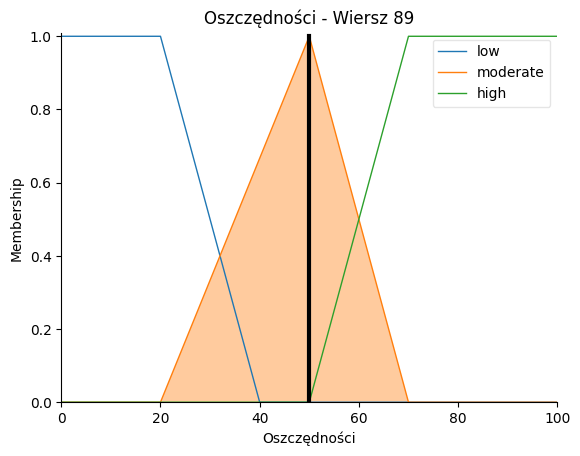

<Figure size 1000x600 with 0 Axes>

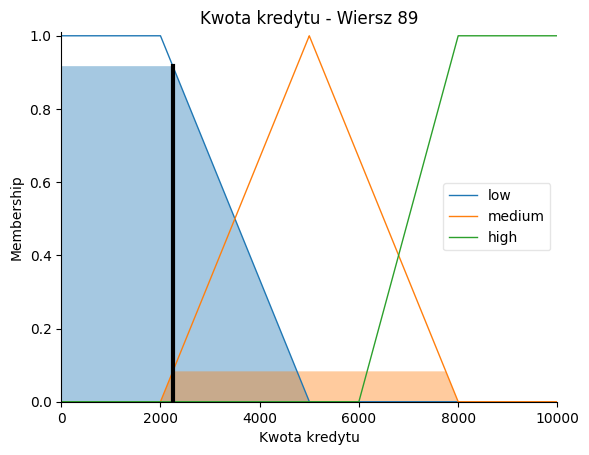

<Figure size 1000x600 with 0 Axes>

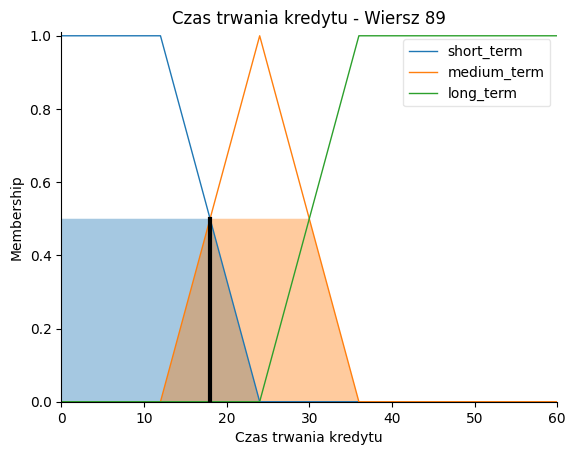

<Figure size 1000x600 with 0 Axes>

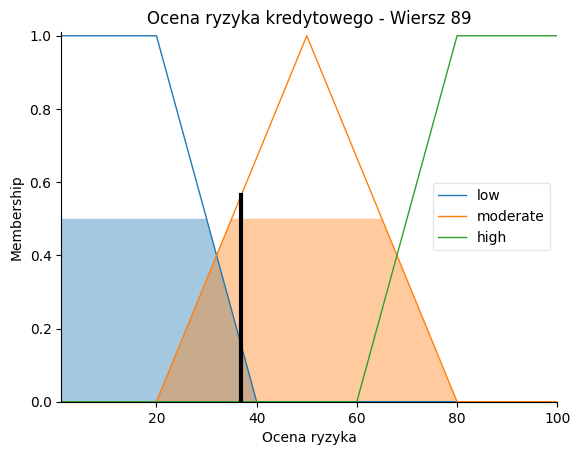

Wartości wejściowe:
Wiek: 28.0
Oszczędności: 30.0
Kwota kredytu: 1108.0
Czas trwania kredytu: 12.0
Wiersz 90:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (28.0): young=0.70, middle_aged=0.12, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1108.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

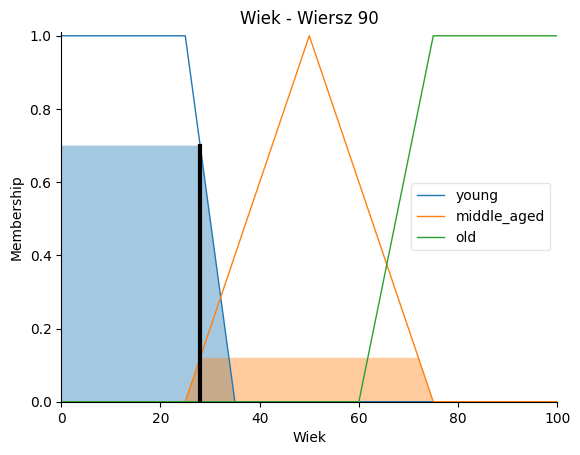

<Figure size 1000x600 with 0 Axes>

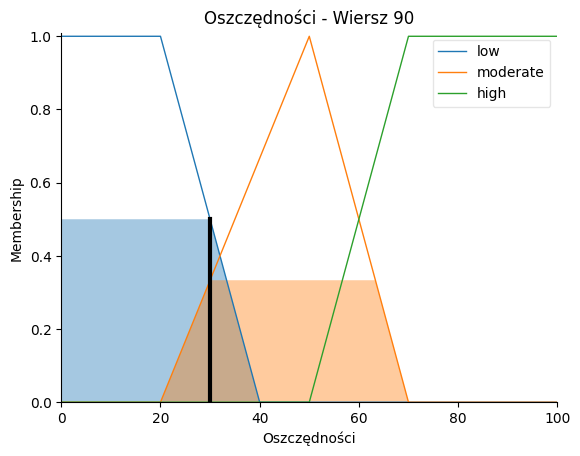

<Figure size 1000x600 with 0 Axes>

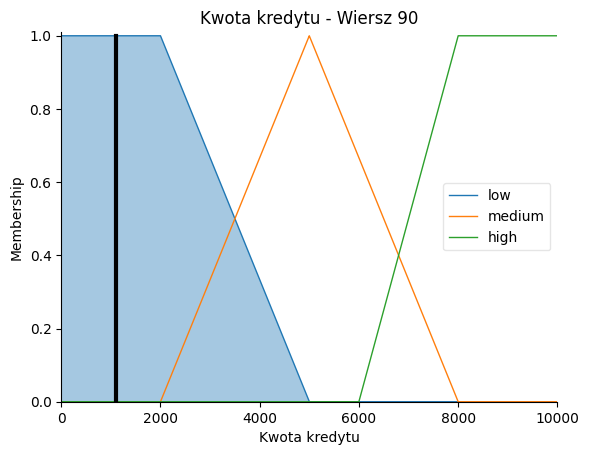

<Figure size 1000x600 with 0 Axes>

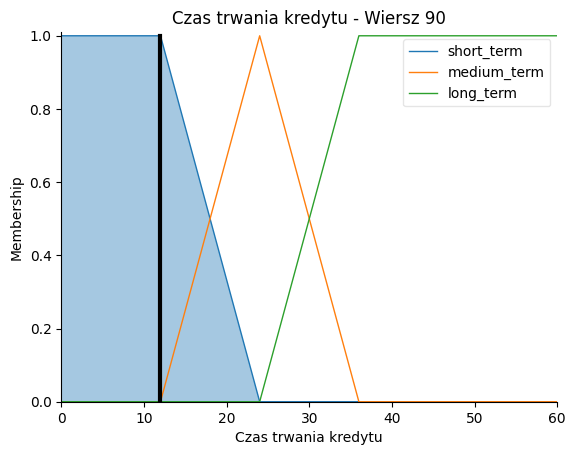

<Figure size 1000x600 with 0 Axes>

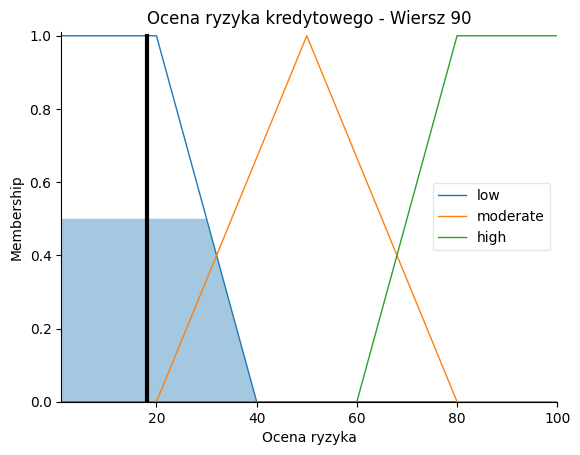

Wartości wejściowe:
Wiek: 56.0
Oszczędności: 30.0
Kwota kredytu: 618.0
Czas trwania kredytu: 12.0
Wiersz 91:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (56.0): young=0.00, middle_aged=0.76, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (618.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

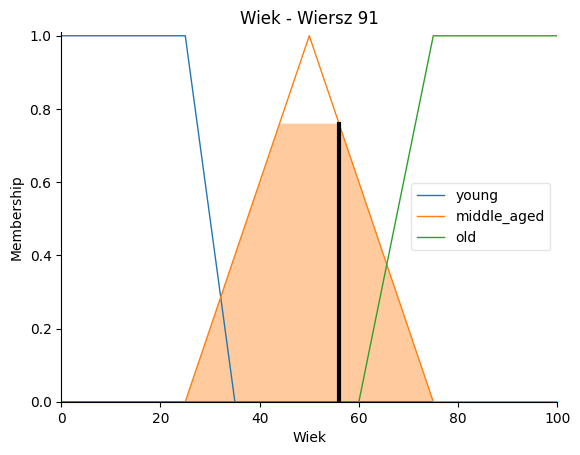

<Figure size 1000x600 with 0 Axes>

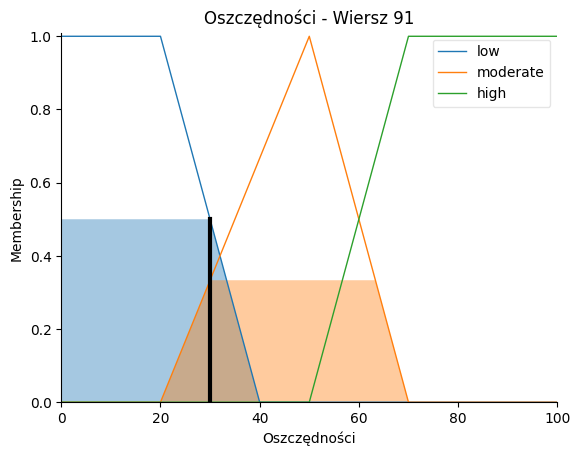

<Figure size 1000x600 with 0 Axes>

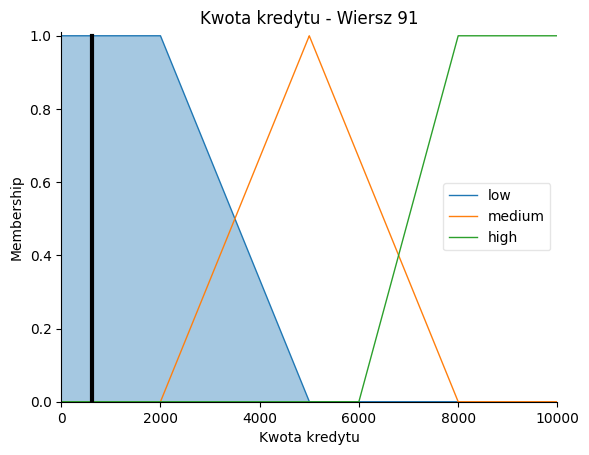

<Figure size 1000x600 with 0 Axes>

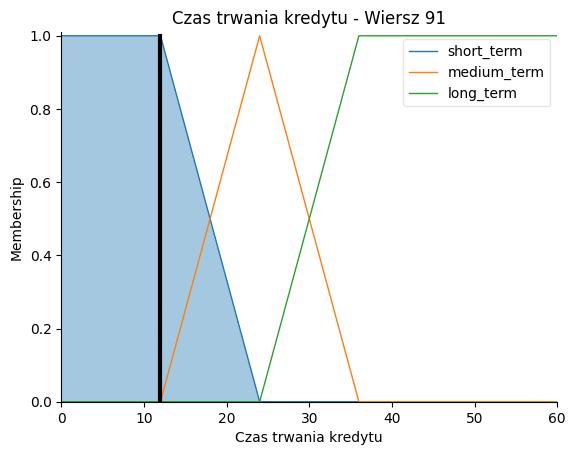

<Figure size 1000x600 with 0 Axes>

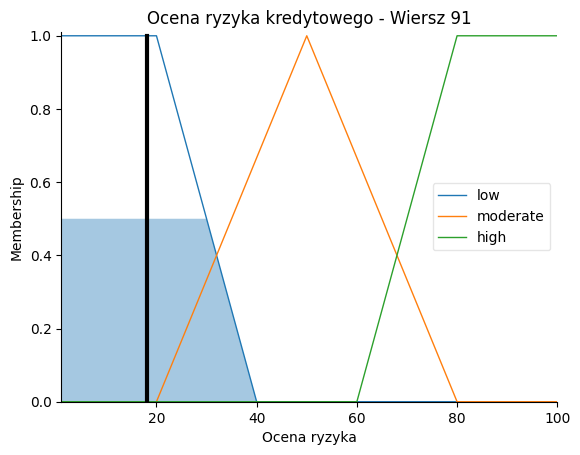

Wartości wejściowe:
Wiek: 54.0
Oszczędności: 30.0
Kwota kredytu: 1409.0
Czas trwania kredytu: 12.0
Wiersz 92:
Ocena ryzyka kredytowego = 18.12 [%]
  Przynależność (Membership):
  Wiek (54.0): young=0.00, middle_aged=0.84, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (1409.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

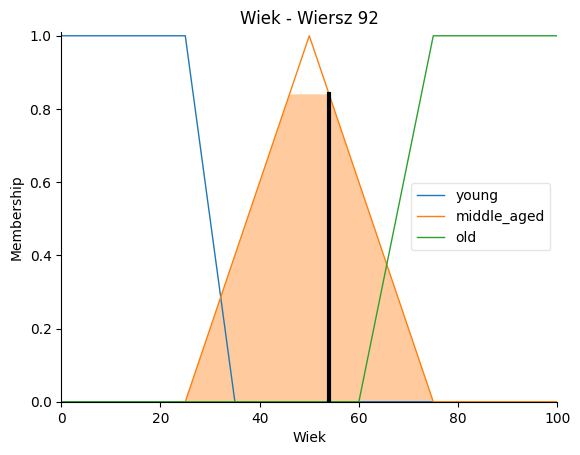

<Figure size 1000x600 with 0 Axes>

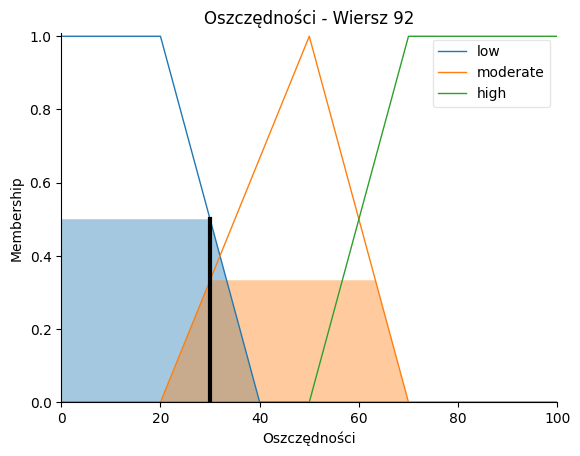

<Figure size 1000x600 with 0 Axes>

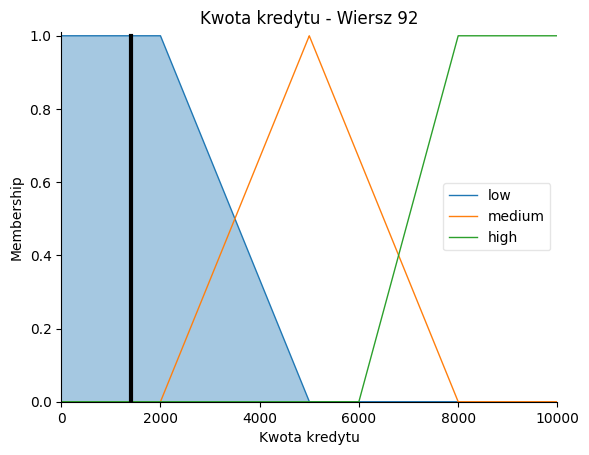

<Figure size 1000x600 with 0 Axes>

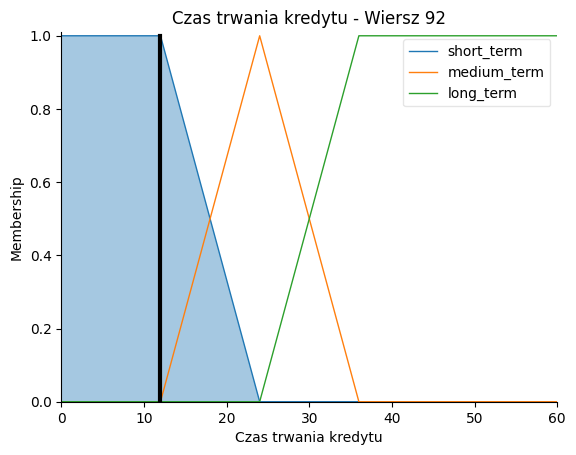

<Figure size 1000x600 with 0 Axes>

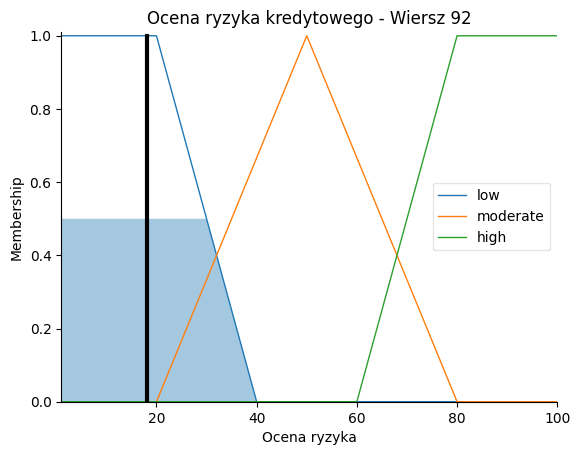

Wartości wejściowe:
Wiek: 54.0
Oszczędności: 90.0
Kwota kredytu: 1318.0
Czas trwania kredytu: 12.0
Wiersz 95:
Ocena ryzyka kredytowego = 16.68 [%]
  Przynależność (Membership):
  Wiek (54.0): young=0.00, middle_aged=0.84, old=0.00
  Oszczędności (90.0): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (1318.0): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (12.0): short=1.00, medium=0.00, long=0.00



<Figure size 1000x600 with 0 Axes>

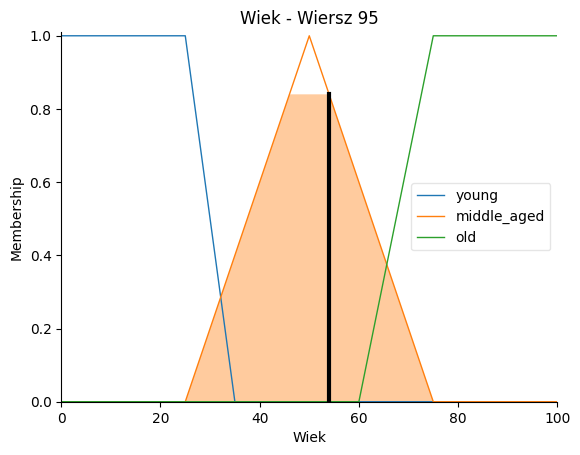

<Figure size 1000x600 with 0 Axes>

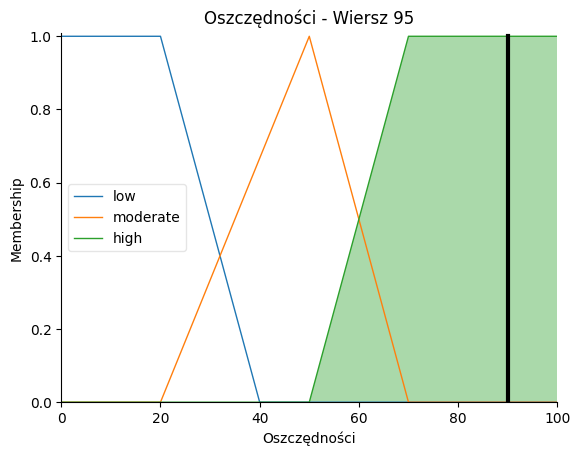

<Figure size 1000x600 with 0 Axes>

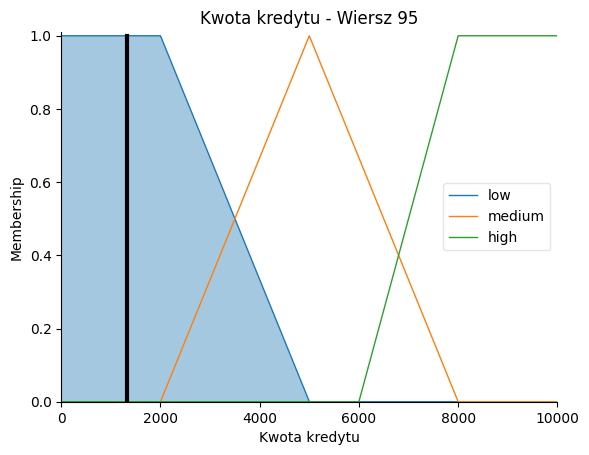

<Figure size 1000x600 with 0 Axes>

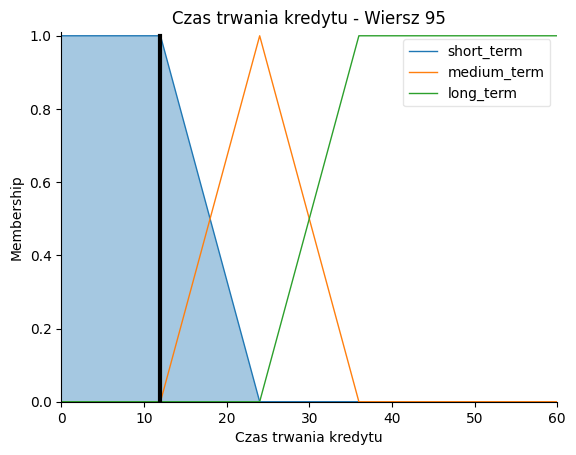

<Figure size 1000x600 with 0 Axes>

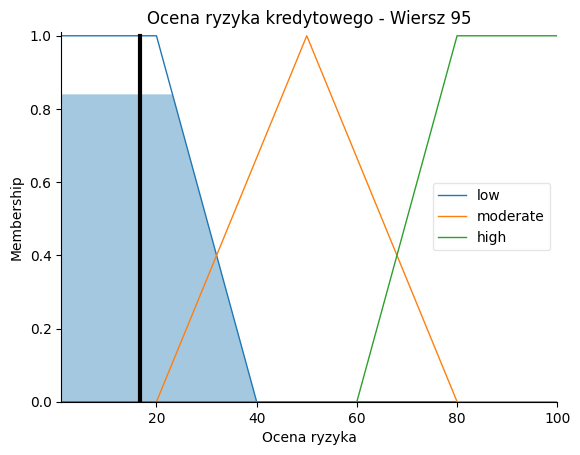

Wartości wejściowe:
Wiek: 58.0
Oszczędności: 30.0
Kwota kredytu: 15945.0
Czas trwania kredytu: 54.0
Wiersz 96:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (58.0): young=0.00, middle_aged=0.68, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (15945.0): low=0.00, medium=0.00, high=0.00
  Czas trwania kredytu (54.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

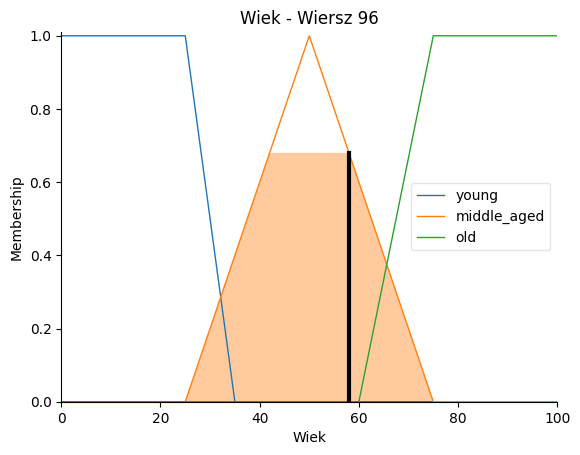

<Figure size 1000x600 with 0 Axes>

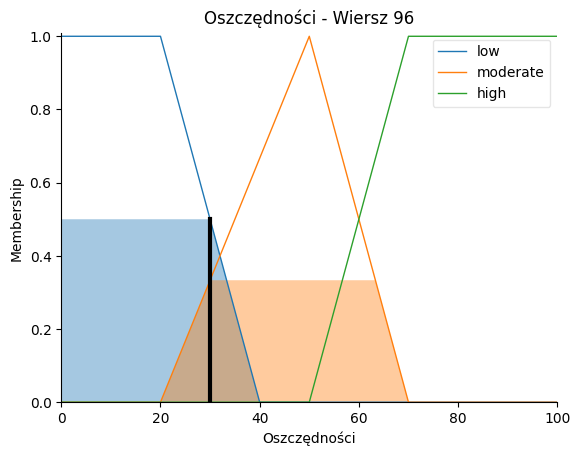

<Figure size 1000x600 with 0 Axes>

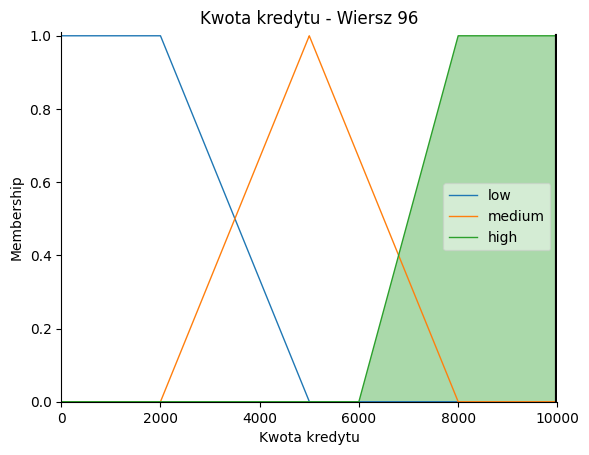

<Figure size 1000x600 with 0 Axes>

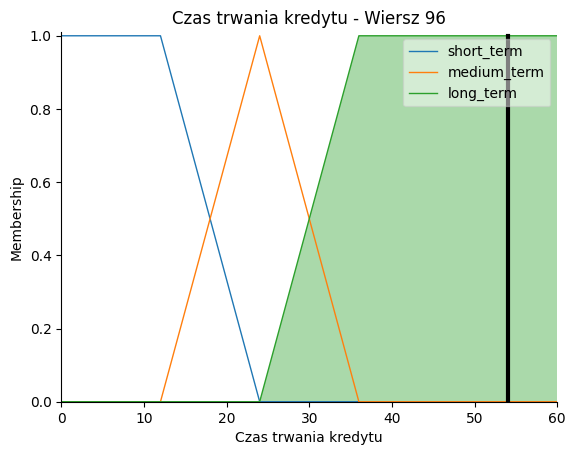

<Figure size 1000x600 with 0 Axes>

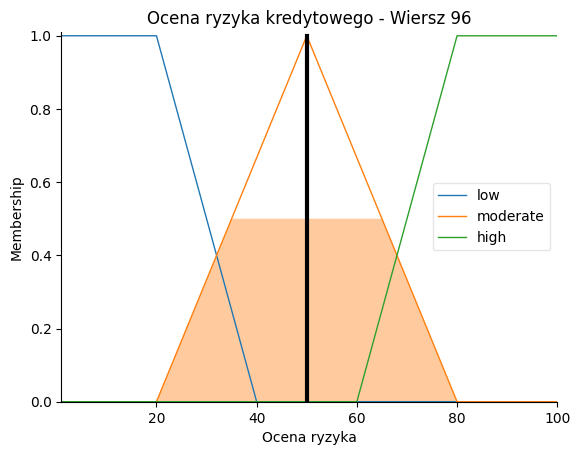

Wartości wejściowe:
Wiek: 34.0
Oszczędności: 50.0
Kwota kredytu: 2622.0
Czas trwania kredytu: 18.0
Wiersz 98:
Ocena ryzyka kredytowego = 37.87 [%]
  Przynależność (Membership):
  Wiek (34.0): young=0.10, middle_aged=0.36, old=0.00
  Oszczędności (50.0): low=0.00, moderate=1.00, high=0.00
  Kwota kredytu (2622.0): low=0.79, medium=0.21, high=0.00
  Czas trwania kredytu (18.0): short=0.50, medium=0.50, long=0.00



<Figure size 1000x600 with 0 Axes>

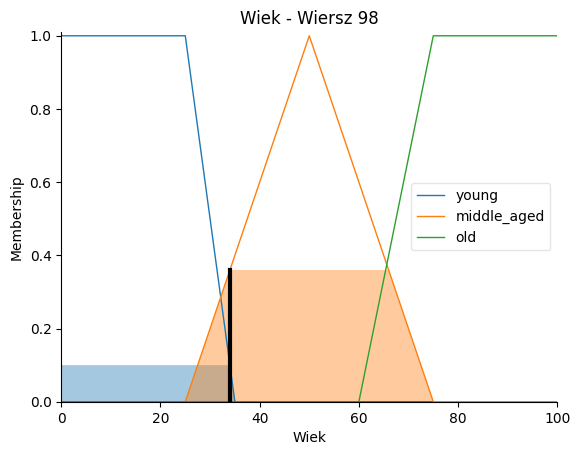

<Figure size 1000x600 with 0 Axes>

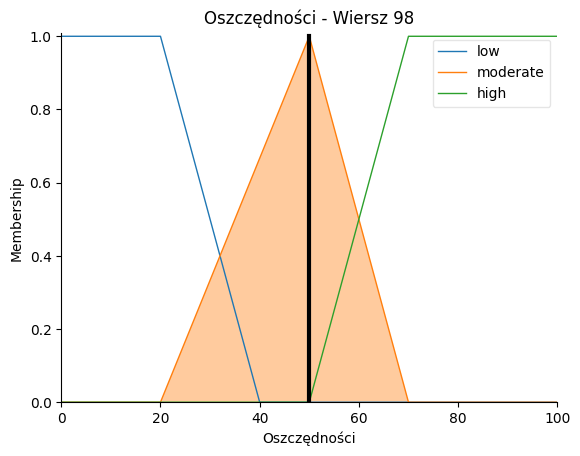

<Figure size 1000x600 with 0 Axes>

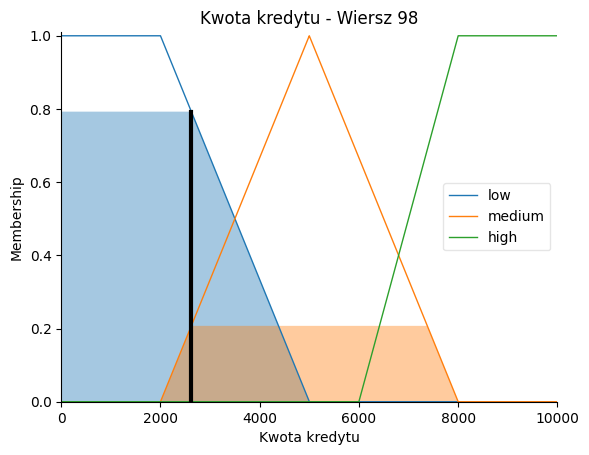

<Figure size 1000x600 with 0 Axes>

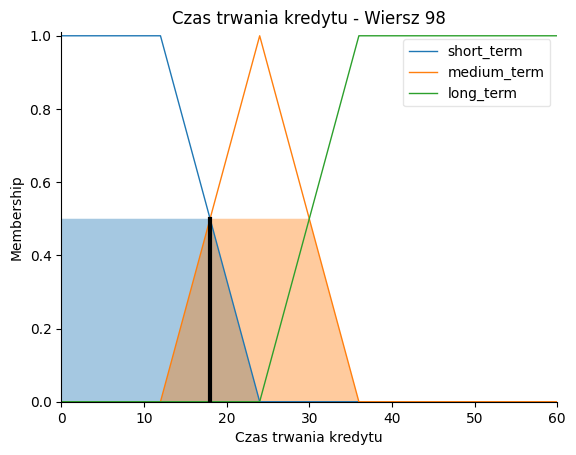

<Figure size 1000x600 with 0 Axes>

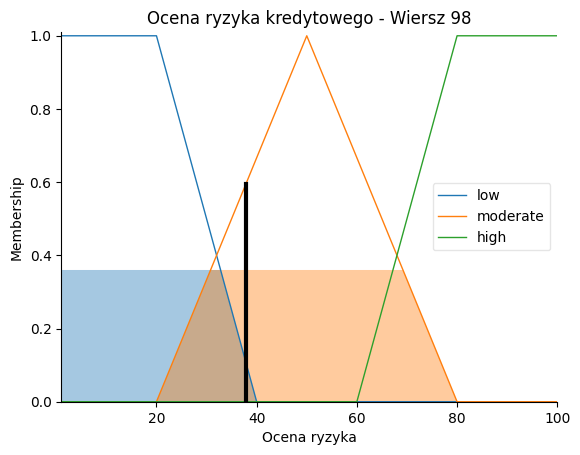

Wartości wejściowe:
Wiek: 36.0
Oszczędności: 30.0
Kwota kredytu: 2337.0
Czas trwania kredytu: 36.0
Wiersz 99:
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (36.0): young=0.00, middle_aged=0.44, old=0.00
  Oszczędności (30.0): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (2337.0): low=0.89, medium=0.11, high=0.00
  Czas trwania kredytu (36.0): short=0.00, medium=0.00, long=1.00



<Figure size 1000x600 with 0 Axes>

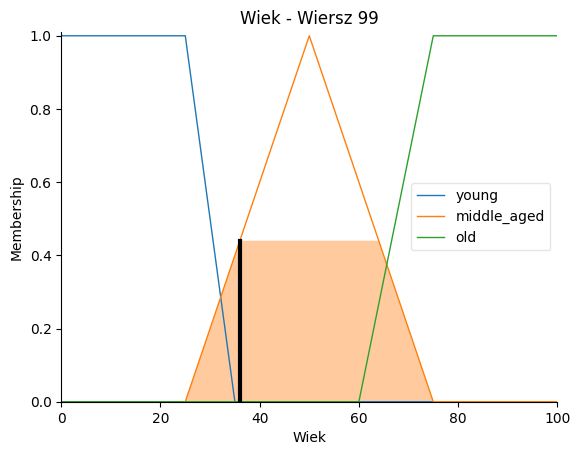

<Figure size 1000x600 with 0 Axes>

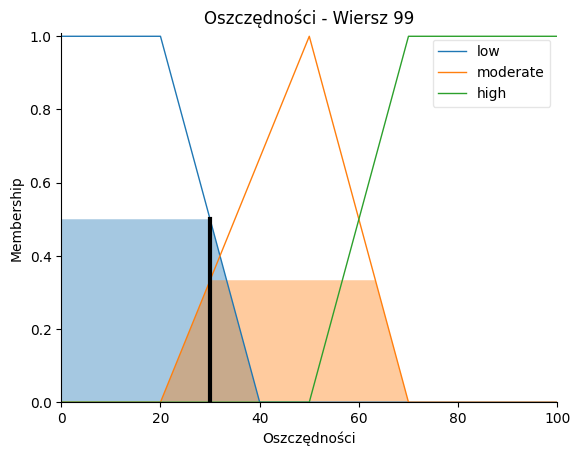

<Figure size 1000x600 with 0 Axes>

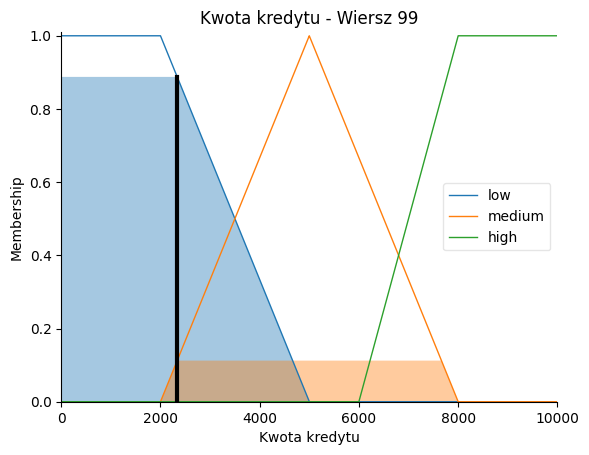

<Figure size 1000x600 with 0 Axes>

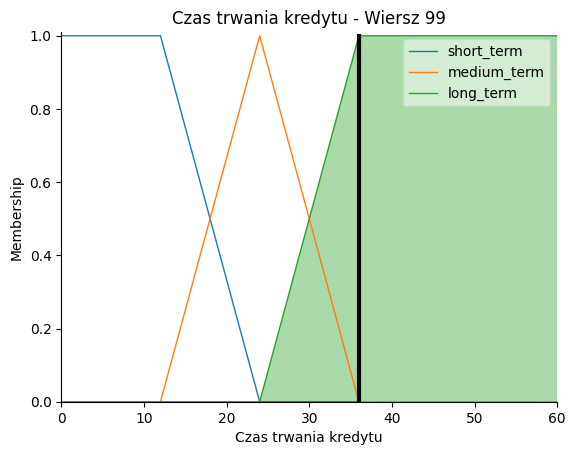

<Figure size 1000x600 with 0 Axes>

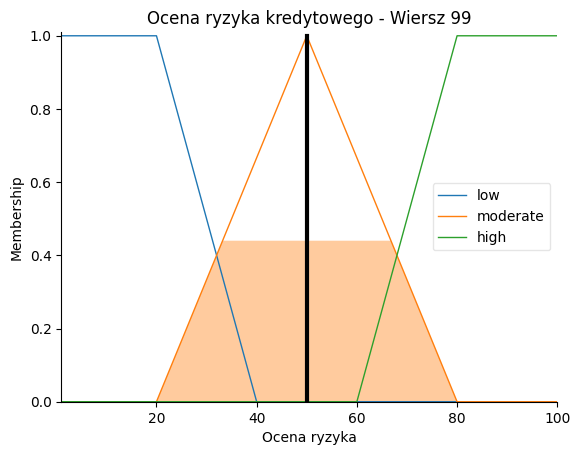

In [ ]:

for index, row in filtered_data.iterrows():
    #if index >= 100:  # Przerwanie po 100 wierszach
      #  break
    input_value_age = row['Age']
    input_value_savings = row['Saving accounts']
    input_value_credit_amount = row['Credit amount']
    input_value_duration = row['Duration']

    credit_risk_simulation.input['Wiek'] = input_value_age
    credit_risk_simulation.input['Oszczędności'] = input_value_savings
    credit_risk_simulation.input['Kwota kredytu'] = input_value_credit_amount
    credit_risk_simulation.input['Czas trwania kredytu'] = input_value_duration
    print("Wartości wejściowe:")
    print(f"Wiek: {input_value_age}")
    print(f"Oszczędności: {input_value_savings}")
    print(f"Kwota kredytu: {input_value_credit_amount}")
    print(f"Czas trwania kredytu: {input_value_duration}")

    credit_risk_simulation.compute()

    print(f"Wiersz {index + 1}:")
    risk_score = credit_risk_simulation.output['Ocena ryzyka']
    print(f"Ocena ryzyka kredytowego = {risk_score:.2f} [%]")

    age_young_value = fuzz.interp_membership(age.universe, age['young'].mf, input_value_age)
    age_middle_aged_value = fuzz.interp_membership(age.universe, age['middle_aged'].mf, input_value_age)
    age_old_value = fuzz.interp_membership(age.universe, age['old'].mf, input_value_age)

    savings_low_value = fuzz.interp_membership(savings.universe, savings['low'].mf, input_value_savings)
    savings_moderate_value = fuzz.interp_membership(savings.universe, savings['moderate'].mf, input_value_savings)
    savings_high_value = fuzz.interp_membership(savings.universe, savings['high'].mf, input_value_savings)

    credit_amount_low_value = fuzz.interp_membership(credit_amount.universe, credit_amount['low'].mf, input_value_credit_amount)
    credit_amount_medium_value = fuzz.interp_membership(credit_amount.universe, credit_amount['medium'].mf, input_value_credit_amount)
    credit_amount_high_value = fuzz.interp_membership(credit_amount.universe, credit_amount['high'].mf, input_value_credit_amount)

    duration_short_value = fuzz.interp_membership(duration.universe, duration['short_term'].mf, input_value_duration)
    duration_medium_value = fuzz.interp_membership(duration.universe, duration['medium_term'].mf, input_value_duration)
    duration_long_value = fuzz.interp_membership(duration.universe, duration['long_term'].mf, input_value_duration)

    print(f"  Przynależność (Membership):")
    print(f"  Wiek ({input_value_age}): young={age_young_value:.2f}, middle_aged={age_middle_aged_value:.2f}, old={age_old_value:.2f}")
    print(f"  Oszczędności ({input_value_savings}): low={savings_low_value:.2f}, moderate={savings_moderate_value:.2f}, high={savings_high_value:.2f}")
    print(f"  Kwota kredytu ({input_value_credit_amount}): low={credit_amount_low_value:.2f}, medium={credit_amount_medium_value:.2f}, high={credit_amount_high_value:.2f}")
    print(f"  Czas trwania kredytu ({input_value_duration}): short={duration_short_value:.2f}, medium={duration_medium_value:.2f}, long={duration_long_value:.2f}")
    print("")

    plt.figure(figsize=(10, 6))
    age.view(sim=credit_risk_simulation)
    plt.title(f"Wiek - Wiersz {index + 1}")
    plt.show()

    plt.figure(figsize=(10, 6))
    savings.view(sim=credit_risk_simulation)
    plt.title(f"Oszczędności - Wiersz {index + 1}")
    plt.show()

    plt.figure(figsize=(10, 6))
    credit_amount.view(sim=credit_risk_simulation)
    plt.title(f"Kwota kredytu - Wiersz {index + 1}")
    plt.show()

    plt.figure(figsize=(10, 6))
    duration.view(sim=credit_risk_simulation)
    plt.title(f"Czas trwania kredytu - Wiersz {index + 1}")
    plt.show()

    plt.figure(figsize=(10, 6))
    risk.view(sim=credit_risk_simulation)
    plt.title(f"Ocena ryzyka kredytowego - Wiersz {index + 1}")
    plt.show()




In [ ]:
def analyze_credit_risk(value_age, value_savings, value_credit_amount, value_duration):
    credit_risk_simulation.input['Wiek'] = value_age
    credit_risk_simulation.input['Oszczędności'] = value_savings
    credit_risk_simulation.input['Kwota kredytu'] = value_credit_amount
    credit_risk_simulation.input['Czas trwania kredytu'] = value_duration

    credit_risk_simulation.compute()

    print(f'Wiek: {value_age}, Oszczędności: {value_savings}, Kwota kredytu: {value_credit_amount}, Czas trwania kredytu: {value_duration}')
    risk_score = credit_risk_simulation.output['Ocena ryzyka']
    print(f'Ocena ryzyka kredytowego = {risk_score:.2f} [%]')

    age_young_value = fuzz.interp_membership(age.universe, age['young'].mf, value_age)
    age_middle_aged_value = fuzz.interp_membership(age.universe, age['middle_aged'].mf, value_age)
    age_old_value = fuzz.interp_membership(age.universe, age['old'].mf, value_age)

    savings_low_value = fuzz.interp_membership(savings.universe, savings['low'].mf, value_savings)
    savings_moderate_value = fuzz.interp_membership(savings.universe, savings['moderate'].mf, value_savings)
    savings_high_value = fuzz.interp_membership(savings.universe, savings['high'].mf, value_savings)

    credit_low_value = fuzz.interp_membership(credit_amount.universe, credit_amount['low'].mf, value_credit_amount)
    credit_medium_value = fuzz.interp_membership(credit_amount.universe, credit_amount['medium'].mf, value_credit_amount)
    credit_high_value = fuzz.interp_membership(credit_amount.universe, credit_amount['high'].mf, value_credit_amount)

    duration_short_value = fuzz.interp_membership(duration.universe, duration['short_term'].mf, value_duration)
    duration_medium_value = fuzz.interp_membership(duration.universe, duration['medium_term'].mf, value_duration)
    duration_long_value = fuzz.interp_membership(duration.universe, duration['long_term'].mf, value_duration)

    print('  Przynależność (Membership):')
    print(f'  Wiek ({value_age}): young={age_young_value:.2f}, middle_aged={age_middle_aged_value:.2f}, old={age_old_value:.2f}')
    print(f'  Oszczędności ({value_savings}): low={savings_low_value:.2f}, moderate={savings_moderate_value:.2f}, high={savings_high_value:.2f}')
    print(f'  Kwota kredytu ({value_credit_amount}): low={credit_low_value:.2f}, medium={credit_medium_value:.2f}, high={credit_high_value:.2f}')
    print(f'  Czas trwania kredytu ({value_duration}): short_term={duration_short_value:.2f}, medium_term={duration_medium_value:.2f}, long_term={duration_long_value:.2f}')

    plt.figure(figsize=(10, 6))
    age.view(sim=credit_risk_simulation)
    plt.title('Wiek')
    plt.show()

    plt.figure(figsize=(10, 6))
    savings.view(sim=credit_risk_simulation)
    plt.title('Oszczędności')
    plt.show()

    plt.figure(figsize=(10, 6))
    credit_amount.view(sim=credit_risk_simulation)
    plt.title('Kwota kredytu')
    plt.show()

    plt.figure(figsize=(10, 6))
    duration.view(sim=credit_risk_simulation)
    plt.title('Czas trwania kredytu')
    plt.show()

    plt.figure(figsize=(10, 6))
    risk.view(sim=credit_risk_simulation)
    plt.title('Ocena ryzyka kredytowego')
    plt.show()

    x = np.linspace(age.universe.min(), age.universe.max(), 50)
    y = np.linspace(credit_amount.universe.min(), credit_amount.universe.max(), 50)
    X, Y = np.meshgrid(x, y)
    Z = np.zeros_like(X)

    for i in range(X.shape[0]):
        for j in range(X.shape[1]):
            credit_risk_simulation.input['Wiek'] = X[i, j]
            credit_risk_simulation.input['Kwota kredytu'] = Y[i, j]
            credit_risk_simulation.input['Oszczędności'] = value_savings
            credit_risk_simulation.input['Czas trwania kredytu'] = value_duration
            credit_risk_simulation.compute()
            Z[i, j] = credit_risk_simulation.output['Ocena ryzyka']

    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(X, Y, Z, cmap='viridis', edgecolor='k')

    ax.set_xlabel('Wiek')
    ax.set_ylabel('Kwota kredytu')
    ax.set_zlabel('Ocena ryzyka kredytowego')
    ax.set_title('Wykres powierzchniowy oceny ryzyka kredytowego')
    fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5)

    plt.show()


Wiek: 22, Oszczędności: 30, Kwota kredytu: 5951, Czas trwania kredytu: 48
Ocena ryzyka kredytowego = 50.00 [%]
  Przynależność (Membership):
  Wiek (22): young=1.00, middle_aged=0.00, old=0.00
  Oszczędności (30): low=0.50, moderate=0.33, high=0.00
  Kwota kredytu (5951): low=0.00, medium=0.68, high=0.00
  Czas trwania kredytu (48): short_term=0.00, medium_term=0.00, long_term=1.00


<Figure size 1000x600 with 0 Axes>

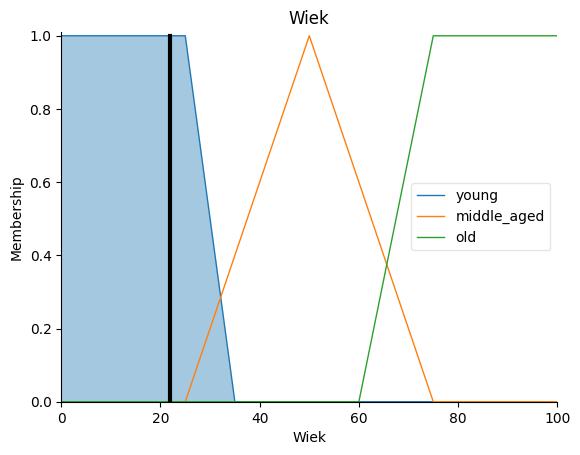

<Figure size 1000x600 with 0 Axes>

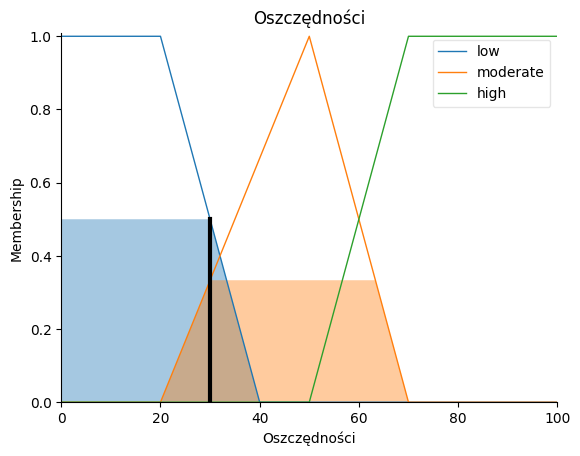

<Figure size 1000x600 with 0 Axes>

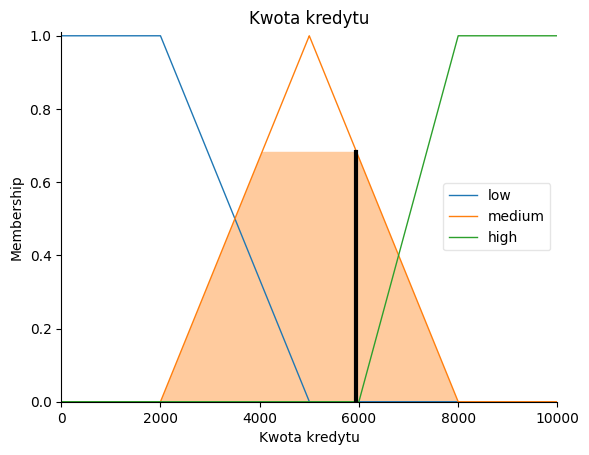

<Figure size 1000x600 with 0 Axes>

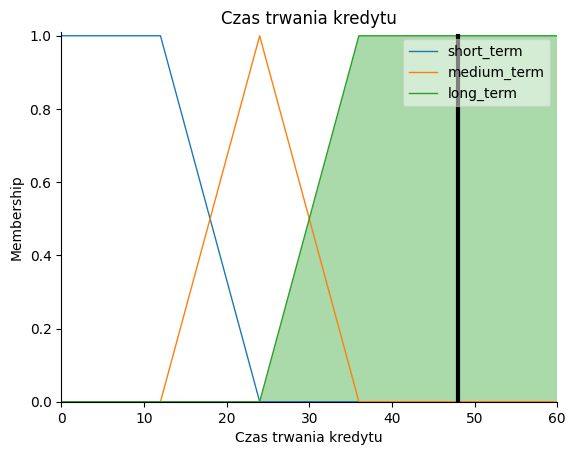

<Figure size 1000x600 with 0 Axes>

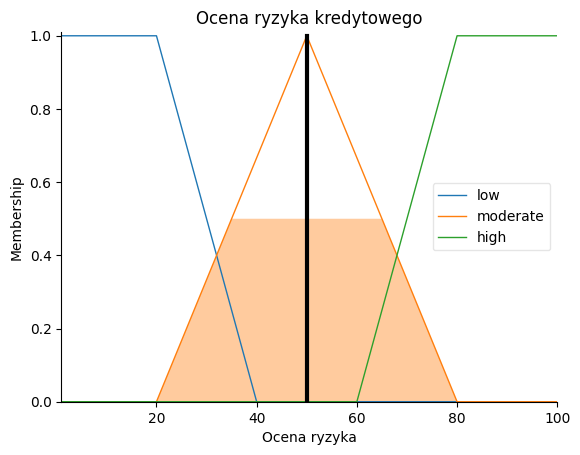

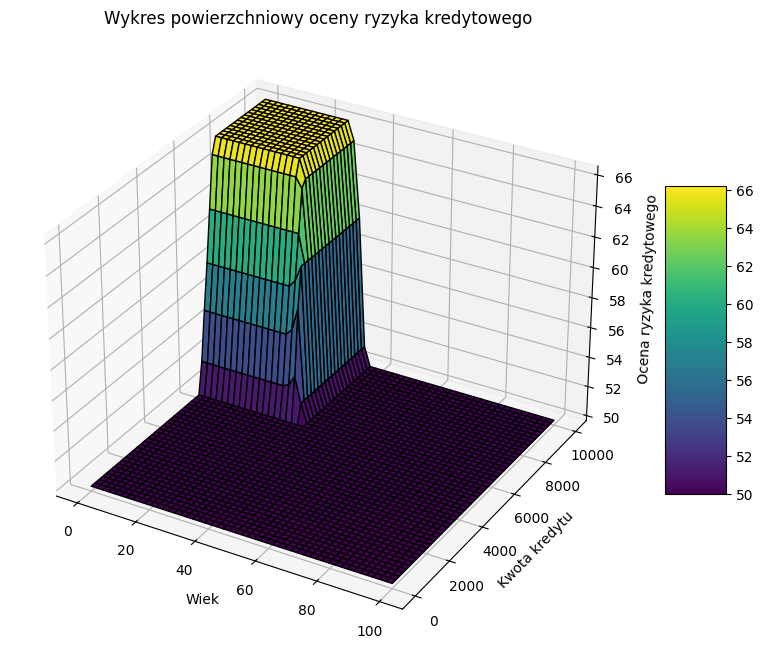

In [ ]:
analyze_credit_risk(
    value_age=22,
    value_savings=30,
    value_credit_amount=5951,
    value_duration=48
)

Wiek: 26, Oszczędności: 90, Kwota kredytu: 1158, Czas trwania kredytu: 20
Ocena ryzyka kredytowego = 41.50 [%]
  Przynależność (Membership):
  Wiek (26): young=0.90, middle_aged=0.04, old=0.00
  Oszczędności (90): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (1158): low=1.00, medium=0.00, high=0.00
  Czas trwania kredytu (20): short_term=0.33, medium_term=0.67, long_term=0.00


<Figure size 1000x600 with 0 Axes>

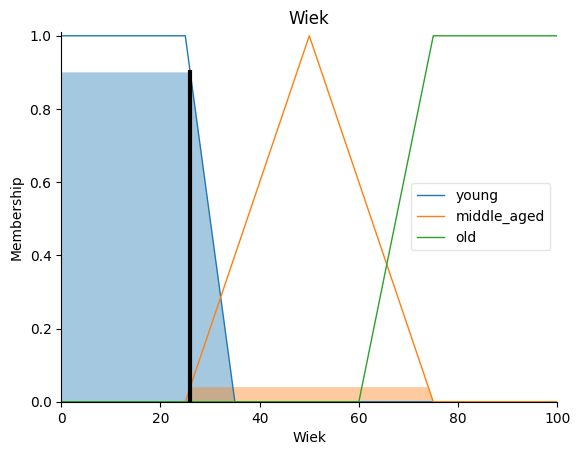

<Figure size 1000x600 with 0 Axes>

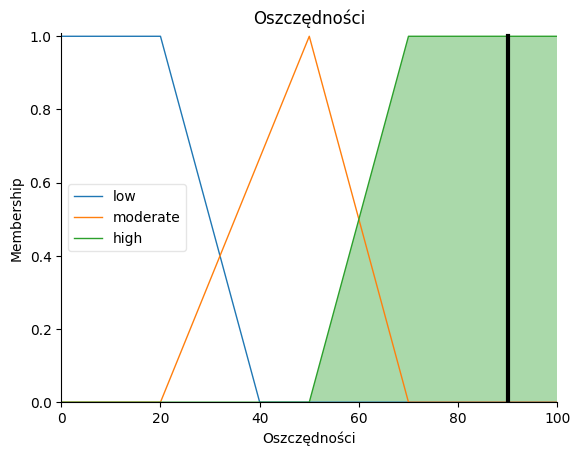

<Figure size 1000x600 with 0 Axes>

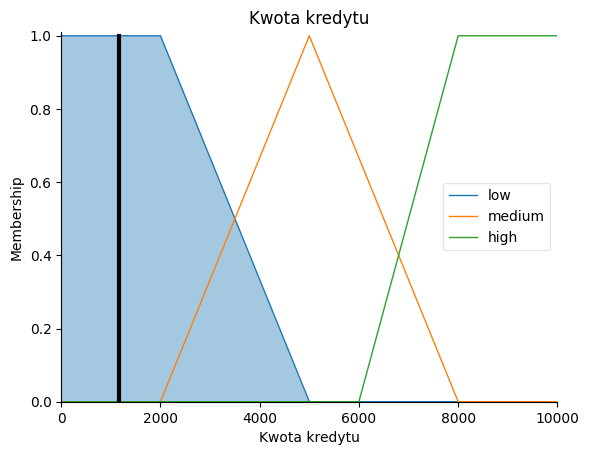

<Figure size 1000x600 with 0 Axes>

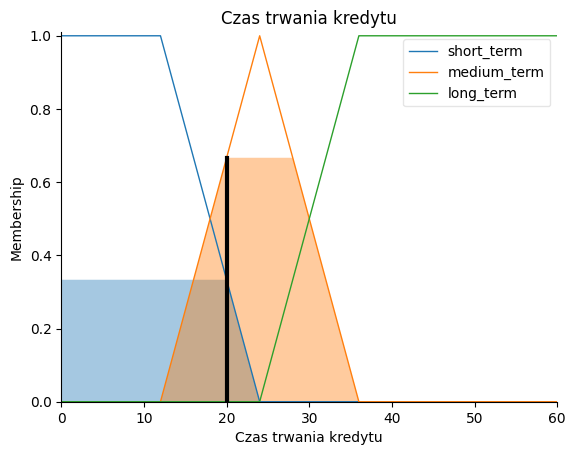

<Figure size 1000x600 with 0 Axes>

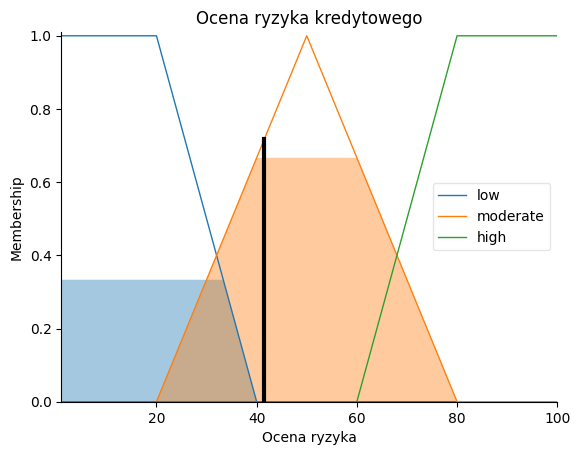

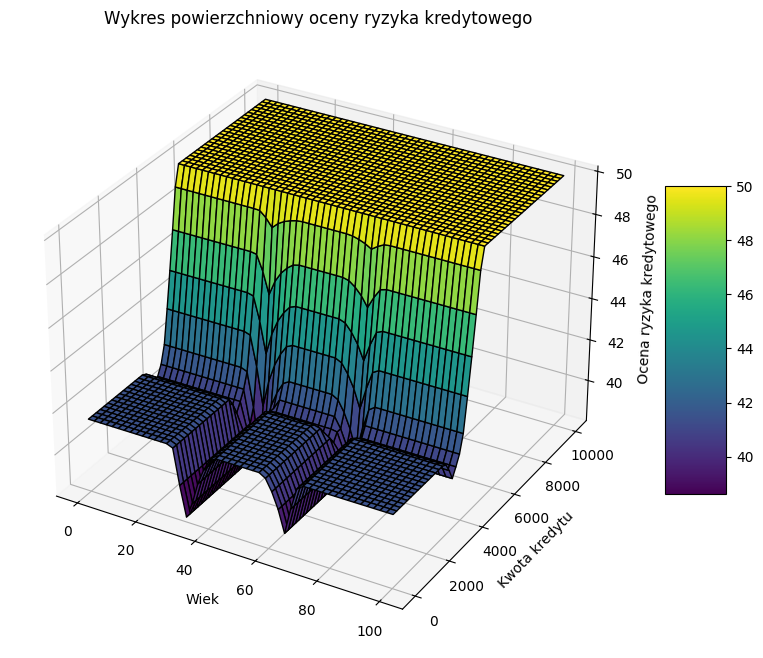

In [ ]:
analyze_credit_risk(
    value_age=26,
    value_savings=90,
    value_credit_amount=1158,
    value_duration=20
)

Wiek: 44, Oszczędności: 99, Kwota kredytu: 2647, Czas trwania kredytu: 6
Ocena ryzyka kredytowego = 27.50 [%]
  Przynależność (Membership):
  Wiek (44): young=0.00, middle_aged=0.76, old=0.00
  Oszczędności (99): low=0.00, moderate=0.00, high=1.00
  Kwota kredytu (2647): low=0.78, medium=0.22, high=0.00
  Czas trwania kredytu (6): short_term=1.00, medium_term=0.00, long_term=0.00


<Figure size 1000x600 with 0 Axes>

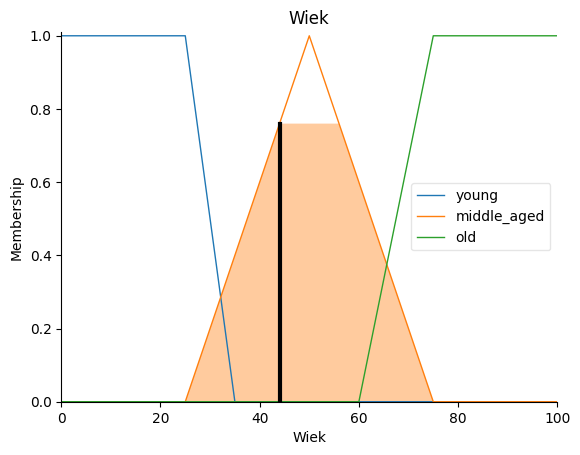

<Figure size 1000x600 with 0 Axes>

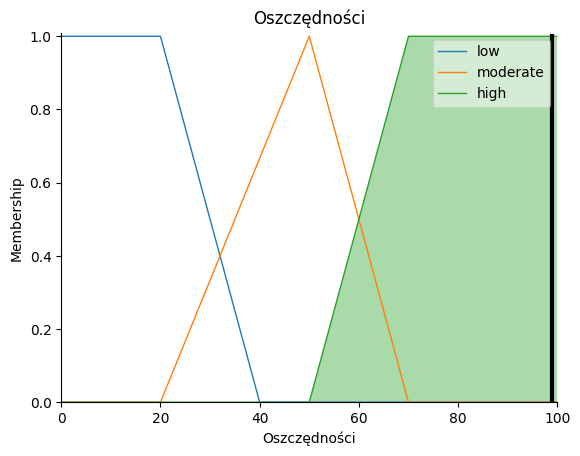

<Figure size 1000x600 with 0 Axes>

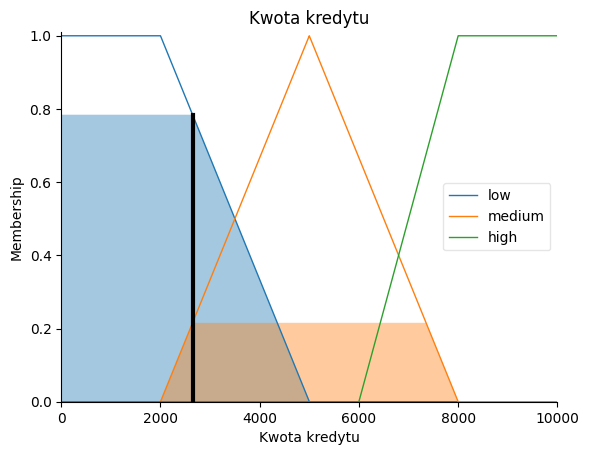

<Figure size 1000x600 with 0 Axes>

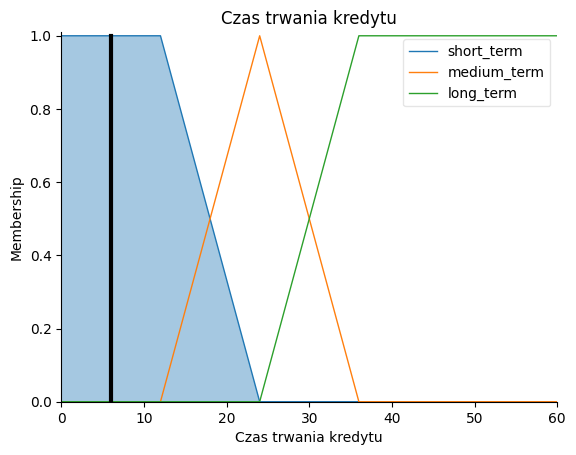

<Figure size 1000x600 with 0 Axes>

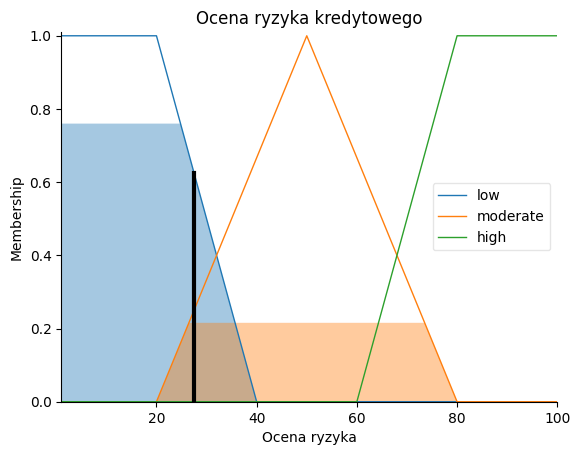

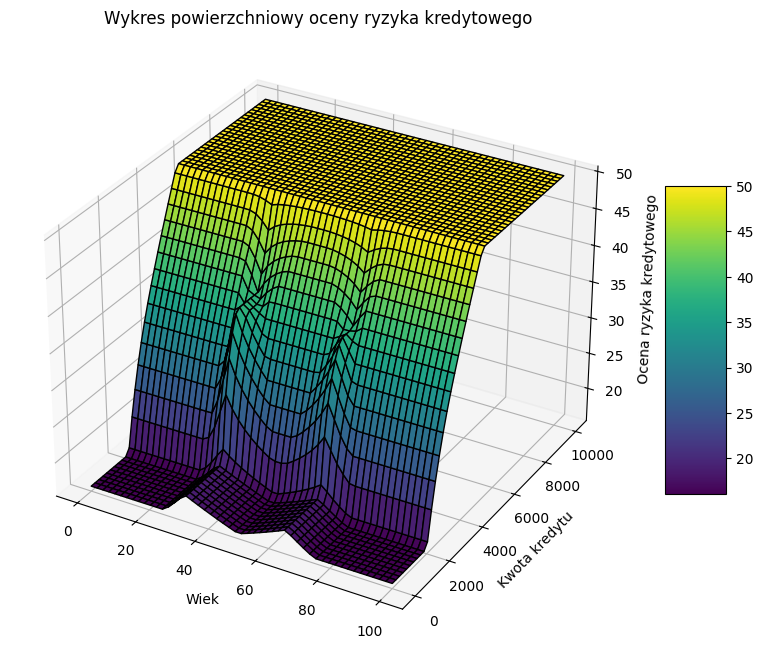

In [ ]:
analyze_credit_risk(
    value_age=44,
    value_savings=99,
    value_credit_amount=2647,
    value_duration=6
)